In [1]:
import pandas as pd  
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.optimize as sco
import os
import plotly.graph_objects as go
from itertools import combinations
from sklearn.preprocessing import StandardScaler
from pathlib import Path

scaler = StandardScaler()

desired_path="/K_medoids_cluster_analysis/Results_without_sentiment/cluster_df_cl3/"

qtfilename="_qt_result.csv"

path = Path(os.getcwd())

dir1=path.parent.parent.parent.parent

final_path=str(dir1)+desired_path

/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


## Efficient Frontier portfolio allocation technique.

In [2]:
def portfolio_annualised_performance(weights, mean_returns, cov_matrix, df_len):
    returns = np.sum(mean_returns*weights ) * df_len
    std = np.sqrt(np.dot(weights.T, np.dot(cov_matrix, weights))) * np.sqrt(df_len)
    return std, returns

def random_portfolios(num_portfolios, mean_returns, cov_matrix, risk_free_rate, stocks_len, df_len):
    results = np.zeros((3,num_portfolios))
    weights_record = []
    for i in range(num_portfolios):
        weights = np.random.random(stocks_len)
        weights /= np.sum(weights)
        weights_record.append(weights)
        portfolio_std_dev, portfolio_return_var = portfolio_annualised_performance(weights, mean_returns, cov_matrix, df_len)
        results[0,i] = portfolio_std_dev
        results[1,i] = portfolio_return_var
        results[2,i] = (portfolio_return_var - risk_free_rate) / portfolio_std_dev
        
    #max_sharpe = max(results[2])
    #for i in range(len(results[2])):
        #if results[2, i] == max_sharpe:
            #print("index {} and weights are {} max sharpe value {}".format(i, weights_record[i], max_sharpe))
            
    return results, weights_record

def pos_sharpe_ratio(weights, mean_returns, cov_matrix, risk_free_rate, df_len):
    p_var, p_ret = portfolio_annualised_performance(weights, mean_returns, cov_matrix, df_len)
    return (p_ret - risk_free_rate) / p_var

def neg_sharpe_ratio(weights, mean_returns, cov_matrix, risk_free_rate, df_len):
    p_var, p_ret = portfolio_annualised_performance(weights, mean_returns, cov_matrix, df_len)
    return -(p_ret - risk_free_rate) / p_var

def max_sharpe_ratio(mean_returns, cov_matrix, risk_free_rate, df_len):
    num_assets = len(mean_returns)
    args = (mean_returns, cov_matrix, risk_free_rate, df_len)
    constraints = ({'type': 'eq', 'fun': lambda x: np.sum(x) - 1})
    bound = (0.0,1.0)
    bounds = tuple(bound for asset in range(num_assets))
    result = sco.minimize(neg_sharpe_ratio, num_assets*[1./num_assets,], args=args,
                        method='SLSQP', bounds=bounds, constraints=constraints)
    return result

def portfolio_volatility(weights, mean_returns, cov_matrix, df_len): 
    return portfolio_annualised_performance(weights, mean_returns, cov_matrix, df_len)[0]

def min_variance(mean_returns, cov_matrix, df_len):
    num_assets = len(mean_returns)
    args = (mean_returns, cov_matrix, df_len)
    constraints = ({'type': 'eq', 'fun': lambda x: np.sum(x) - 1})
    bound = (0.0,1.0)
    bounds = tuple(bound for asset in range(num_assets))

    result = sco.minimize(portfolio_volatility, num_assets*[1./num_assets,], args=args,
                        method='SLSQP', bounds=bounds, constraints=constraints)

    return result

def efficient_return(mean_returns, cov_matrix, target, df_len):
    num_assets = len(mean_returns)
    args = (mean_returns, cov_matrix, df_len)
    
    def portfolio_return(weights, df_len):
        return portfolio_annualised_performance(weights, mean_returns, cov_matrix, df_len)[1]

    constraints = ({'type': 'eq', 'fun': lambda x: portfolio_return(x, df_len) - target},
                   {'type': 'eq', 'fun': lambda x: np.sum(x) - 1})
    bounds = tuple((0,1) for asset in range(num_assets))
    result = sco.minimize(portfolio_volatility, num_assets*[1./num_assets,], args=args, method='SLSQP', bounds=bounds, constraints=constraints)
    return result


def efficient_frontier(mean_returns, cov_matrix, returns_range, df_len):
    efficients = []
    for ret in returns_range:
        efficients.append(efficient_return(mean_returns, cov_matrix, ret, df_len))
    return efficients


def display_calculated_ef_with_random(mean_returns, cov_matrix, num_portfolios, risk_free_rate, table, stocks_len, df_len):
    results, _ = random_portfolios(num_portfolios,mean_returns, cov_matrix, risk_free_rate, stocks_len, df_len)
    #print("results == \n", max(results[2]))
    max_sharpe = max_sharpe_ratio(mean_returns, cov_matrix, risk_free_rate, df_len) 
    pos_sharpe = pos_sharpe_ratio(max_sharpe['x'], mean_returns, cov_matrix, risk_free_rate, df_len)
    #print("pos_sharpe == \n", pos_sharpe)
    
    sdp, rp = portfolio_annualised_performance(max_sharpe['x'], mean_returns, cov_matrix, df_len)
    max_sharpe_allocation = pd.DataFrame(max_sharpe.x,index=table.columns,columns=['allocation'])
    max_sharpe_allocation.allocation = [round(i*100,2)for i in max_sharpe_allocation.allocation]
    max_sharpe_allocation = max_sharpe_allocation.T
    max_sharpe_allocation

    min_vol = min_variance(mean_returns, cov_matrix, df_len)
    sdp_min, rp_min = portfolio_annualised_performance(min_vol['x'], mean_returns, cov_matrix, df_len)
    min_vol_allocation = pd.DataFrame(min_vol.x,index=table.columns,columns=['allocation'])
    min_vol_allocation.allocation = [round(i*100,2)for i in min_vol_allocation.allocation]
    min_vol_allocation = min_vol_allocation.T
    
    print("-"*80)
    print( "Maximum Sharpe Ratio Portfolio Allocation\n")
    print( "Annualised Return:", round(rp,2))
    print( "Annualised Volatility:", round(sdp,2))
    print ("\n")
    print (max_sharpe_allocation)
    print( "-"*80)
    print ("Minimum Volatility Portfolio Allocation\n")
    print( "Annualised Return:", round(rp_min,2))
    print( "Annualised Volatility:", round(sdp_min,2))
    print ("\n")
    print (min_vol_allocation)
    
    plt.figure(figsize=(10, 7))
    plt.scatter(results[0,:],results[1,:],c=results[2,:],cmap='YlGnBu', marker='o', s=10, alpha=0.3)
    plt.colorbar()
    plt.scatter(sdp,rp,marker='*',color='r',s=500, label='Maximum Sharpe ratio')
    plt.scatter(sdp_min,rp_min,marker='*',color='g',s=500, label='Minimum volatility')

    target = np.linspace(rp_min, 0.32, 50)
    efficient_portfolios = efficient_frontier(mean_returns, cov_matrix, target, df_len)
    plt.plot([p['fun'] for p in efficient_portfolios], target, linestyle='-.', color='black', label='efficient frontier')
    plt.title('Calculated Portfolio Optimization based on Efficient Frontier')
    plt.xlabel('annualised volatility')
    plt.ylabel('annualised returns')
    plt.legend(labelspacing=0.8)
    plt.show()
    return (pos_sharpe, round(rp,2), round(sdp,2), max_sharpe_allocation.values)


def display_ef_with_selected(mean_returns, cov_matrix, risk_free_rate,table, df_len):
    returns = table.pct_change()
    max_sharpe = max_sharpe_ratio(mean_returns, cov_matrix, risk_free_rate, df_len)
    #print("Max Sharpe ==\n", max_sharpe)
    sdp, rp = portfolio_annualised_performance(max_sharpe['x'], mean_returns, cov_matrix, df_len)
    max_sharpe_allocation = pd.DataFrame(max_sharpe.x,index=table.columns,columns=['allocation'])
    max_sharpe_allocation.allocation = [round(i*100,2)for i in max_sharpe_allocation.allocation]
    max_sharpe_allocation = max_sharpe_allocation.T
    max_sharpe_allocation
    

    min_vol = min_variance(mean_returns, cov_matrix, df_len)
    sdp_min, rp_min = portfolio_annualised_performance(min_vol['x'], mean_returns, cov_matrix, df_len)
    min_vol_allocation = pd.DataFrame(min_vol.x,index=table.columns,columns=['allocation'])
    min_vol_allocation.allocation = [round(i*100,2)for i in min_vol_allocation.allocation]
    min_vol_allocation = min_vol_allocation.T
    
    an_vol = np.std(returns) * np.sqrt(df_len)
    an_rt = mean_returns * df_len
    
    print ("-"*80)
    print ("Individual Stock Returns and Volatility\n")
    for i, txt in enumerate(table.columns):
        print (txt,":","annuaised return",round(an_rt[i],2),", annualised volatility:",round(an_vol[i],2))
    print ("-"*80)
    
    fig, ax = plt.subplots(figsize=(10, 7))
    ax.scatter(an_vol,an_rt,marker='o',s=200)

    for i, txt in enumerate(table.columns):
        ax.annotate(txt, (an_vol[i],an_rt[i]), xytext=(10,0), textcoords='offset points')
    ax.scatter(sdp,rp,marker='*',color='r',s=500, label='Maximum Sharpe ratio')
    ax.scatter(sdp_min,rp_min,marker='*',color='g',s=500, label='Minimum volatility')

    target = np.linspace(rp_min, 0.34, 50)
    efficient_portfolios = efficient_frontier(mean_returns, cov_matrix, target, df_len)
    ax.plot([p['fun'] for p in efficient_portfolios], target, linestyle='-.', color='black', label='efficient frontier')
    ax.set_title('Portfolio Optimization with Individual Stocks')
    ax.set_xlabel('annualised volatility')
    ax.set_ylabel('annualised returns')
    ax.legend(labelspacing=0.8)
    plt.show()

# display_calculated_ef_with_random(mean_returns, cov_matrix, num_portfolios, risk_free_rate)
# call this for different portfolios
# display_ef_with_selected(mean_returns, cov_matrix, risk_free_rate)
# call this for the companies selected for the portfolio

def efficient_frontier_stock_portfolio(stocks, stocks_len, risk_free_rate_in, start_date, end_date):
    data_temp = pd.read_csv('../../../../../Data-Acquisition/ohlcv-data/ohlcv.csv') 
    #print(data_temp)
    data_temp["time"] = pd.to_datetime(data_temp.time, format='%d/%m/%Y')
    start_date = pd.to_datetime(start_date)
    end_date = pd.to_datetime(end_date)
    data = data_temp[(data_temp["time"] >= start_date) & (data_temp["time"]< end_date)]
    #print(data)
    data["time"] = pd.to_datetime(data.time, format='%d/%m/%Y')
    data = data[['time','adjusted_close', 'symbol']]
    data = data.rename(columns={'time': 'date', 'adjusted_close': 'adj_close', 'symbol': 'ticker'})
    data = data[data['ticker'].isin(stocks)]
    #print(data)
    df_len = len(data.groupby("date"))
    #print("\nShape of the df {}, df len {}".format(df_len,data.shape))

    df = data.set_index('date')
    table = df.pivot(columns='ticker')
    # By specifying col[1] in below list comprehension
    # You can select the stock names under multi-level column
    table.columns = [col[1] for col in table.columns]
    table.head()

    plt.figure(figsize=(16, 9))
    for c in table.columns.values:
        plt.plot(table.index, table[c], lw=2, alpha=0.8,label=c)
    plt.legend(loc='upper right', fontsize=12)
    plt.ylabel('price in $')
    plt.title('Stocks Closing price in $')
    plt.show()

    returns = table.pct_change()
    plt.figure(figsize=(14, 7))
    for c in returns.columns.values:
        plt.plot(returns.index, returns[c], lw=3, alpha=0.8,label=c)
    plt.legend(loc='upper left', fontsize=12)
    plt.ylabel('daily returns')
    plt.title('Stocks Closing daily returns variation')
    plt.show()
    
    returns = table.pct_change()
    mean_returns = returns.mean()
    cov_matrix = returns.cov()
    num_portfolios = 25000
    risk_free_rate = 0.0095
    

    pos_sharpe, Annualised_Return, Annualised_Volatility, allocation_weights = display_calculated_ef_with_random(mean_returns, cov_matrix, num_portfolios, risk_free_rate, table, stocks_len, df_len)
    display_ef_with_selected(mean_returns, cov_matrix, risk_free_rate, table, df_len)
    
    return (pos_sharpe, Annualised_Return, Annualised_Volatility, allocation_weights)

In [3]:
def check_cor_cov_relation(covariance, correlation, mean_covariance, stocks):
    paired_stocks = np.zeros(covariance.shape)

    for i in range(len(stocks)):
        for j in range(len(stocks)-i):
            if(covariance[i,j] > mean_covariance[i] or covariance[i,j] > mean_covariance[j] or correlation[i][j]>0.5):
                paired_stocks[i,j] = 0
            else:
                paired_stocks[i,j] = 1

    return paired_stocks

In [4]:
def stocks_pair_lookup(stockspair, stocks_range_values, paired_stocks):
    nostockspair = []
    for i in stocks_range_values:
        if(i not in stockspair):
            nostockspair.append(i)
        else:
            continue
            
    for stock_ticker in nostockspair:
        cummulative_stockpair = len(stockspair)
        for i in stockspair:
            if(paired_stocks[stock_ticker,i]!=1 or paired_stocks[i,stock_ticker]!=1):
                cummulative_stockpair -= 1
        if(float(cummulative_stockpair)/len(stockspair) > 0.5):
            stockspair.add(stock_ticker)              
    return stockspair

In [5]:
def make_company_portfolios(stocks_combination, stocks_range, paired_stocks, portfolio_collection):  
    stockpair = set(stocks_combination)
    stockpair = stocks_pair_lookup(stockpair, stocks_range, paired_stocks)
    if stockpair not in portfolio_collection:
        portfolio_collection.append(stockpair)
    return portfolio_collection

In [6]:
def generate_portfolio_pairs(stocks):
    print(stocks)
    data = pd.read_csv('../../../../../Data-Acquisition/ohlcv-data/ohlcv.csv')  
    data["time"] = pd.to_datetime(data.time, format='%d/%m/%Y')
    data = data[['time','adjusted_close', 'symbol']]
    data = data.rename(columns={'time': 'date', 'adjusted_close': 'adj_close', 'symbol': 'ticker'})
    data = data[data['ticker'].isin(stocks)]

    df = data.set_index('date')
    table = df.pivot(columns='ticker')
    # By specifying col[1] in below list comprehension
    # You can select the stock names under multi-level column
    table.columns = [col[1] for col in table.columns]
    
    returns = table.pct_change()
    mean_returns = returns.mean()
    cov_matrix = returns.cov()
    correlation_matrix = returns.corr()
    np.round(correlation_matrix,3)
    mean_covariance = cov_matrix.mean()

    paired_stocks = check_cor_cov_relation(np.array(cov_matrix), np.array(correlation_matrix), mean_covariance, stocks)
    
    return paired_stocks

In [7]:
def get_portfolio_pairs(stocks):
    paired_stocks = generate_portfolio_pairs(stocks)
    stocks_range_values = range(len(stocks))
    count=0
    port_list = list(combinations(stocks_range_values,2))
    portfolio_collection = []
    for stocks_combination in port_list:
        count +=1
        if(paired_stocks[stocks_combination[0],stocks_combination[1]]!=1 or paired_stocks[stocks_combination[1],stocks_combination[0]]!=1):
            continue
        else:
            portfolio_collection = make_company_portfolios(stocks_combination, stocks_range_values, paired_stocks, portfolio_collection)

    company_name = []
    for i in portfolio_collection:
        company_name_list =[]
        for j in i:
            company_name_list.append(stocks[j])
        company_name.append(company_name_list)
    
        #print(company_name)
    
    return company_name

In [8]:
new_df = pd.DataFrame(columns=["symbol", "start_date", "sector"])
for i in range (1,9):
        df_read = pd.read_csv(final_path+str(i)+qtfilename)
        df_roc = df_read.groupby("label")["EMA"].max().reset_index()
        df_companies = pd.merge(left=df_roc, right=df_read, left_on='EMA', right_on='EMA').drop(["label_x"], axis=1)
        potential_comp = df_companies[["symbol", "start_date", "sector"]]
        new_df = new_df.append(potential_comp, ignore_index="true")

new_df.sort_values("start_date").to_csv("ohlcnews_stocks_subset1.csv")

In [9]:
new_df = pd.DataFrame(columns=["symbol", "start_date", "sector"])
for i in range (1,9):
        df_read = pd.read_csv(final_path+str(i)+qtfilename)
        df_roc = df_read.groupby("label")["ROC"].max().reset_index()
        df_companies = pd.merge(left=df_roc, right=df_read, left_on='ROC', right_on='ROC').drop(["label_x"], axis=1)
        potential_comp = df_companies[["symbol", "start_date", "sector"]]
        new_df = new_df.append(potential_comp, ignore_index="true")

new_df.sort_values("start_date").to_csv("ohlcnews_stocks_subset2.csv")

In [10]:
new_df = pd.DataFrame(columns=["symbol", "start_date", "sector"])
for i in range (1,9):
        df_read = pd.read_csv(final_path+str(i)+qtfilename)
        df_read = df_read[(df_read["RSI"] >= 30) | (df_read["RSI"] <= 70)]
        df_read = df_read[df_read["ROC"] > 0]
        df_roc = df_read.groupby("label")["ROC"].max().reset_index()
        df_companies = pd.merge(left=df_roc, right=df_read, left_on='ROC', right_on='ROC').drop(["label_x"], axis=1)
        potential_comp = df_companies[["symbol", "start_date", "sector"]]
        new_df = new_df.append(potential_comp, ignore_index="true")

new_df.sort_values("start_date").to_csv("ohlcnews_stocks_subset3.csv")

In [11]:
new_df = pd.DataFrame(columns=["symbol", "start_date", "sector"])
for i in range (1,9):
        df_read = pd.read_csv(final_path+str(i)+qtfilename)
        df_read = df_read[(df_read["RSI"] >= 30) | (df_read["RSI"] <= 70)]
        df_read = df_read[df_read["ROC"] > 0]
        df_roc = df_read.groupby("label")["EMA"].max().reset_index()
        #Inner join on the values to identify the stock with max EMA for the cluster.
        df_companies = pd.merge(left=df_roc, right=df_read, left_on='EMA', right_on='EMA').drop(["label_x"], axis=1)
        potential_comp = df_companies[["symbol", "start_date", "sector"]]
        new_df = new_df.append(potential_comp, ignore_index="true")

new_df.sort_values("start_date").to_csv("ohlcnews_stocks_subset4.csv")

In [12]:
new_df = pd.DataFrame(columns=["symbol", "start_date", "sector"])
for i in range (1,9):
        df_read = pd.read_csv(final_path+str(i)+qtfilename)
        df_read = df_read[(df_read["RSI"] >= 30) | (df_read["RSI"] <= 70)]
        #having a +ve ROC ensures "risk" of losing out on profit is taken into consideration.
        df_read = df_read[df_read["ROC"] > 0]
        #higher value of ATR says that the volitility is more.
        #high value of the ATR and positive ROC indicates that the stock is on increasing trend and also return can be higher.
        df_roc = df_read.groupby("label")["ATR"].max().reset_index()
        #Inner join on the values to identify the stock with max EMA for the cluster.
        df_companies = pd.merge(left=df_roc, right=df_read, left_on='ATR', right_on='ATR').drop(["label_x"], axis=1)
        potential_comp = df_companies[["symbol", "start_date", "sector"]]
        new_df = new_df.append(potential_comp, ignore_index="true")

new_df.sort_values("start_date").to_csv("ohlcnews_stocks_subset5.csv")

In [13]:
new_df = pd.DataFrame(columns=["symbol", "start_date", "sector"])
for filename in os.listdir():
    if filename.startswith("ohlcnews_stocks"):
        df_read = pd.read_csv(filename)
        #combine all the stocks taken into a dataframe and take the unique set from it to arrive 
        #at your stock portfolio.
        new_df = new_df.append(df_read, ignore_index="true")
        
portfolio_list = new_df["symbol"].unique()
print("These are the best stocks to be from among the 200 companies for the 2 year period data")
print("using the linear methods of stock portfolio creation:")
print(portfolio_list)

These are the best stocks to be from among the 200 companies for the 2 year period data
using the linear methods of stock portfolio creation:
['EQIX' 'AMZN' 'GOOGL' 'GOOG' 'AZO' 'BKNG' 'NEE' 'ESS' 'AJG' 'EFX' 'BLK'
 'BIIB' 'AAPL' 'CBS' 'AMD' 'CAG' 'MRO' 'NEM' 'BAC' 'CMCSA' 'HP' 'COTY'
 'KMI' 'EXC' 'APC' 'CPB' 'EMR' 'MLM' 'DHI' 'AOS' 'CTXS' 'ALGN' 'BA' 'ADBE']


In [14]:
quarter_list=["2018-04-01", "2018-07-01", "2018-10-01", "2019-01-01", "2019-04-01", "2019-07-01", "2019-10-01", "2020-01-01", "2020-04-01"]

for idx in range(1, len(quarter_list)):
    df_quarter_data = new_df[(new_df["start_date"] >= quarter_list[idx-1]) & (new_df["start_date"]< quarter_list[idx])]
    print("Companies listed in quarter {} which is between {} and {}".format(idx, quarter_list[idx-1], quarter_list[idx]))
    list_of_companies = df_quarter_data["symbol"].unique()
    df_read = pd.read_csv(final_path+str(idx)+qtfilename)
    df_unscaled = df_read.copy()
    df_unscaled_required = df_unscaled[["RSI", "ROC", "ADOSC", "ATR", "EMA", "Sharpe_ratio"]]
    df_read_scaled = pd.DataFrame(scaler.fit_transform(df_unscaled_required))
    df_read_scaled.columns = list(df_unscaled_required)
    df_read_scaled["symbol"] = df_unscaled["symbol"]
    rsi_list = []
    roc_list = []
    adosc_list = []
    atr_list = []
    ema_list = []
    sharpe_list = []
    avgret_list = []
    wt_senti_list = []
    for comp in list_of_companies:
        df_comp = df_read_scaled[df_read_scaled["symbol"] == comp]
        rsi_list.append(df_comp["RSI"].values[0])
        roc_list.append(df_comp["ROC"].values[0])
        adosc_list.append(df_comp["ADOSC"].values[0])
        atr_list.append(df_comp["ATR"].values[0])
        ema_list.append(df_comp["EMA"].values[0])
        sharpe_list.append(df_comp["Sharpe_ratio"].values[0])
    
    fig = go.Figure(data=[
        go.Bar(name='RSI', x=list_of_companies, y=rsi_list),
        go.Bar(name='ROC', x=list_of_companies, y=roc_list),
        go.Bar(name='ADOSC', x=list_of_companies, y=adosc_list),
        go.Bar(name='ATR', x=list_of_companies, y=atr_list),
        go.Bar(name='EMA', x=list_of_companies, y=ema_list),
        go.Bar(name='Sharpe_ratio', x=list_of_companies, y=sharpe_list)
    ])
    fig.update_layout(
    barmode='group',
    title="Feature distribution for the comapnies selected in the quarter",
    xaxis_title="Company names",
    yaxis_title="Scaled values of the features",
    font=dict(
        family="Courier New, monospace",
        size=12,
        color="#7f7f7f"
    ))
        
    fig.show()

Companies listed in quarter 1 which is between 2018-04-01 and 2018-07-01


Companies listed in quarter 2 which is between 2018-07-01 and 2018-10-01


Companies listed in quarter 3 which is between 2018-10-01 and 2019-01-01


Companies listed in quarter 4 which is between 2019-01-01 and 2019-04-01


Companies listed in quarter 5 which is between 2019-04-01 and 2019-07-01


Companies listed in quarter 6 which is between 2019-07-01 and 2019-10-01


Companies listed in quarter 7 which is between 2019-10-01 and 2020-01-01


Companies listed in quarter 8 which is between 2020-01-01 and 2020-04-01


Companies listed in quarter 1 which is between 2018-04-01 and 2018-07-01
['EQIX' 'AMZN' 'CBS' 'AMD' 'CAG' 'BKNG' 'BLK']
perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'CAG']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



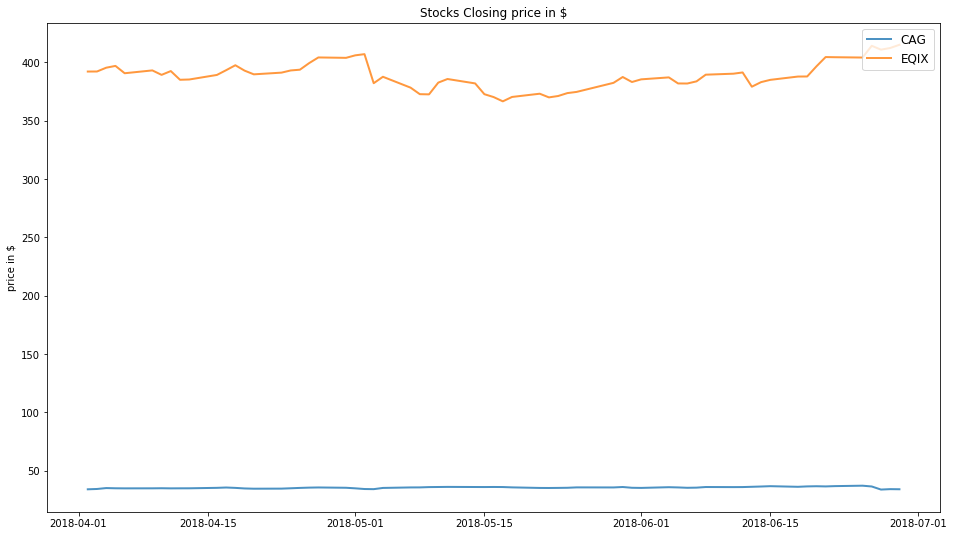

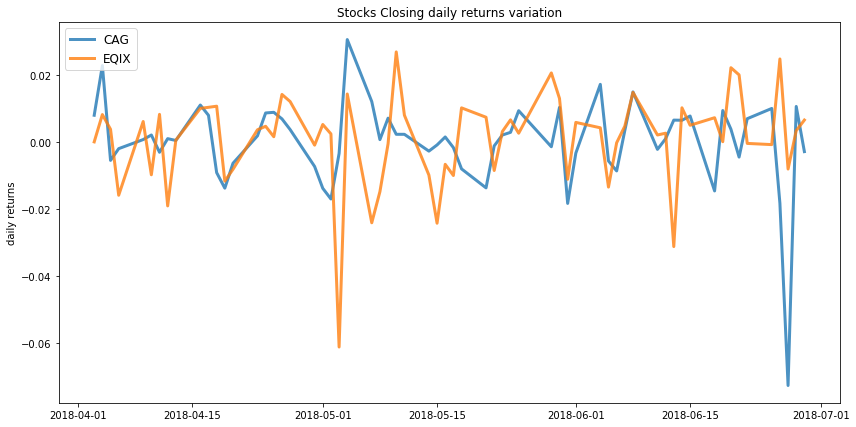

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.06
Annualised Volatility: 0.11


            CAG   EQIX
allocation  0.0  100.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.03
Annualised Volatility: 0.08


              CAG   EQIX
allocation  53.86  46.14


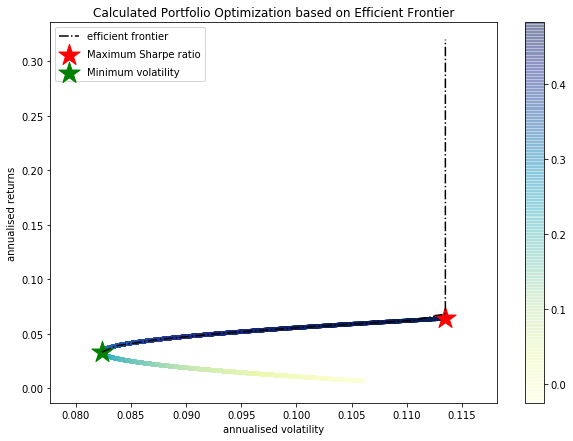

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

CAG : annuaised return 0.01 , annualised volatility: 0.11
EQIX : annuaised return 0.06 , annualised volatility: 0.11
--------------------------------------------------------------------------------


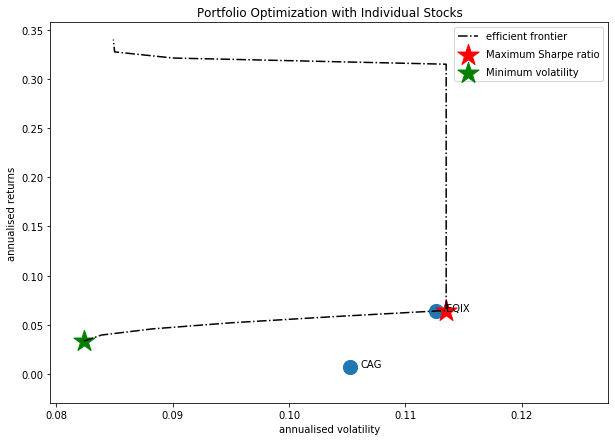

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AMZN', 'CAG']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



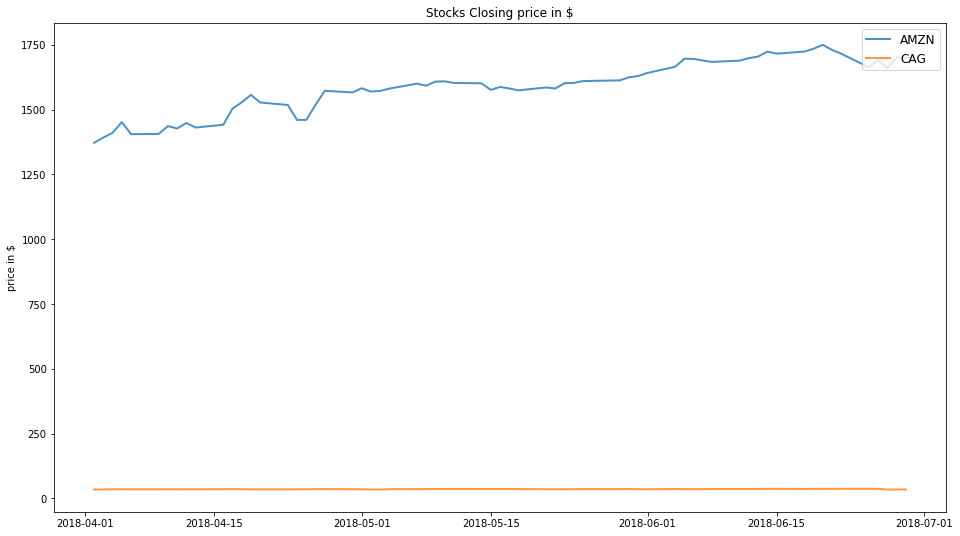

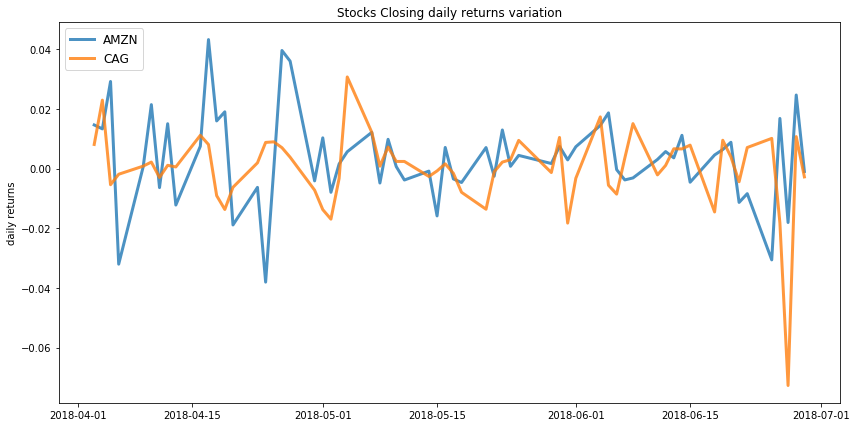

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.23
Annualised Volatility: 0.12


             AMZN  CAG
allocation  100.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.1
Annualised Volatility: 0.09


             AMZN    CAG
allocation  42.27  57.73


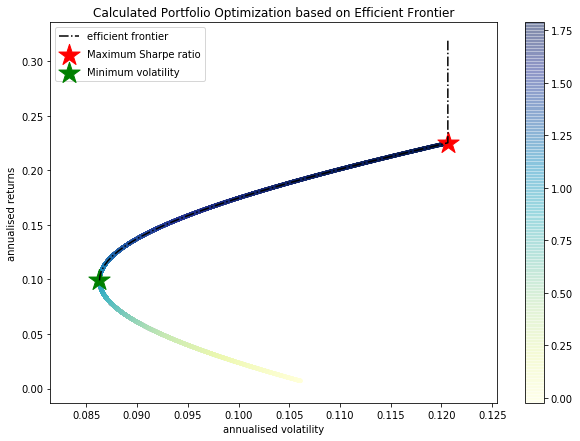

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMZN : annuaised return 0.23 , annualised volatility: 0.12
CAG : annuaised return 0.01 , annualised volatility: 0.11
--------------------------------------------------------------------------------


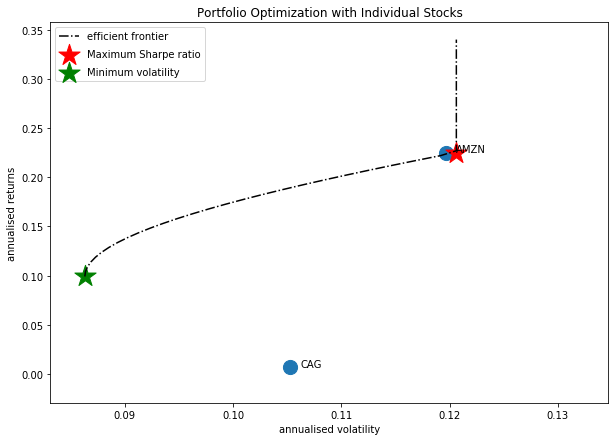

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AMZN', 'BKNG']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



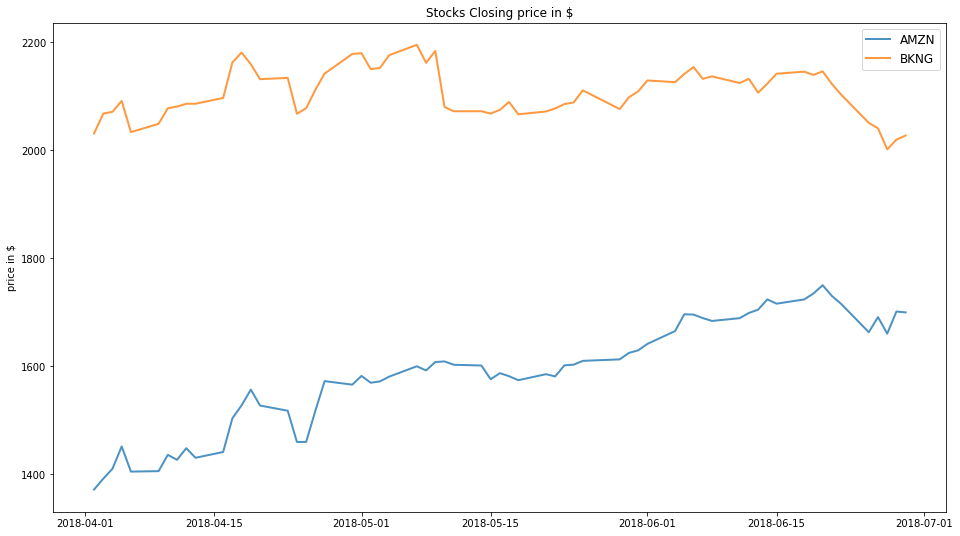

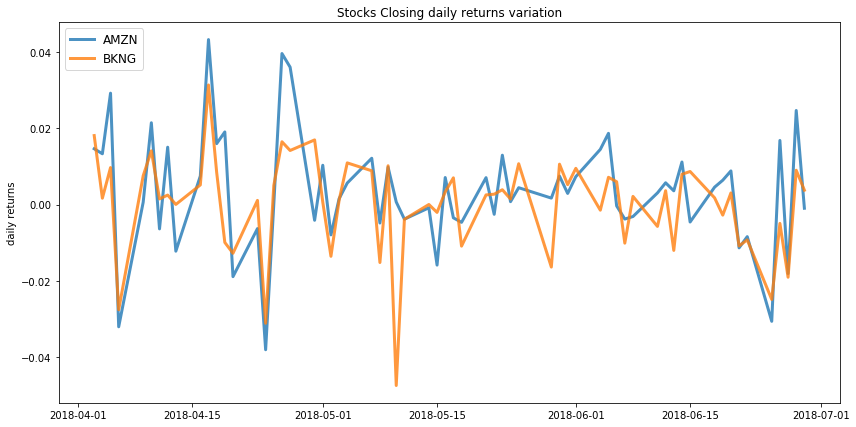

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.23
Annualised Volatility: 0.12


             AMZN  BKNG
allocation  100.0   0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.06
Annualised Volatility: 0.1


             AMZN   BKNG
allocation  26.51  73.49


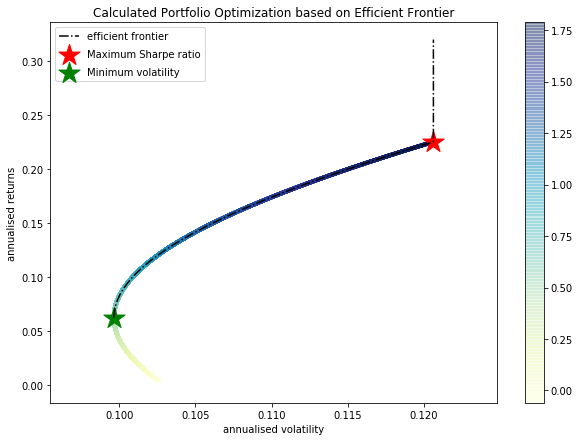

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMZN : annuaised return 0.23 , annualised volatility: 0.12
BKNG : annuaised return 0.0 , annualised volatility: 0.1
--------------------------------------------------------------------------------


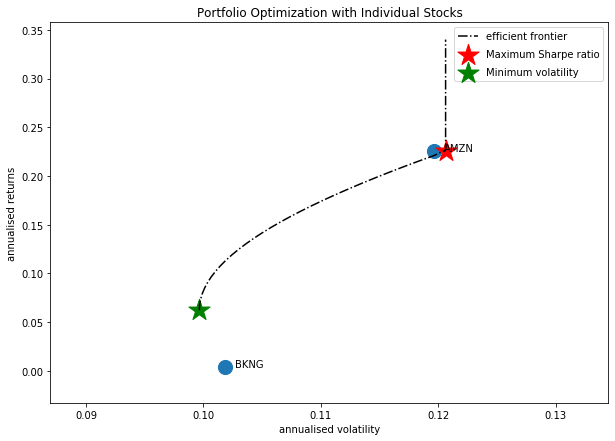

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['CBS', 'CAG']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



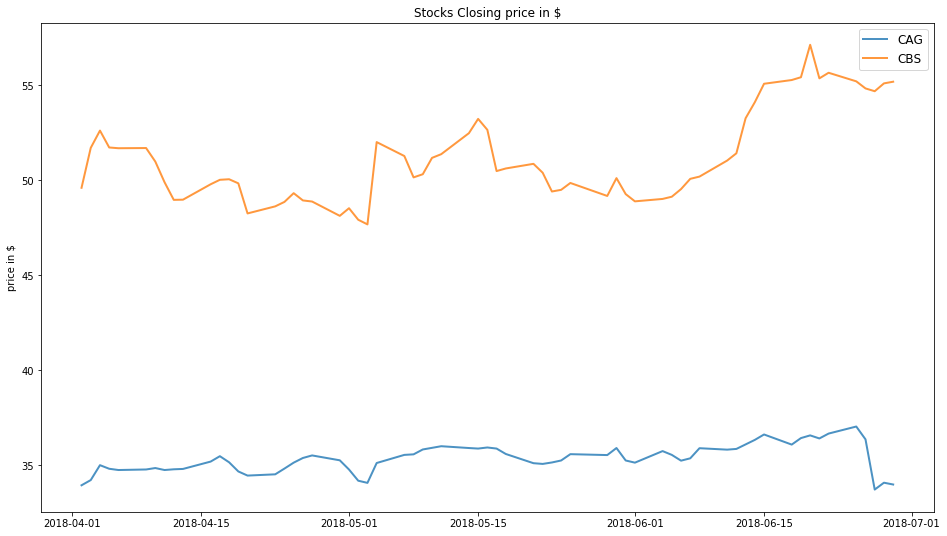

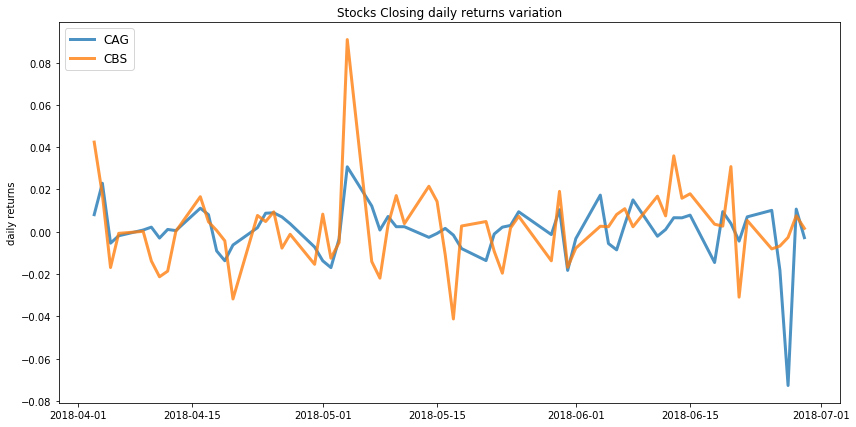

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.12
Annualised Volatility: 0.15


            CAG    CBS
allocation  0.0  100.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.03
Annualised Volatility: 0.1


              CAG    CBS
allocation  77.16  22.84


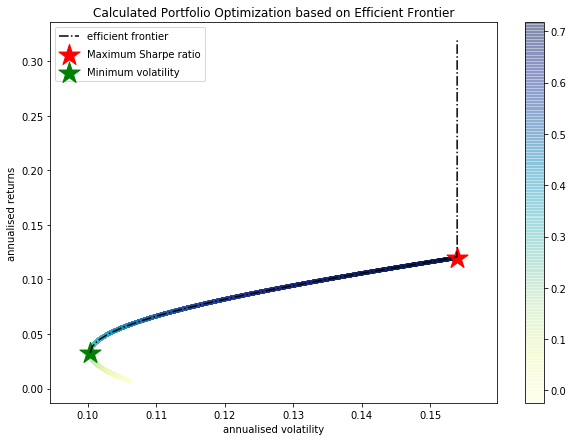

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

CAG : annuaised return 0.01 , annualised volatility: 0.11
CBS : annuaised return 0.12 , annualised volatility: 0.15
--------------------------------------------------------------------------------


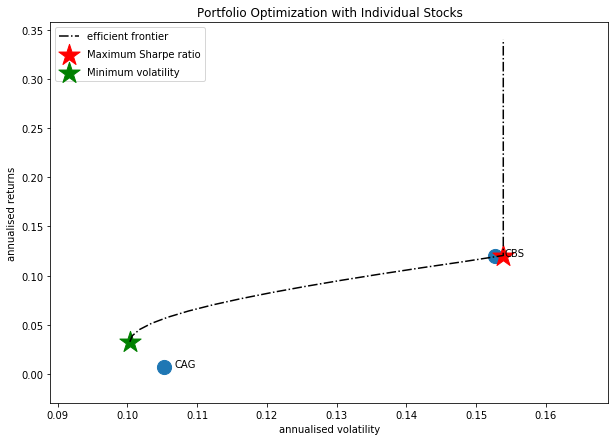

Companies listed in quarter 2 which is between 2018-07-01 and 2018-10-01
['GOOGL' 'AMZN' 'GOOG' 'MRO' 'AMD' 'BKNG']
perform efficient_frontier_stock_portfolio Pairs of the companies we got ['GOOGL', 'BKNG']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



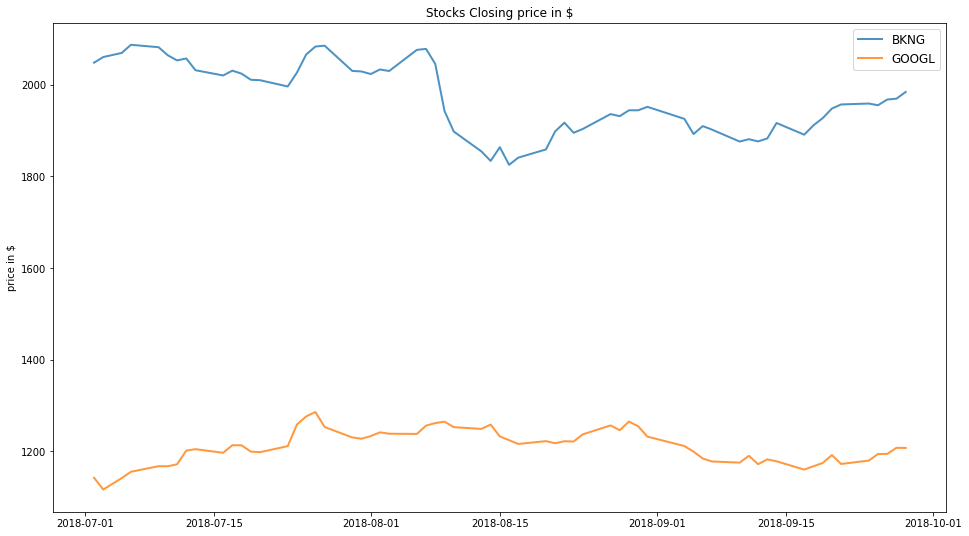

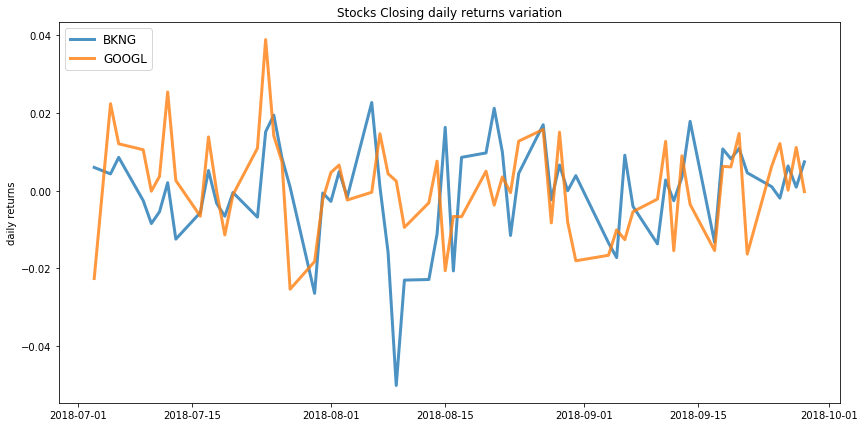

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.06
Annualised Volatility: 0.1


            BKNG  GOOGL
allocation   0.0  100.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.02
Annualised Volatility: 0.08


             BKNG  GOOGL
allocation  47.83  52.17


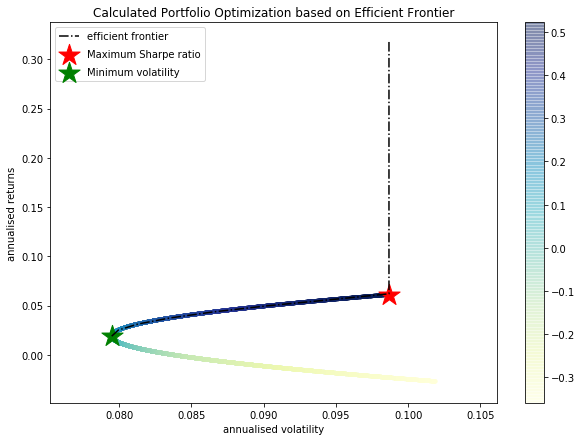

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

BKNG : annuaised return -0.03 , annualised volatility: 0.1
GOOGL : annuaised return 0.06 , annualised volatility: 0.1
--------------------------------------------------------------------------------


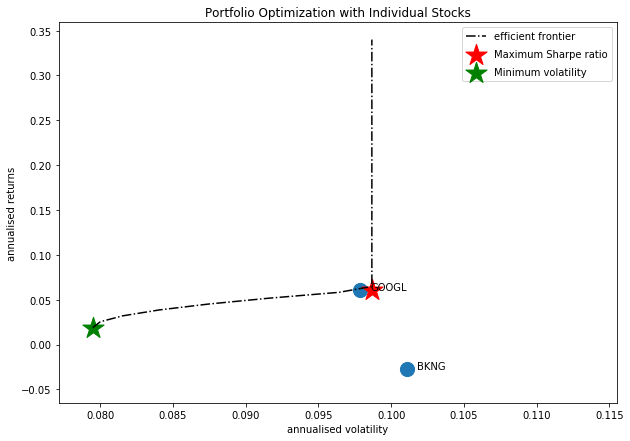

Companies listed in quarter 3 which is between 2018-10-01 and 2019-01-01
['AZO' 'NEM' 'BAC' 'CMCSA' 'EQIX' 'BKNG']
perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AZO', 'BAC']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



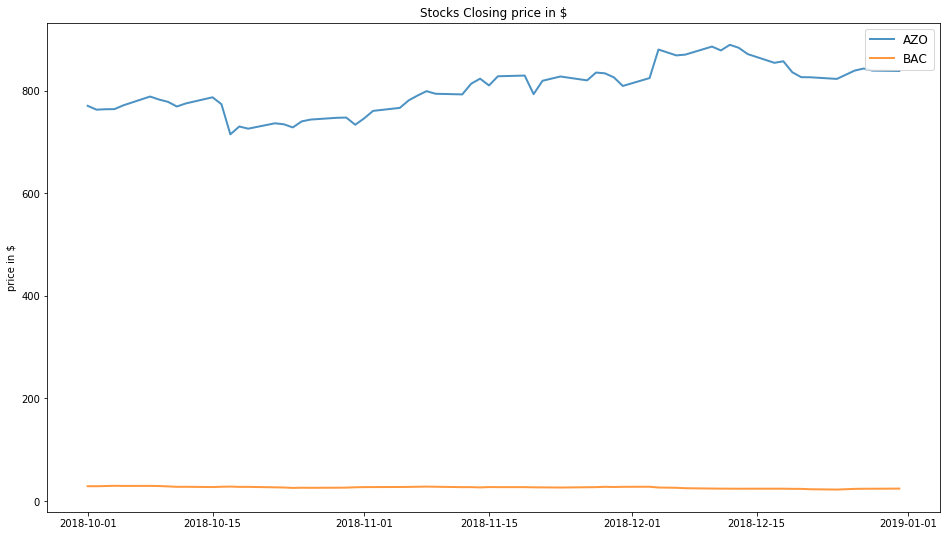

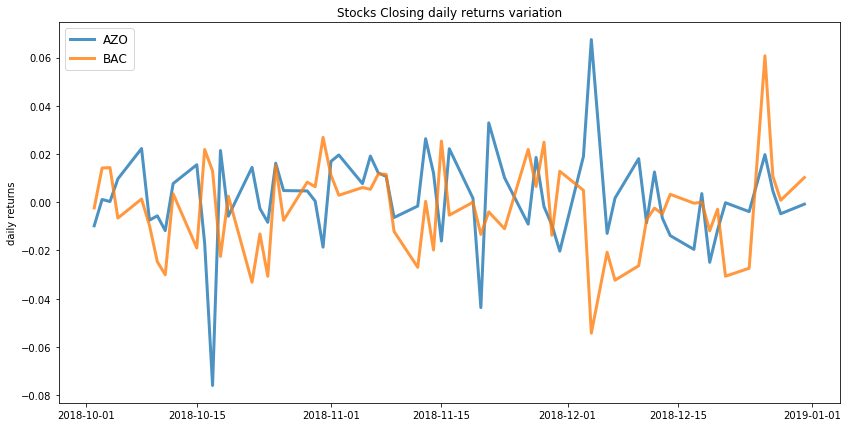

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.1
Annualised Volatility: 0.15


              AZO  BAC
allocation  100.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: -0.04
Annualised Volatility: 0.1


              AZO    BAC
allocation  48.68  51.32


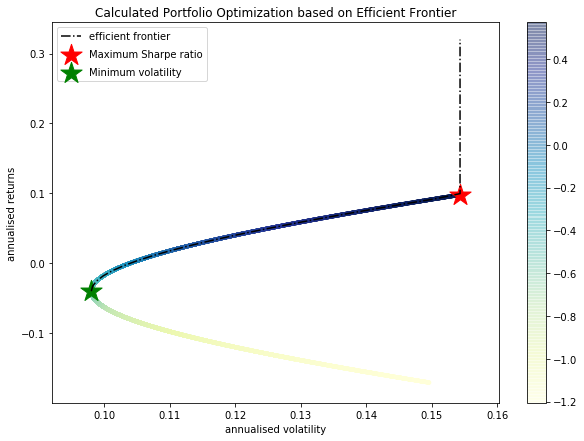

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AZO : annuaised return 0.1 , annualised volatility: 0.15
BAC : annuaised return -0.17 , annualised volatility: 0.15
--------------------------------------------------------------------------------


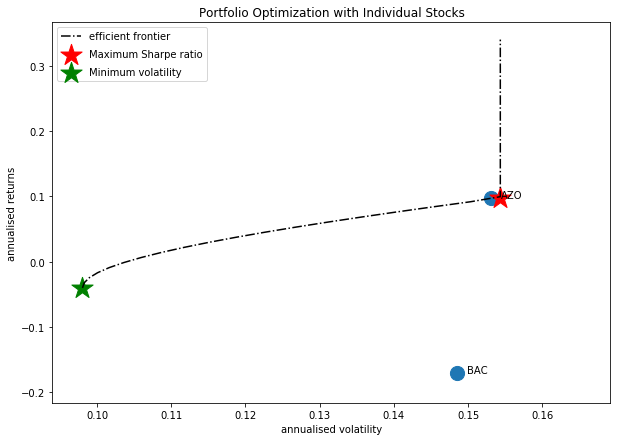

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AZO', 'CMCSA']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



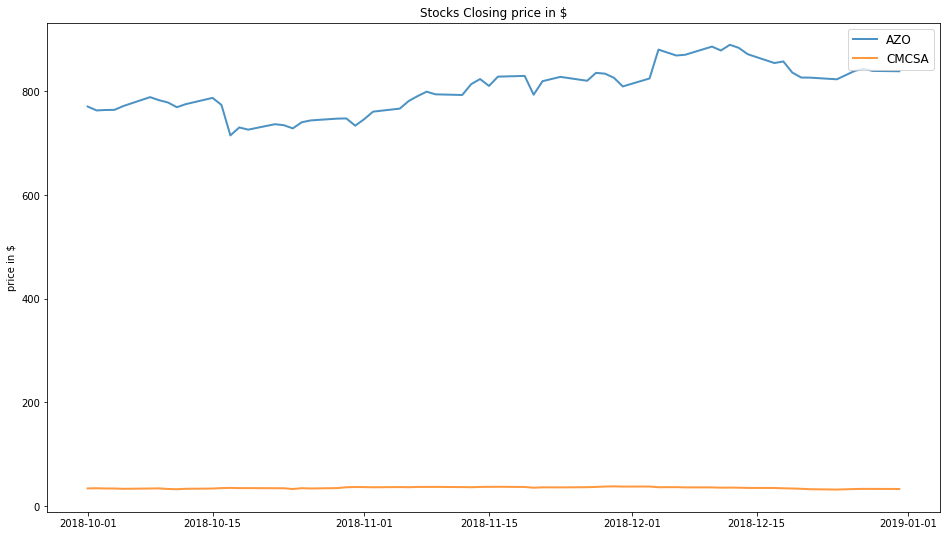

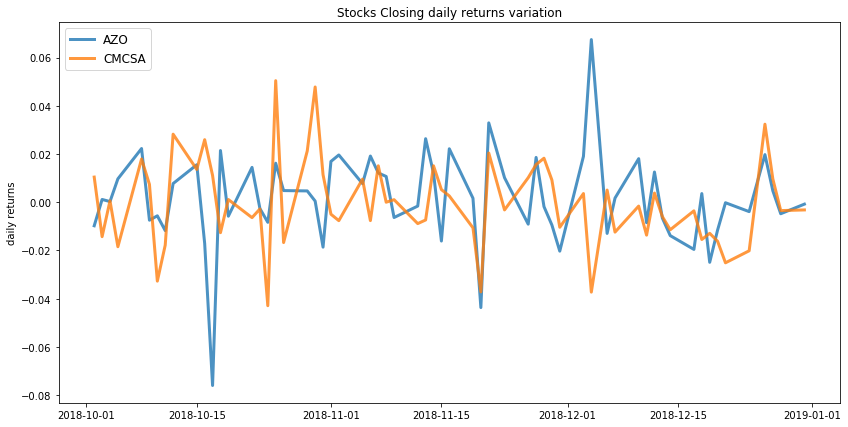

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.1
Annualised Volatility: 0.15


              AZO  CMCSA
allocation  100.0    0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.03
Annualised Volatility: 0.11


              AZO  CMCSA
allocation  46.69  53.31


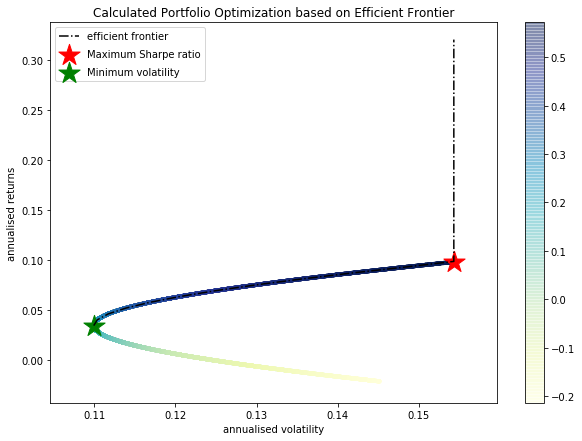

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AZO : annuaised return 0.1 , annualised volatility: 0.15
CMCSA : annuaised return -0.02 , annualised volatility: 0.14
--------------------------------------------------------------------------------


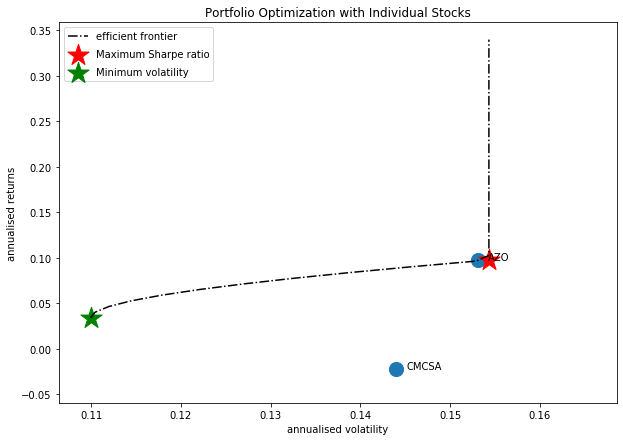

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AZO', 'EQIX']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



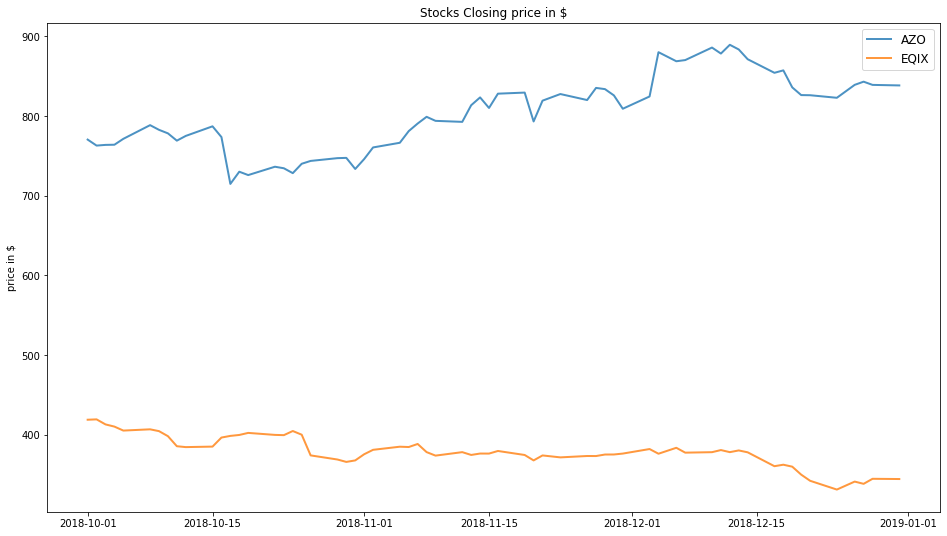

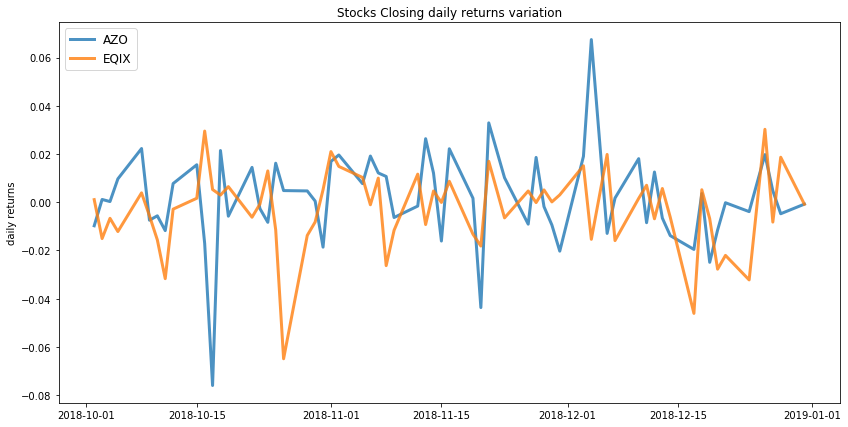

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.1
Annualised Volatility: 0.15


              AZO  EQIX
allocation  100.0   0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: -0.07
Annualised Volatility: 0.1


              AZO   EQIX
allocation  41.69  58.31


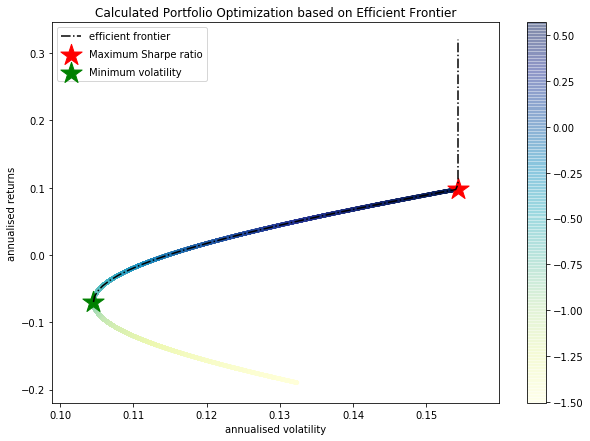

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AZO : annuaised return 0.1 , annualised volatility: 0.15
EQIX : annuaised return -0.19 , annualised volatility: 0.13
--------------------------------------------------------------------------------


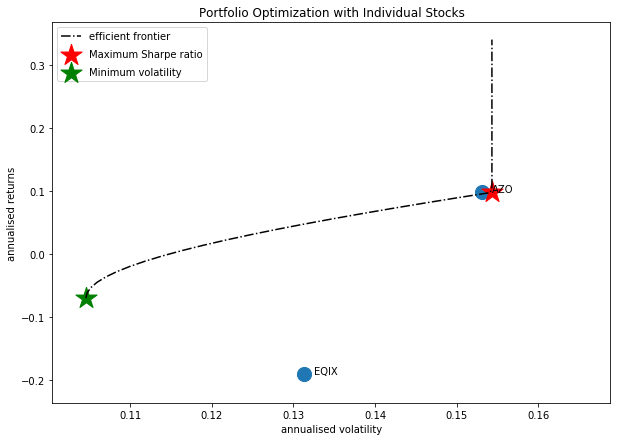

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AZO', 'BKNG']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



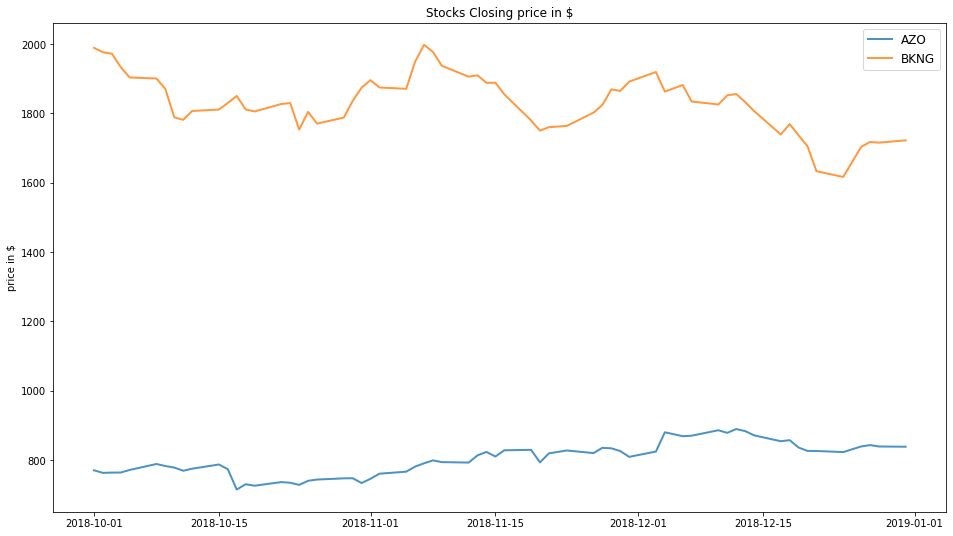

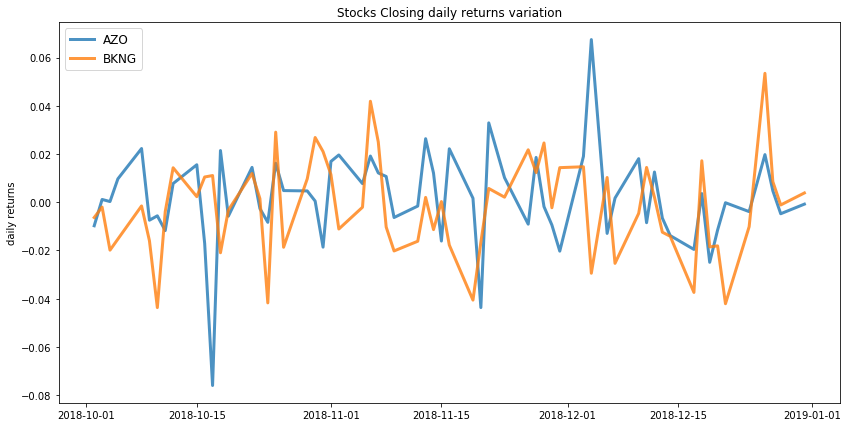

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.1
Annualised Volatility: 0.15


              AZO  BKNG
allocation  100.0   0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: -0.01
Annualised Volatility: 0.12


              AZO   BKNG
allocation  51.82  48.18


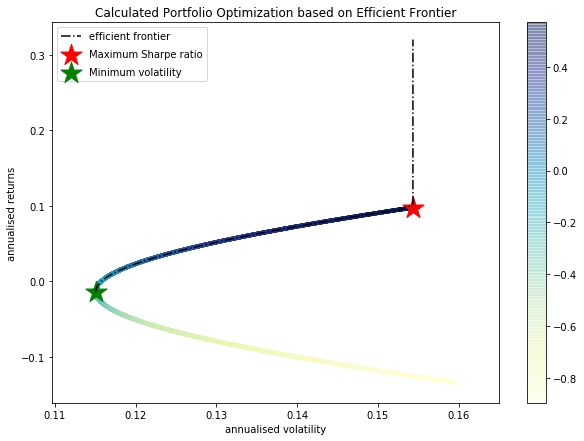

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AZO : annuaised return 0.1 , annualised volatility: 0.15
BKNG : annuaised return -0.13 , annualised volatility: 0.16
--------------------------------------------------------------------------------


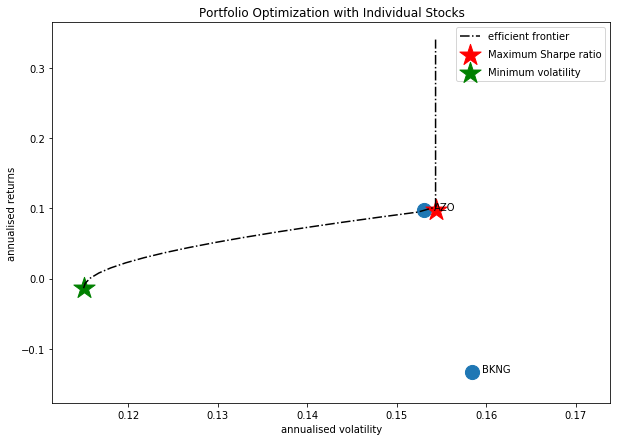

Companies listed in quarter 4 which is between 2019-01-01 and 2019-04-01
['BKNG' 'AMZN' 'NEE' 'AAPL' 'HP' 'COTY' 'KMI']
perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BKNG', 'AAPL']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



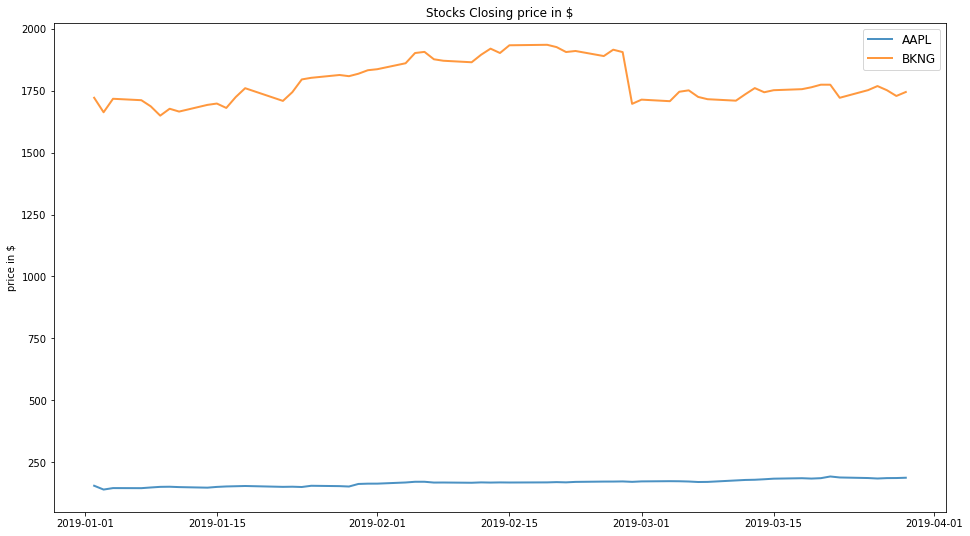

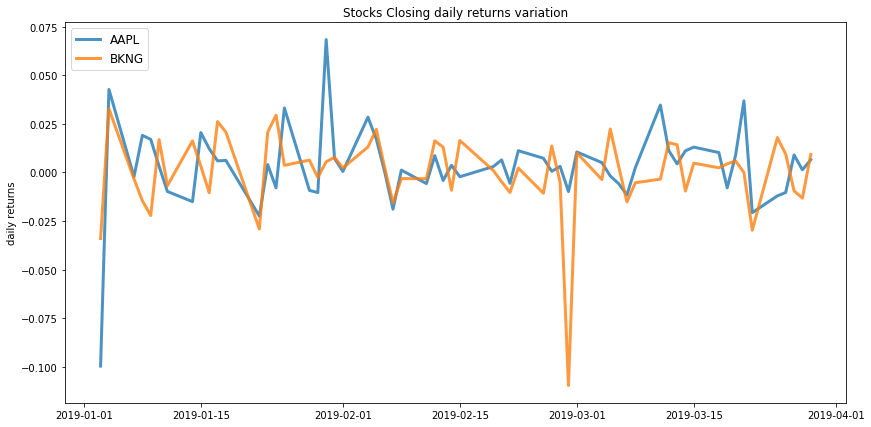

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.21
Annualised Volatility: 0.16


             AAPL  BKNG
allocation  100.0   0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.11
Annualised Volatility: 0.13


             AAPL   BKNG
allocation  48.24  51.76


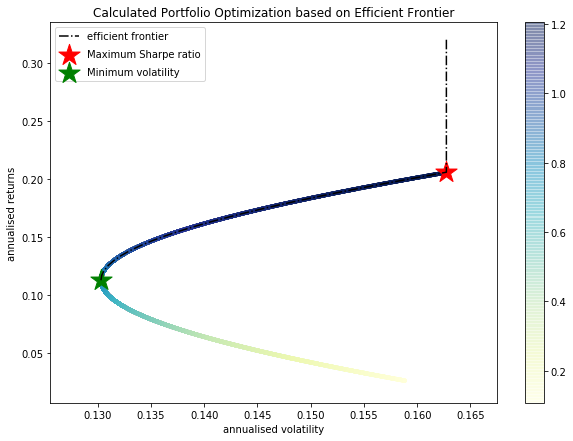

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AAPL : annuaised return 0.21 , annualised volatility: 0.16
BKNG : annuaised return 0.03 , annualised volatility: 0.16
--------------------------------------------------------------------------------


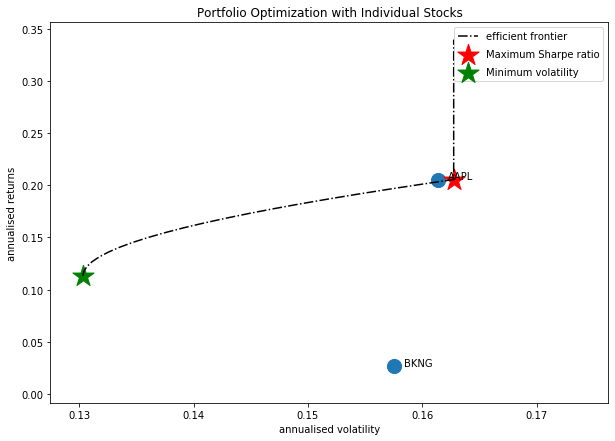

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BKNG', 'COTY']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



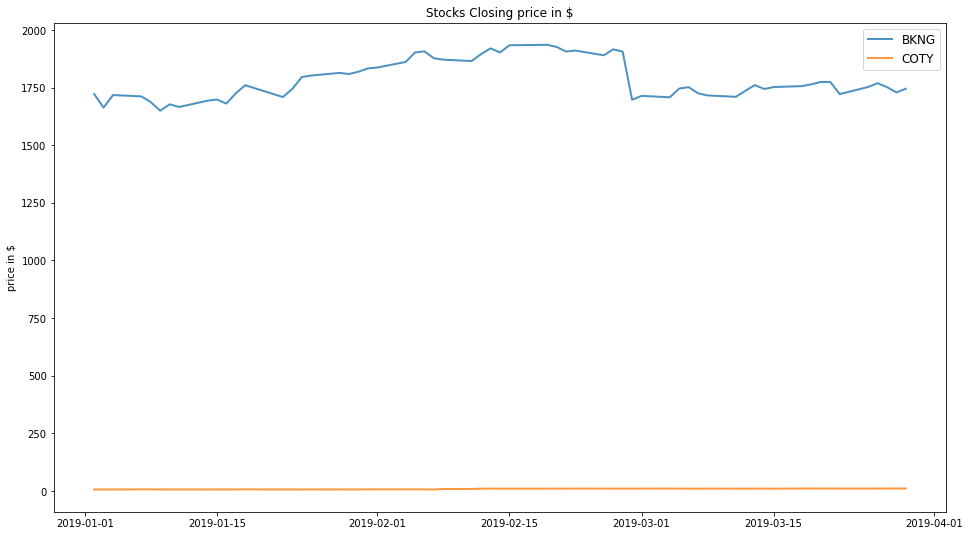

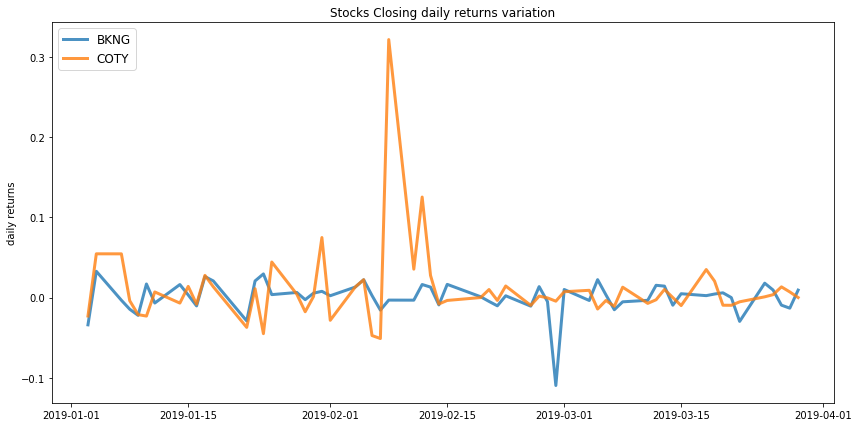

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.59
Annualised Volatility: 0.39


            BKNG   COTY
allocation   0.0  100.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.09
Annualised Volatility: 0.15


            BKNG  COTY
allocation  89.0  11.0


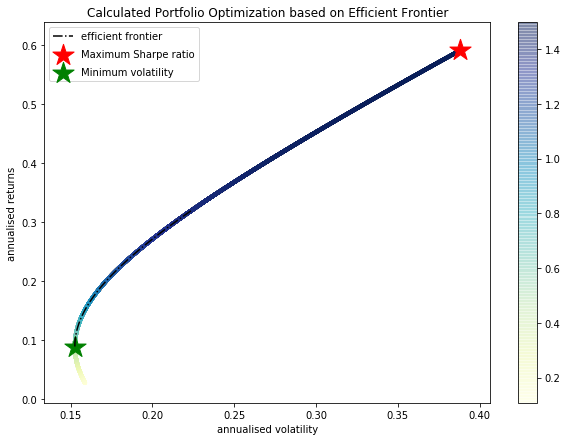

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

BKNG : annuaised return 0.03 , annualised volatility: 0.16
COTY : annuaised return 0.59 , annualised volatility: 0.38
--------------------------------------------------------------------------------


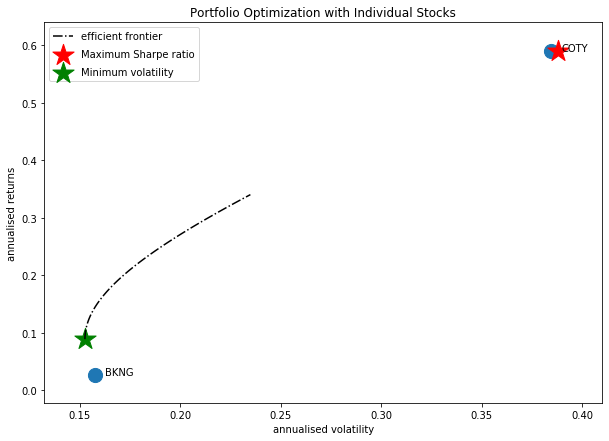

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BKNG', 'KMI']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



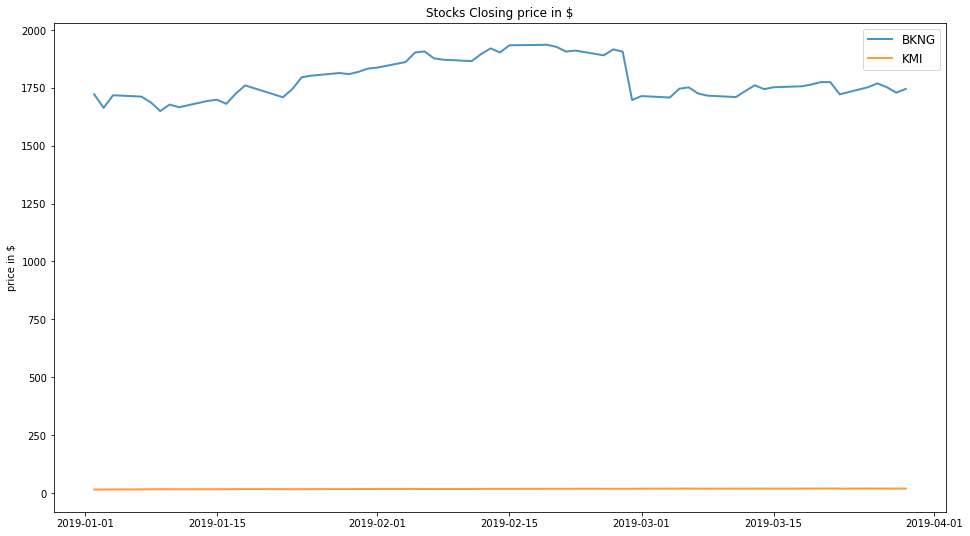

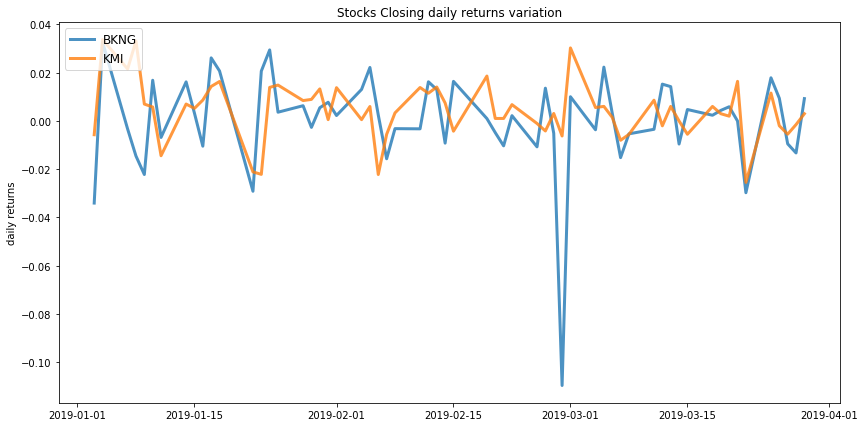

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.26
Annualised Volatility: 0.09


            BKNG    KMI
allocation   0.0  100.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.22
Annualised Volatility: 0.09


             BKNG    KMI
allocation  15.68  84.32


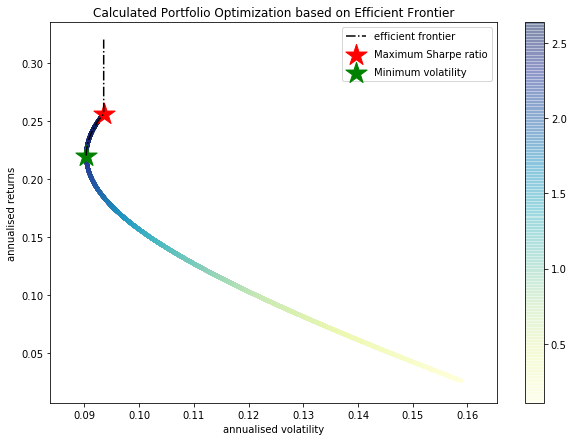

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

BKNG : annuaised return 0.03 , annualised volatility: 0.16
KMI : annuaised return 0.26 , annualised volatility: 0.09
--------------------------------------------------------------------------------


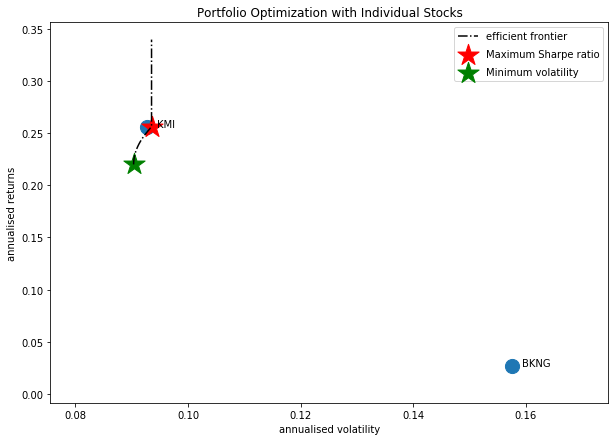

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AMZN', 'AAPL']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



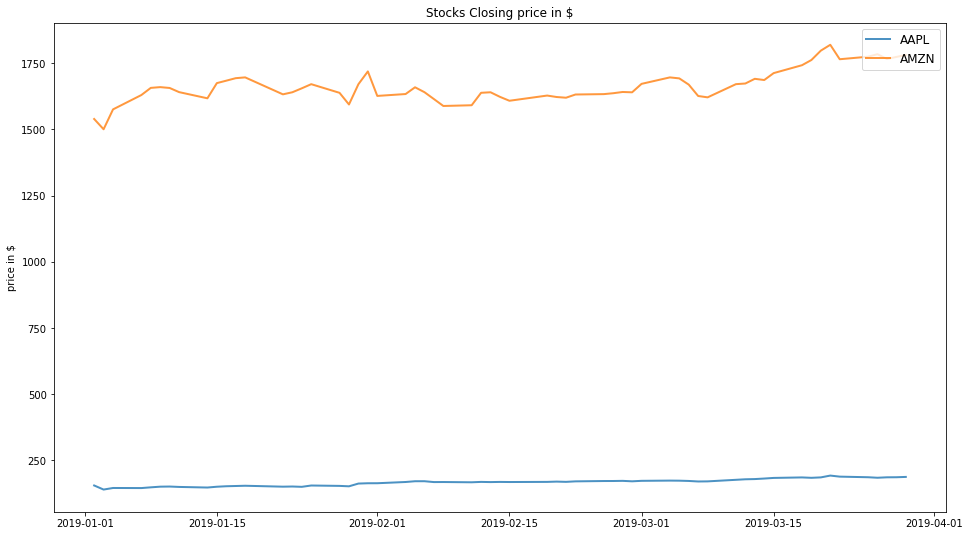

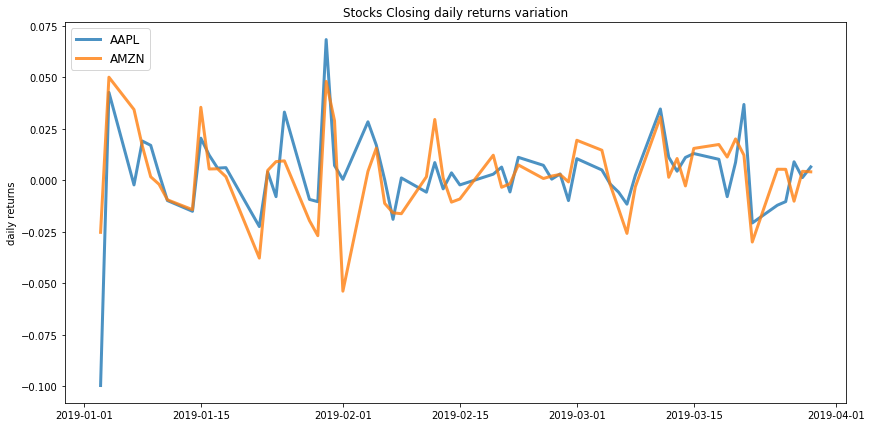

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.19
Annualised Volatility: 0.15


            AAPL  AMZN
allocation  68.0  32.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.18
Annualised Volatility: 0.14


             AAPL   AMZN
allocation  38.78  61.22


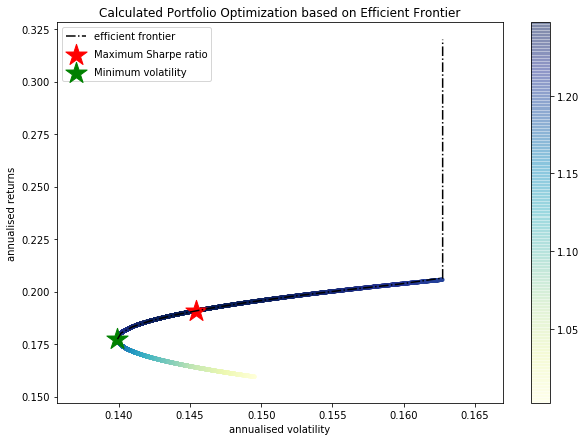

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AAPL : annuaised return 0.21 , annualised volatility: 0.16
AMZN : annuaised return 0.16 , annualised volatility: 0.15
--------------------------------------------------------------------------------


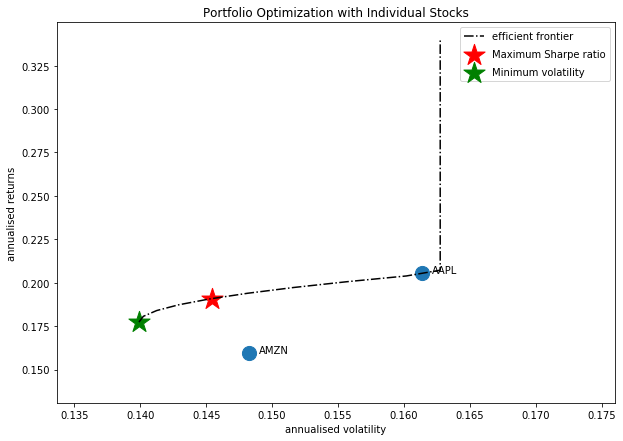

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AMZN', 'COTY']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



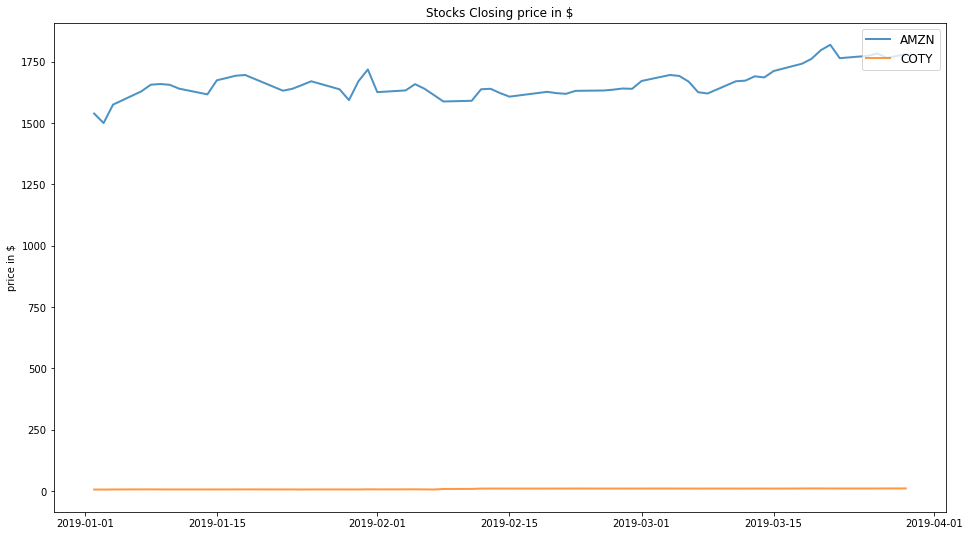

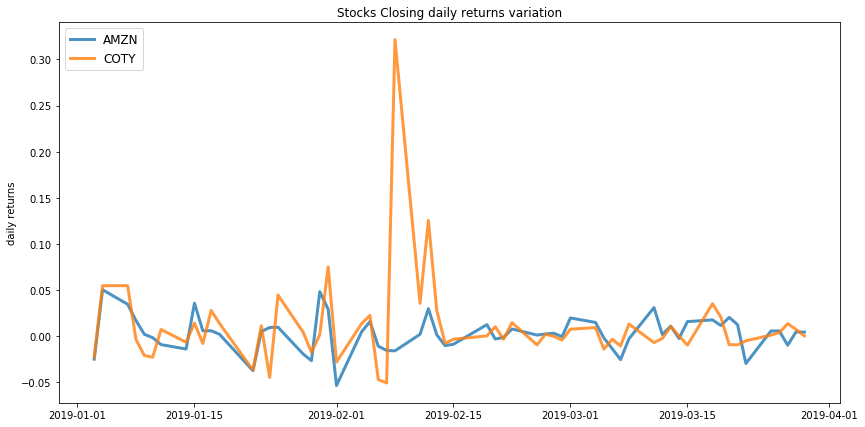

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.34
Annualised Volatility: 0.2


             AMZN   COTY
allocation  58.37  41.63
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.19
Annualised Volatility: 0.15


             AMZN  COTY
allocation  92.89  7.11


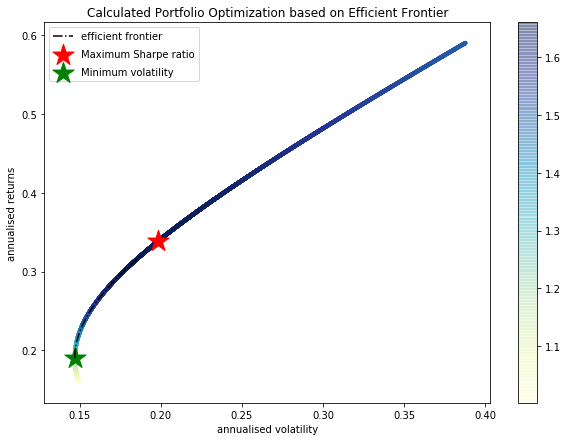

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMZN : annuaised return 0.16 , annualised volatility: 0.15
COTY : annuaised return 0.59 , annualised volatility: 0.38
--------------------------------------------------------------------------------


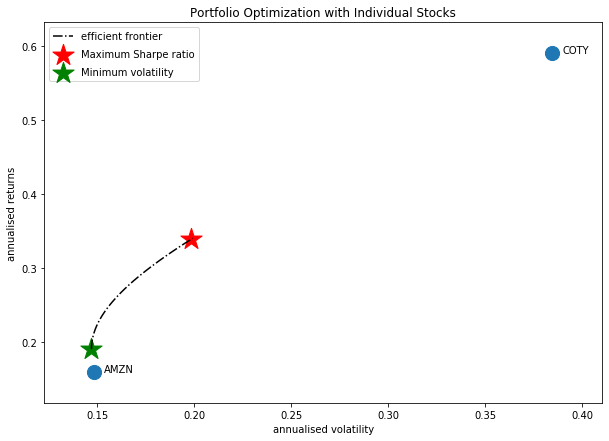

Companies listed in quarter 5 which is between 2019-04-01 and 2019-07-01
['AMZN' 'ESS' 'BKNG' 'BIIB' 'EXC' 'APC' 'CPB' 'GOOGL' 'ALGN']
perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AMZN', 'APC']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



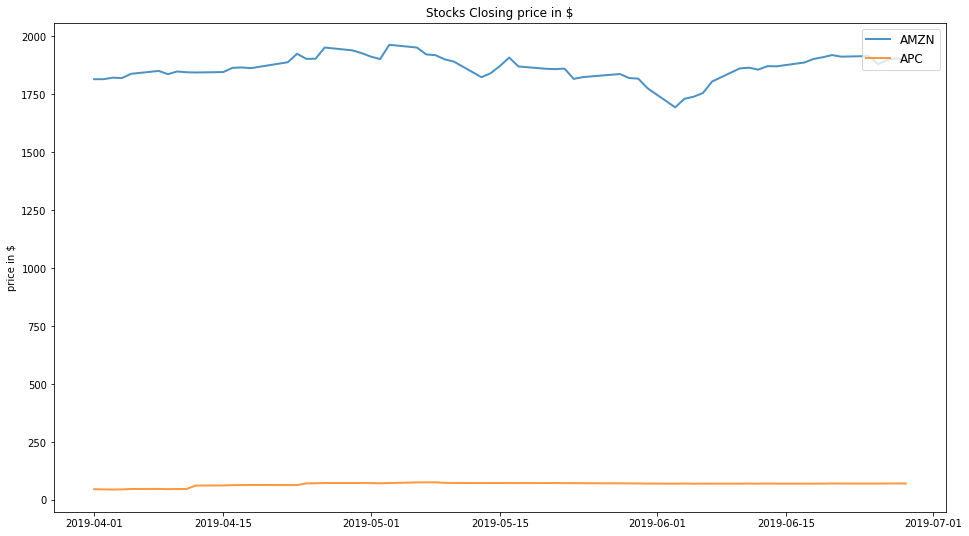

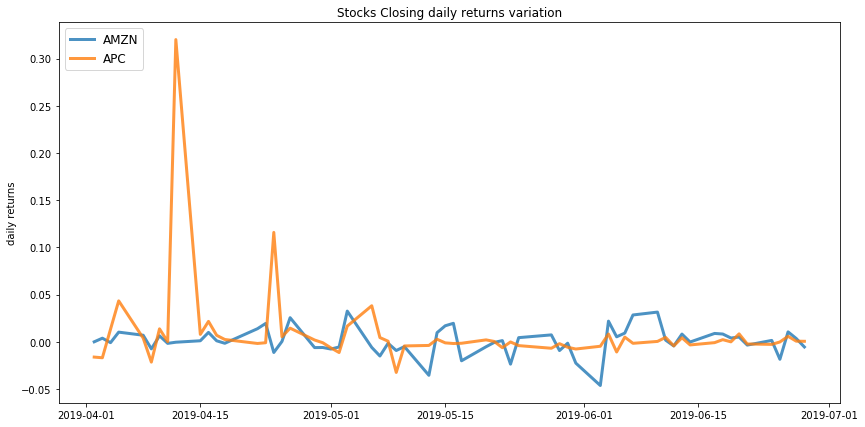

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.3
Annualised Volatility: 0.21


             AMZN    APC
allocation  43.06  56.94
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.09
Annualised Volatility: 0.11


             AMZN   APC
allocation  91.24  8.76


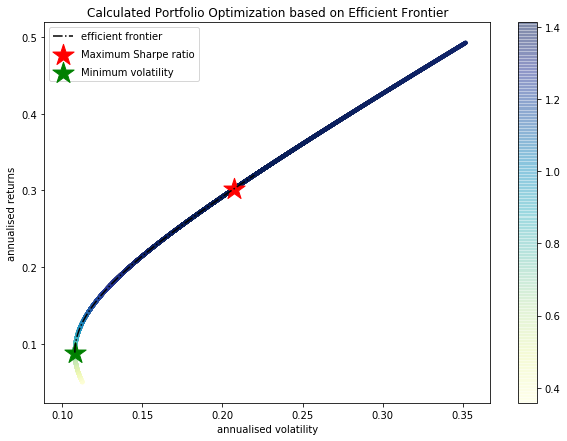

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMZN : annuaised return 0.05 , annualised volatility: 0.11
APC : annuaised return 0.49 , annualised volatility: 0.35
--------------------------------------------------------------------------------


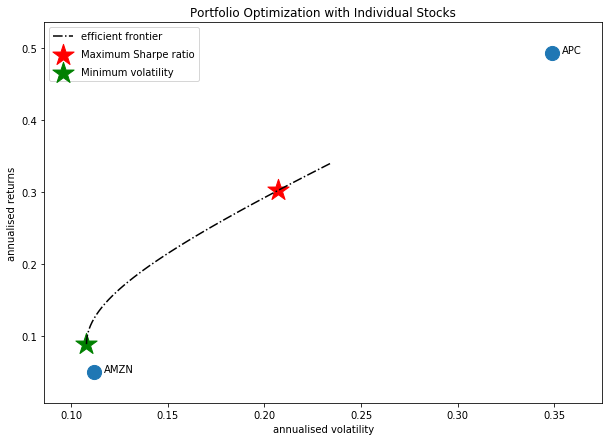

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['ESS', 'BKNG', 'BIIB', 'APC']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



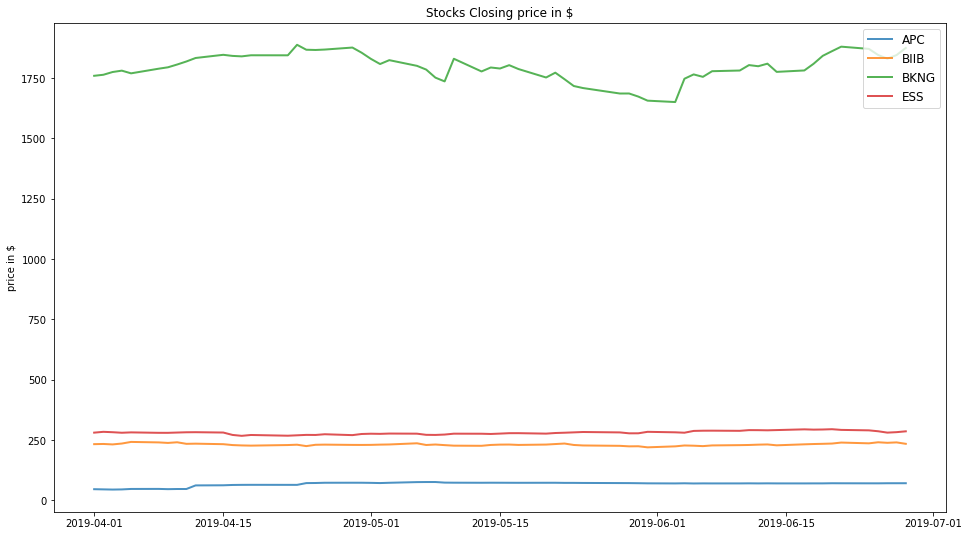

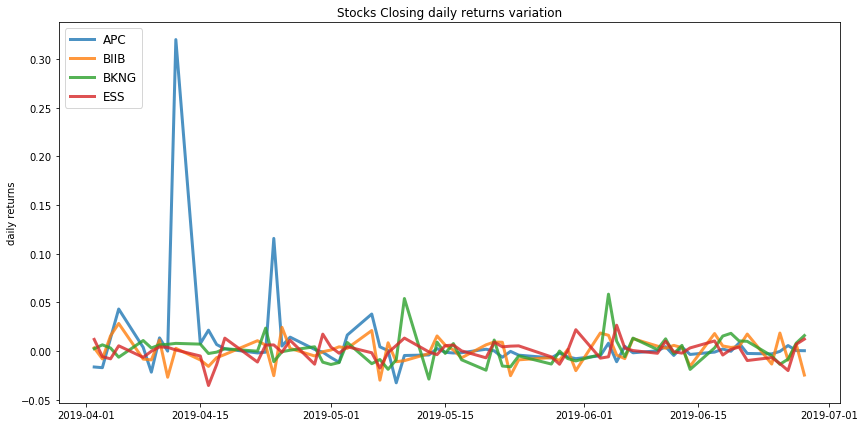

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.24
Annualised Volatility: 0.15


              APC  BIIB   BKNG    ESS
allocation  40.96   0.0  41.96  17.08
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.04
Annualised Volatility: 0.06


             APC   BIIB   BKNG    ESS
allocation  2.66  29.81  16.94  50.59


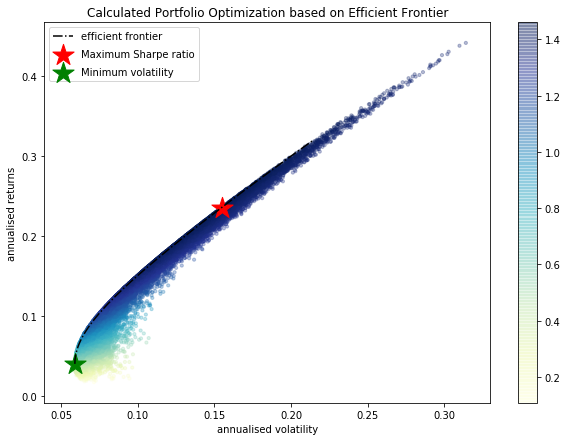

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

APC : annuaised return 0.49 , annualised volatility: 0.35
BIIB : annuaised return 0.01 , annualised volatility: 0.1
BKNG : annuaised return 0.07 , annualised volatility: 0.12
ESS : annuaised return 0.02 , annualised volatility: 0.08
--------------------------------------------------------------------------------


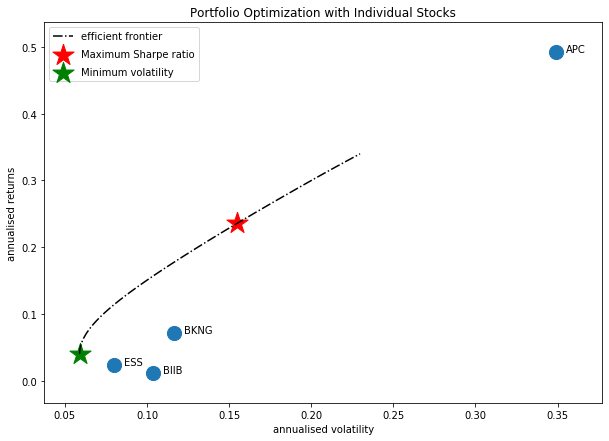

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['ESS', 'BKNG', 'BIIB', 'APC', 'CPB']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



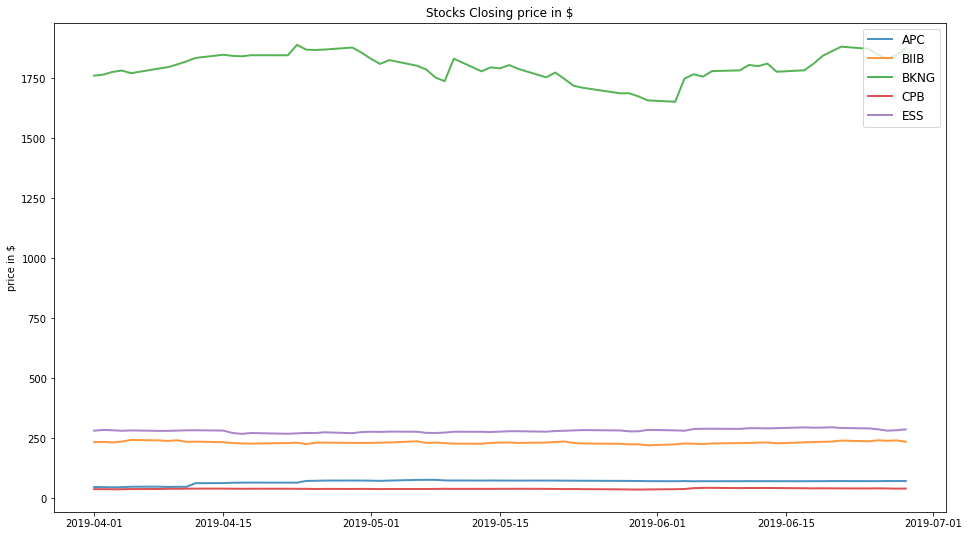

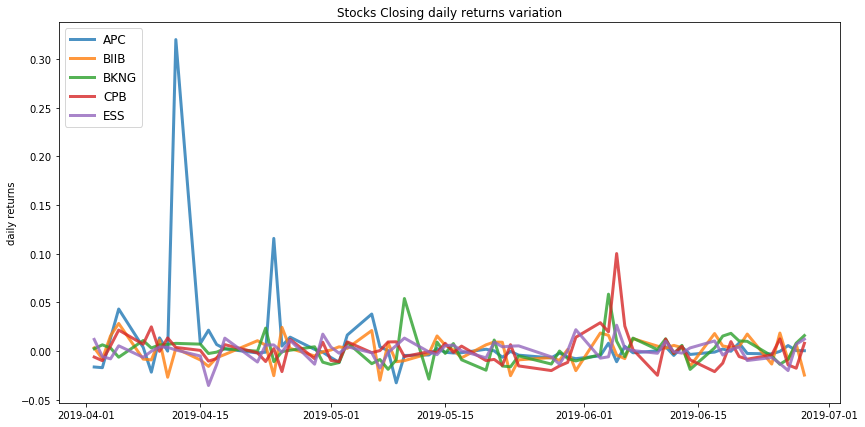

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.23
Annualised Volatility: 0.14


              APC  BIIB   BKNG    CPB  ESS
allocation  36.88   0.0  35.56  27.56  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.04
Annualised Volatility: 0.06


             APC   BIIB   BKNG   CPB   ESS
allocation  2.55  29.65  15.77  7.23  44.8


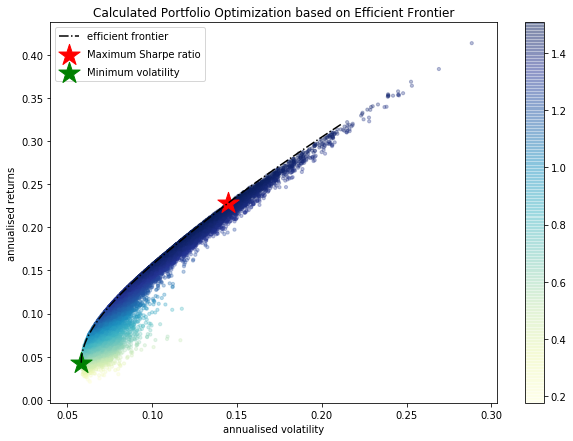

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

APC : annuaised return 0.49 , annualised volatility: 0.35
BIIB : annuaised return 0.01 , annualised volatility: 0.1
BKNG : annuaised return 0.07 , annualised volatility: 0.12
CPB : annuaised return 0.08 , annualised volatility: 0.14
ESS : annuaised return 0.02 , annualised volatility: 0.08
--------------------------------------------------------------------------------


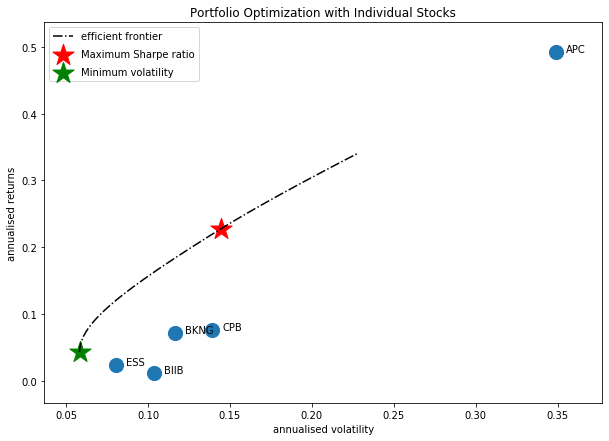

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['ESS', 'GOOGL']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



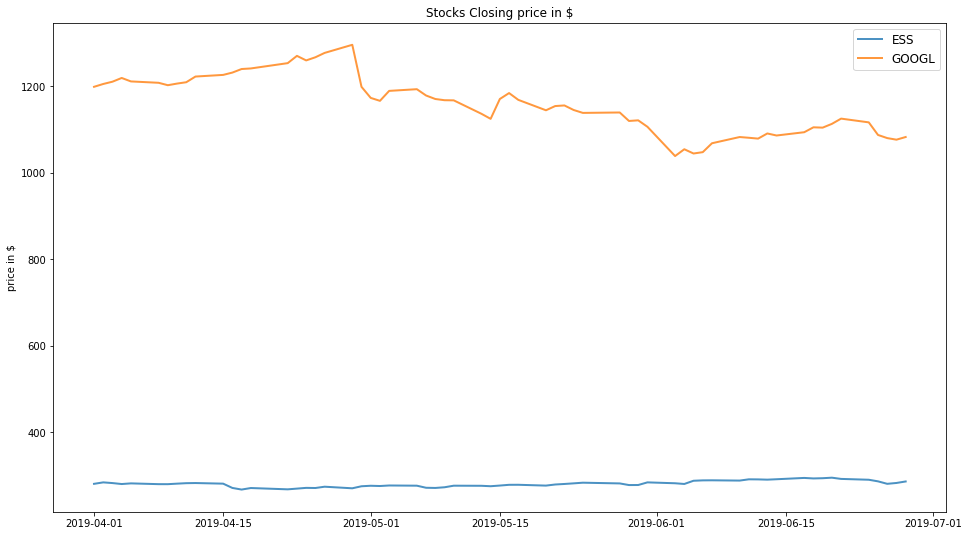

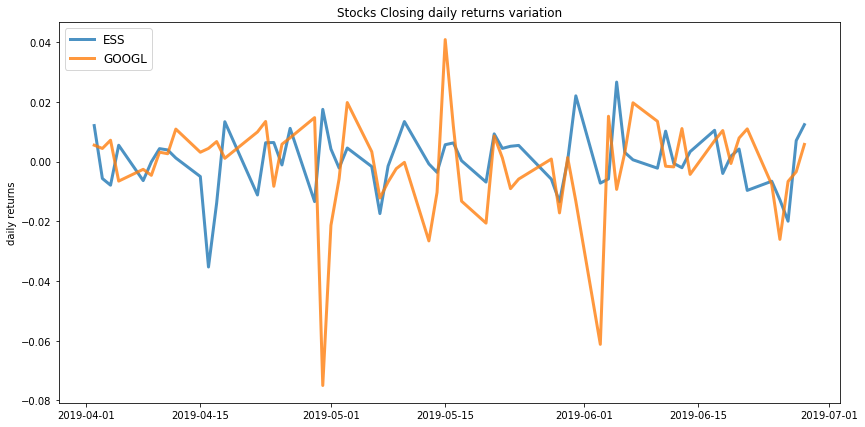

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.02
Annualised Volatility: 0.08


              ESS  GOOGL
allocation  100.0    0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: -0.01
Annualised Volatility: 0.07


              ESS  GOOGL
allocation  72.46  27.54


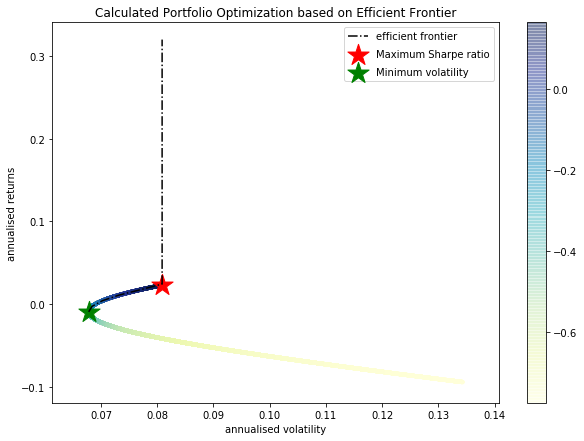

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

ESS : annuaised return 0.02 , annualised volatility: 0.08
GOOGL : annuaised return -0.09 , annualised volatility: 0.13
--------------------------------------------------------------------------------


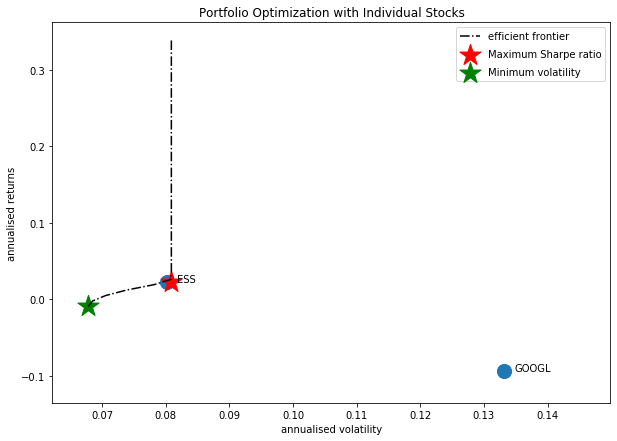

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BKNG', 'EXC']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



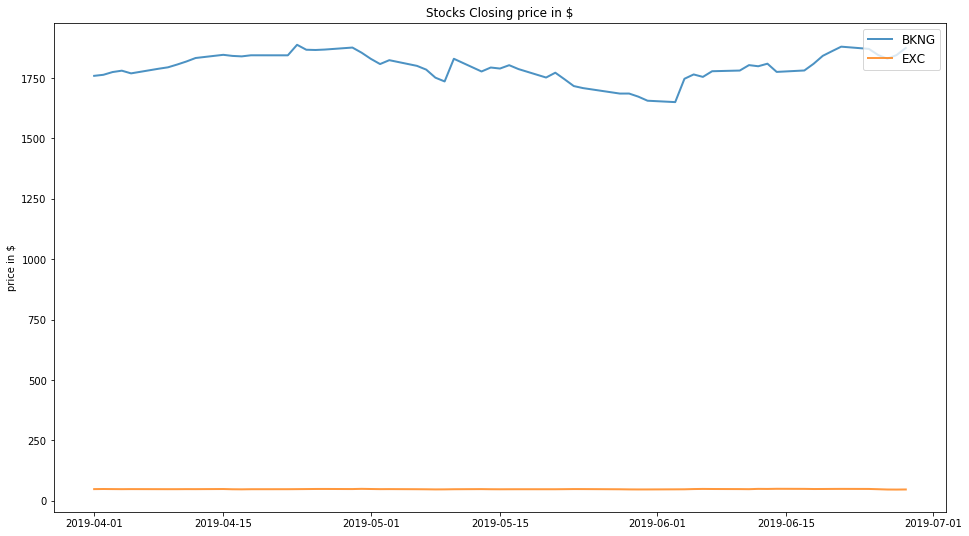

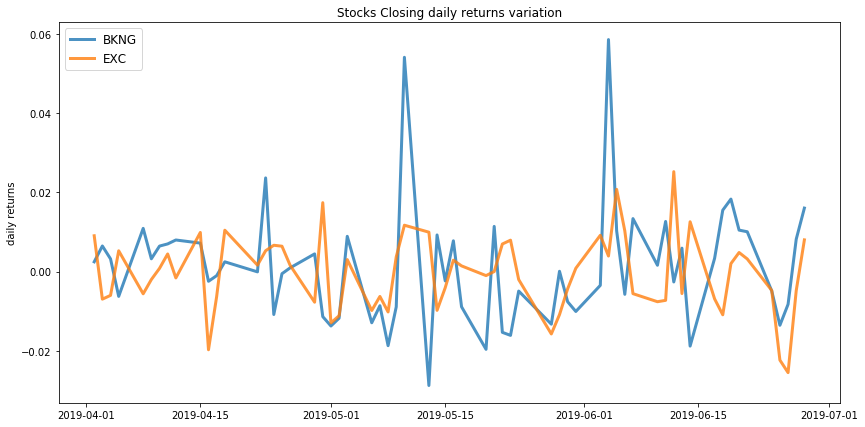

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.07
Annualised Volatility: 0.12


             BKNG  EXC
allocation  100.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: -0.0
Annualised Volatility: 0.07


             BKNG    EXC
allocation  27.51  72.49


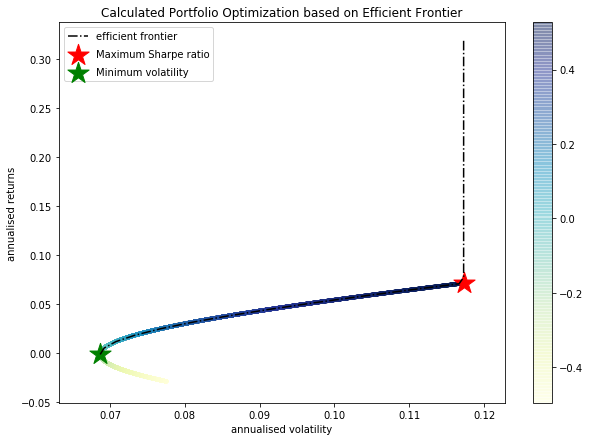

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

BKNG : annuaised return 0.07 , annualised volatility: 0.12
EXC : annuaised return -0.03 , annualised volatility: 0.08
--------------------------------------------------------------------------------


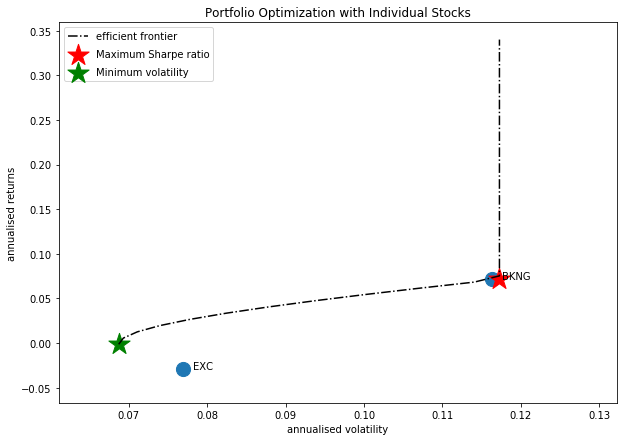

Companies listed in quarter 6 which is between 2019-07-01 and 2019-10-01
['AJG' 'BKNG' 'NEE' 'EMR' 'MLM' 'DHI' 'BLK']
perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AJG', 'DHI']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



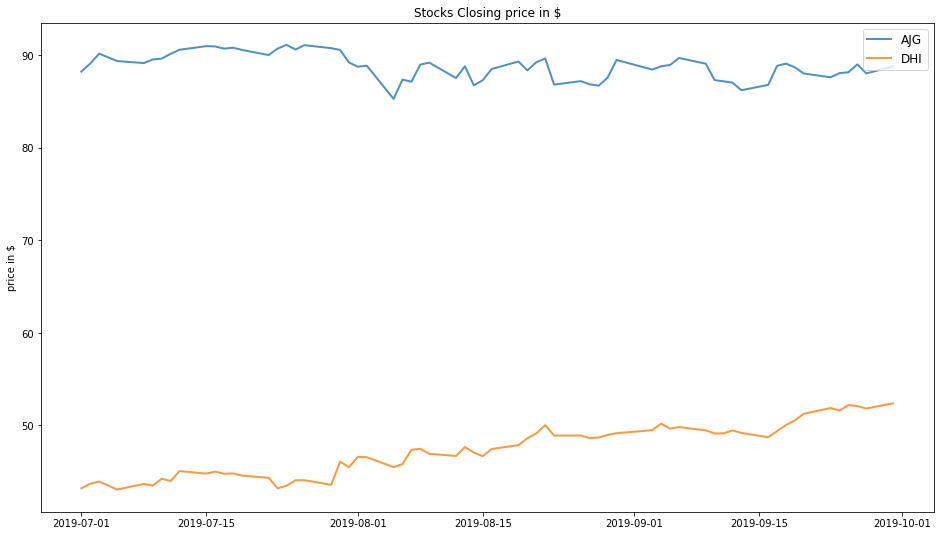

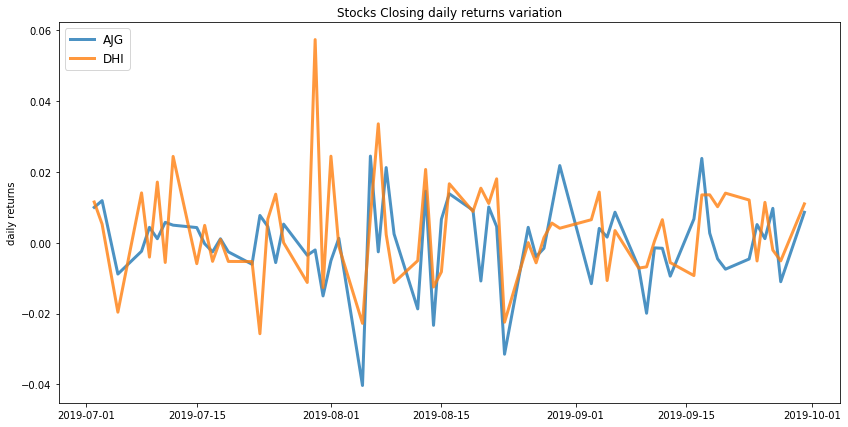

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.2
Annualised Volatility: 0.11


            AJG    DHI
allocation  0.0  100.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.08
Annualised Volatility: 0.08


              AJG    DHI
allocation  62.76  37.24


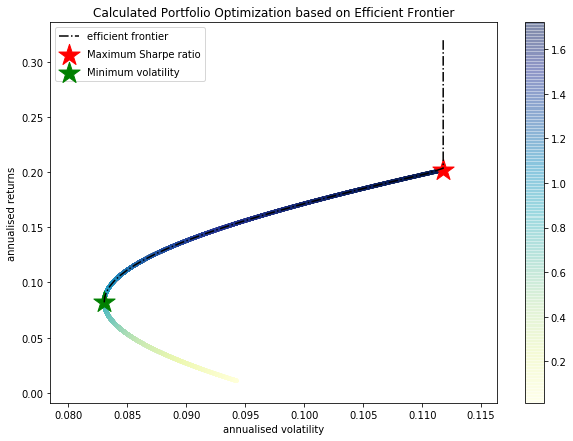

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AJG : annuaised return 0.01 , annualised volatility: 0.09
DHI : annuaised return 0.2 , annualised volatility: 0.11
--------------------------------------------------------------------------------


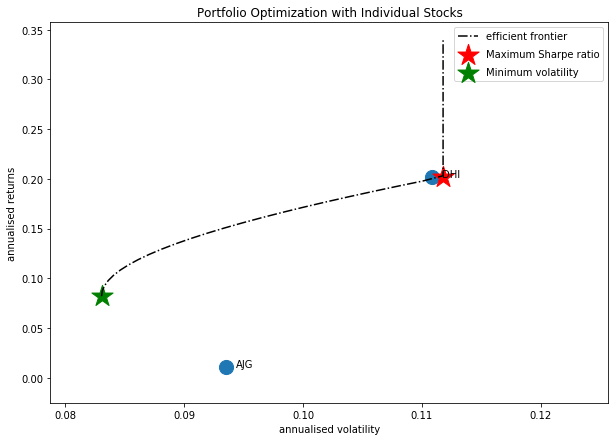

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BKNG', 'EMR']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



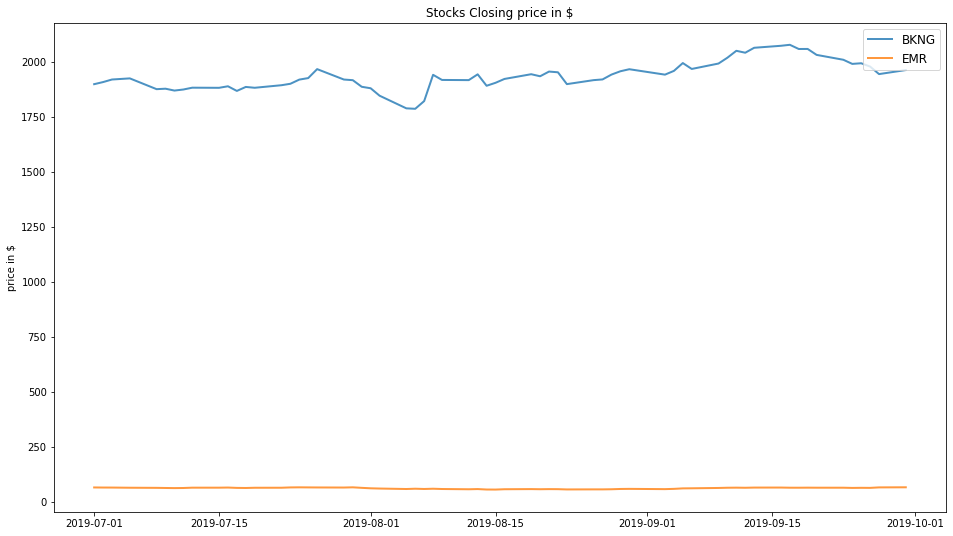

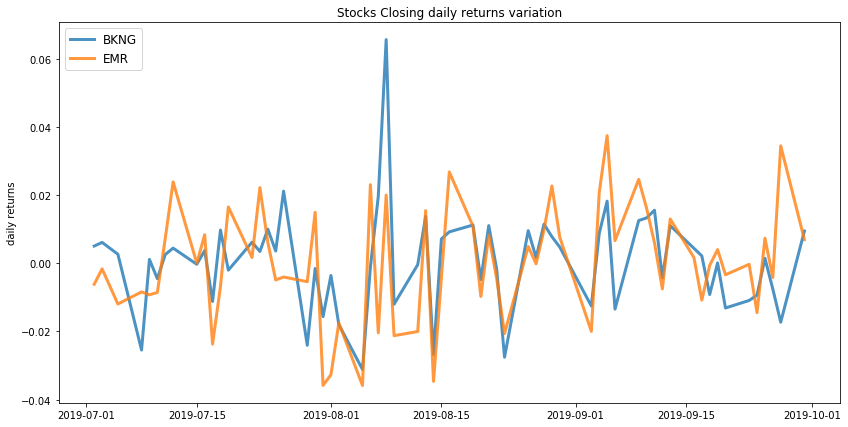

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.04
Annualised Volatility: 0.12


             BKNG  EMR
allocation  100.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.03
Annualised Volatility: 0.11


             BKNG    EMR
allocation  64.36  35.64


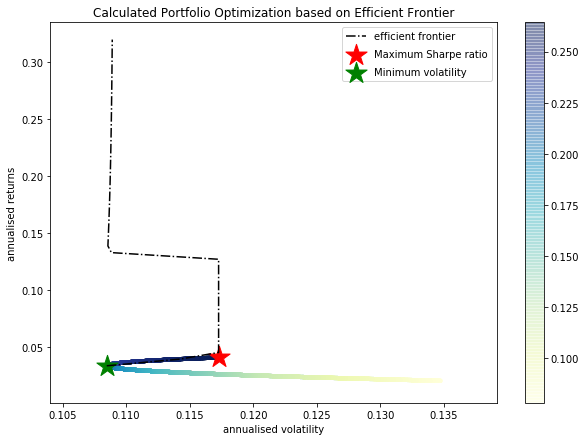

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

BKNG : annuaised return 0.04 , annualised volatility: 0.12
EMR : annuaised return 0.02 , annualised volatility: 0.13
--------------------------------------------------------------------------------


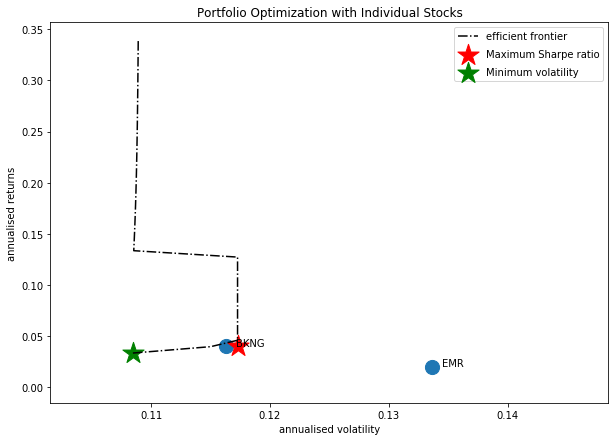

Companies listed in quarter 7 which is between 2019-10-01 and 2020-01-01
['EFX' 'BKNG' 'BLK' 'BIIB' 'AOS' 'HP' 'AMD' 'BA']
perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EFX', 'BLK', 'BIIB']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



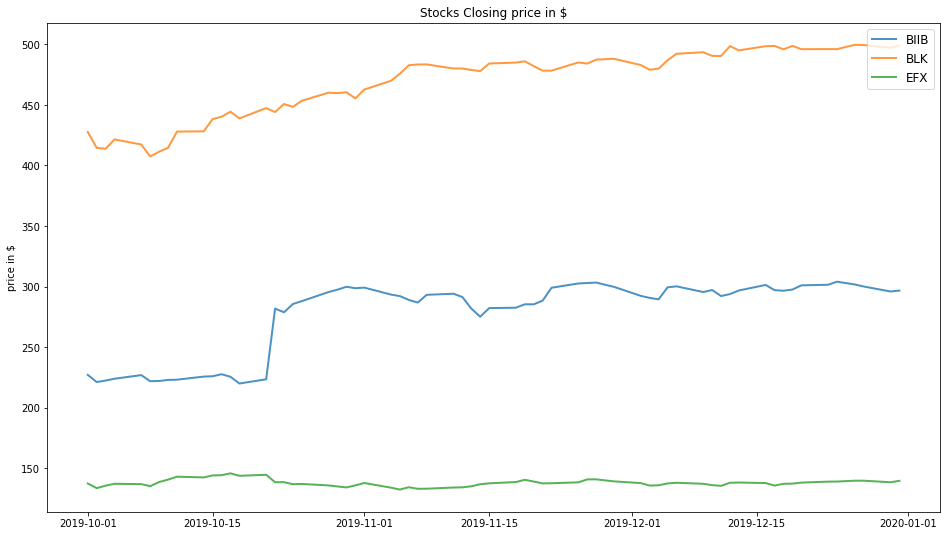

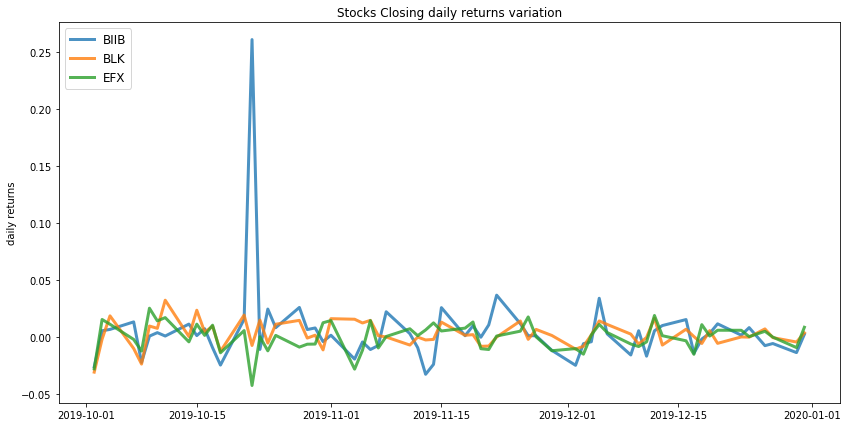

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.18
Annualised Volatility: 0.09


             BIIB    BLK  EFX
allocation  15.11  84.89  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.11
Annualised Volatility: 0.07


             BIIB    BLK    EFX
allocation  10.81  43.89  45.31


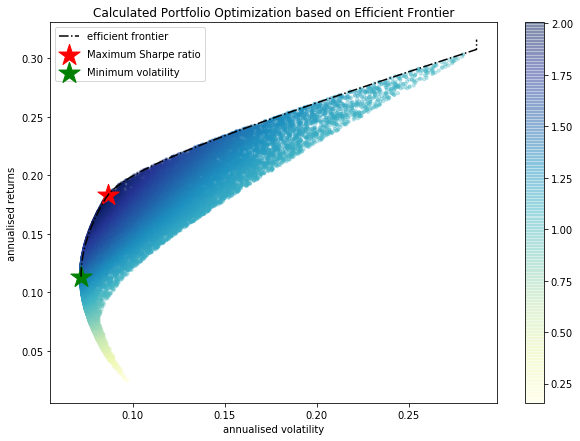

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

BIIB : annuaised return 0.31 , annualised volatility: 0.28
BLK : annuaised return 0.16 , annualised volatility: 0.09
EFX : annuaised return 0.02 , annualised volatility: 0.1
--------------------------------------------------------------------------------


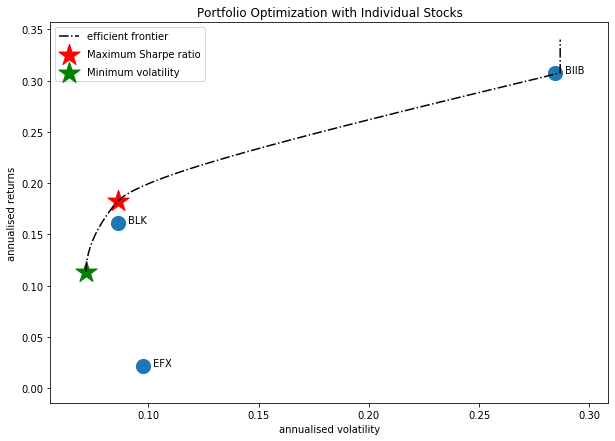

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BKNG', 'BIIB', 'AOS']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



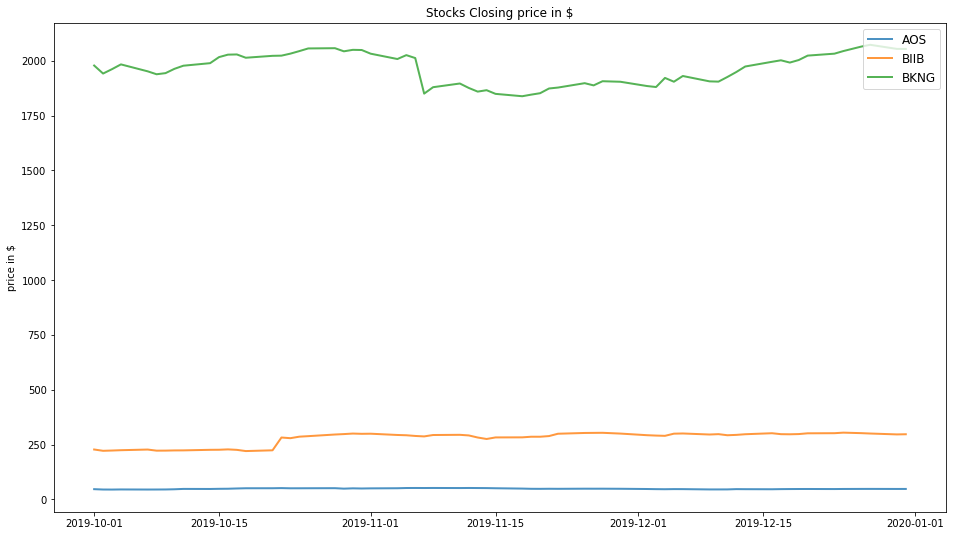

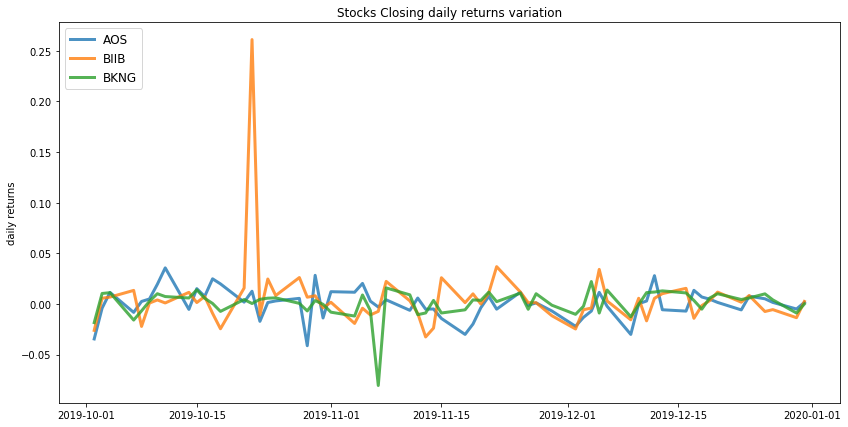

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.21
Annualised Volatility: 0.19


            AOS   BIIB   BKNG
allocation  0.0  64.36  35.64
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.05
Annualised Volatility: 0.09


              AOS  BIIB   BKNG
allocation  42.41  4.71  52.88


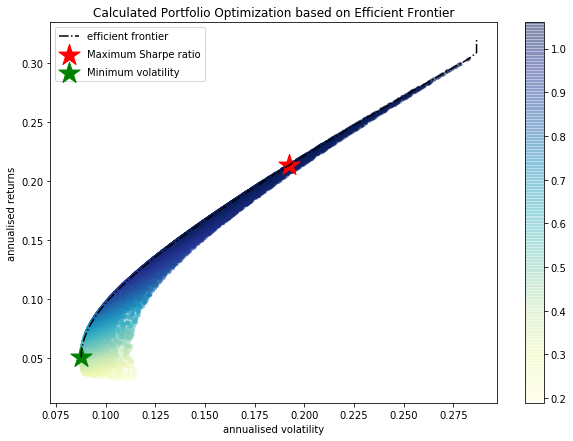

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AOS : annuaised return 0.03 , annualised volatility: 0.12
BIIB : annuaised return 0.31 , annualised volatility: 0.28
BKNG : annuaised return 0.04 , annualised volatility: 0.11
--------------------------------------------------------------------------------


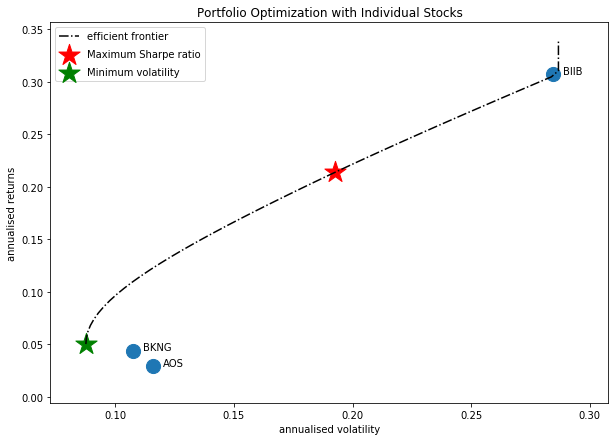

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BKNG', 'AMD']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



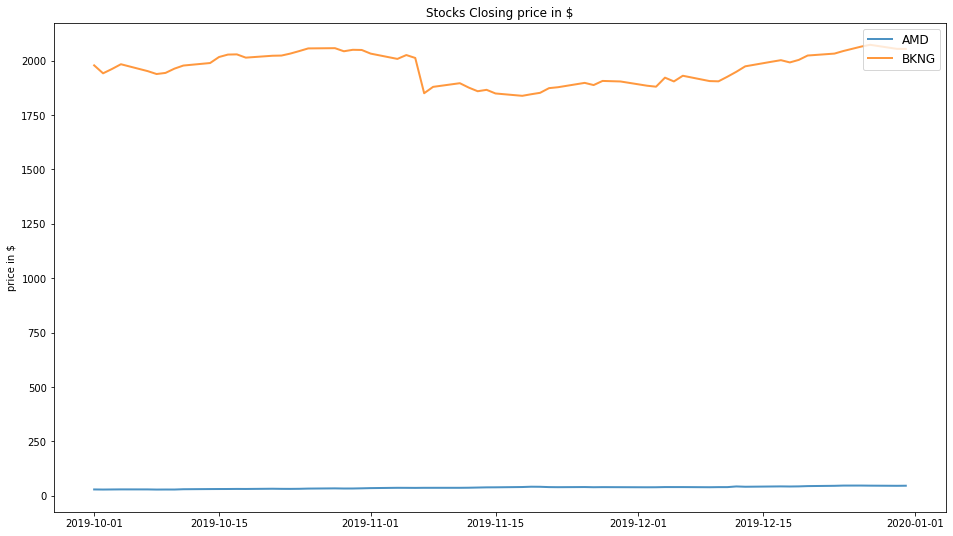

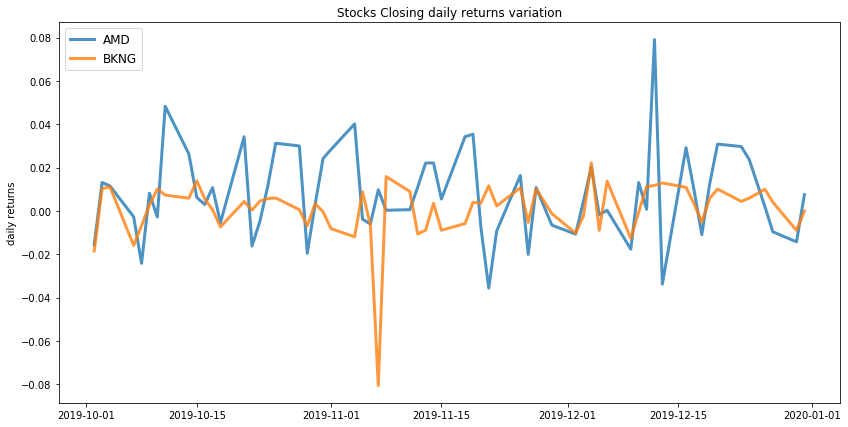

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.49
Annualised Volatility: 0.16


              AMD  BKNG
allocation  100.0   0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.17
Annualised Volatility: 0.1


              AMD   BKNG
allocation  27.92  72.08


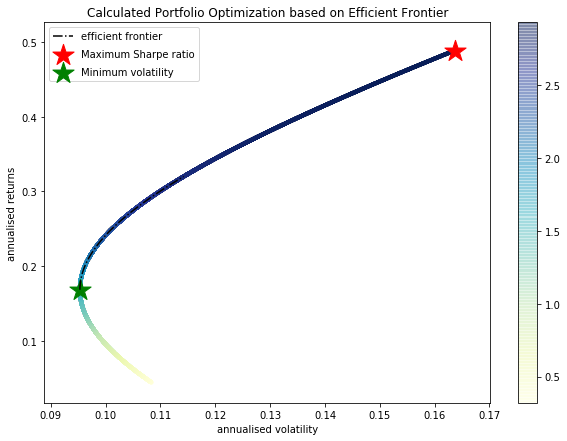

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMD : annuaised return 0.49 , annualised volatility: 0.16
BKNG : annuaised return 0.04 , annualised volatility: 0.11
--------------------------------------------------------------------------------


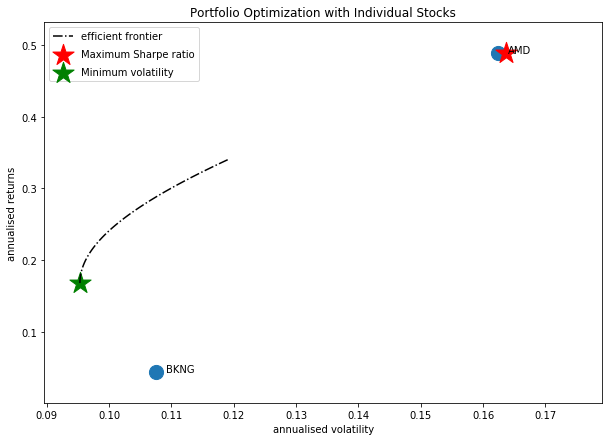

Companies listed in quarter 8 which is between 2020-01-01 and 2020-04-01
['AMZN' 'BIIB' 'EQIX' 'CTXS' 'AOS' 'ADBE' 'BA']
perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AMZN', 'AOS']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



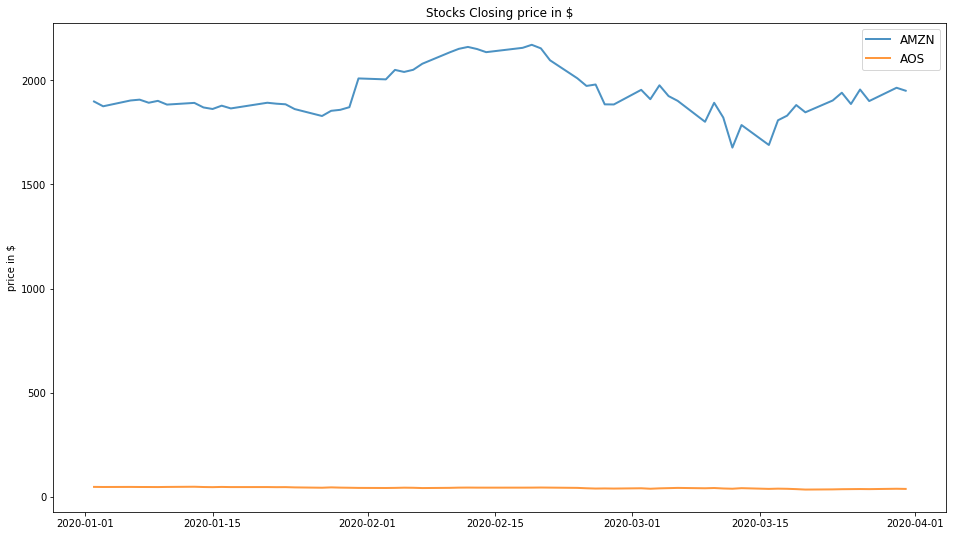

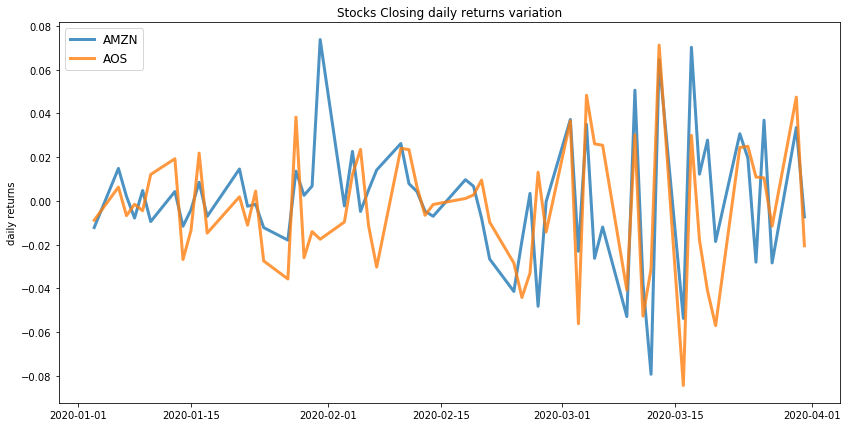

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.05
Annualised Volatility: 0.23


             AMZN  AOS
allocation  100.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: -0.07
Annualised Volatility: 0.2


             AMZN    AOS
allocation  51.38  48.62


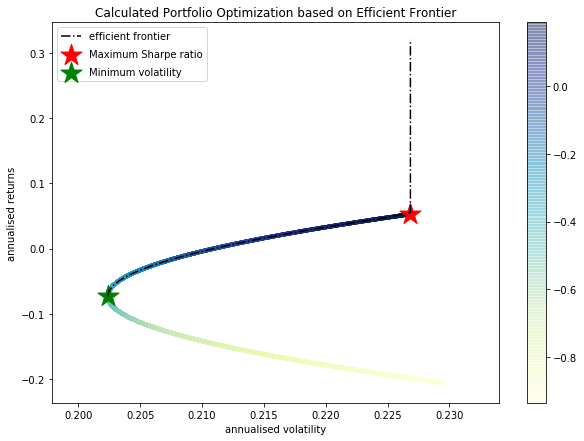

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMZN : annuaised return 0.05 , annualised volatility: 0.22
AOS : annuaised return -0.21 , annualised volatility: 0.23
--------------------------------------------------------------------------------


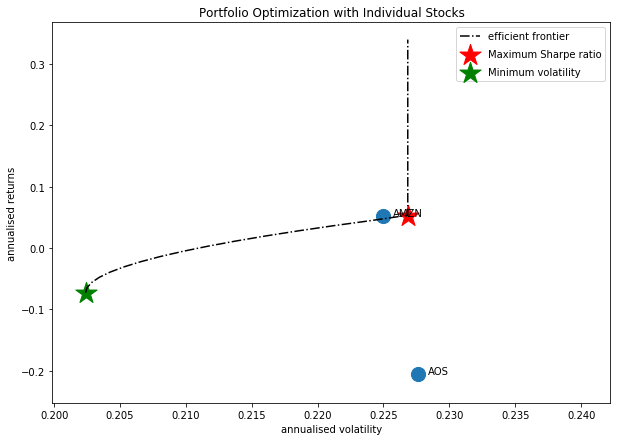

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BIIB', 'EQIX', 'AOS']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



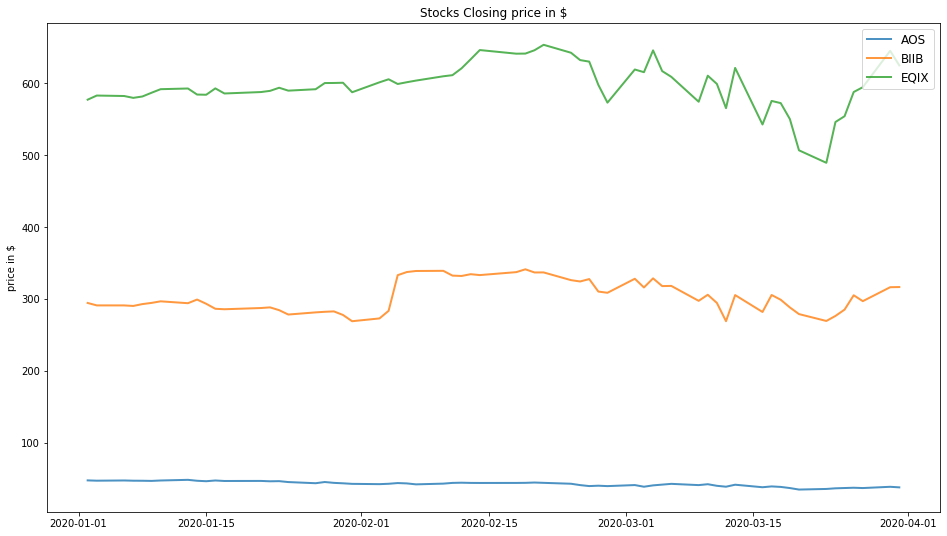

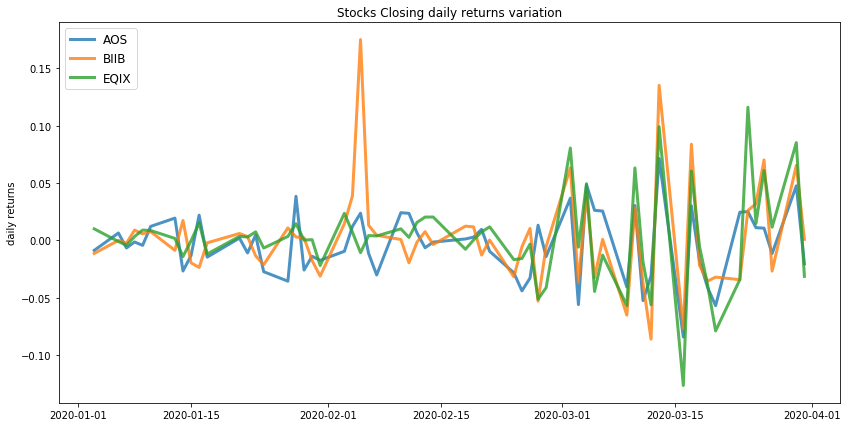

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.13
Annualised Volatility: 0.3


            AOS   BIIB   EQIX
allocation  0.0  37.45  62.55
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: -0.17
Annualised Volatility: 0.23


              AOS  BIIB  EQIX
allocation  89.32  7.82  2.86


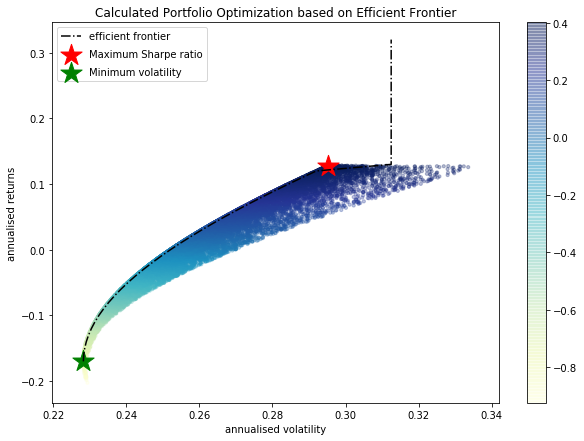

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AOS : annuaised return -0.21 , annualised volatility: 0.23
BIIB : annuaised return 0.13 , annualised volatility: 0.33
EQIX : annuaised return 0.13 , annualised volatility: 0.31
--------------------------------------------------------------------------------


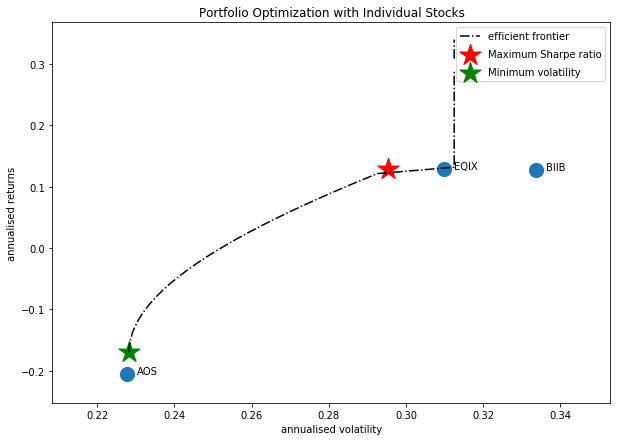

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BIIB', 'ADBE']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



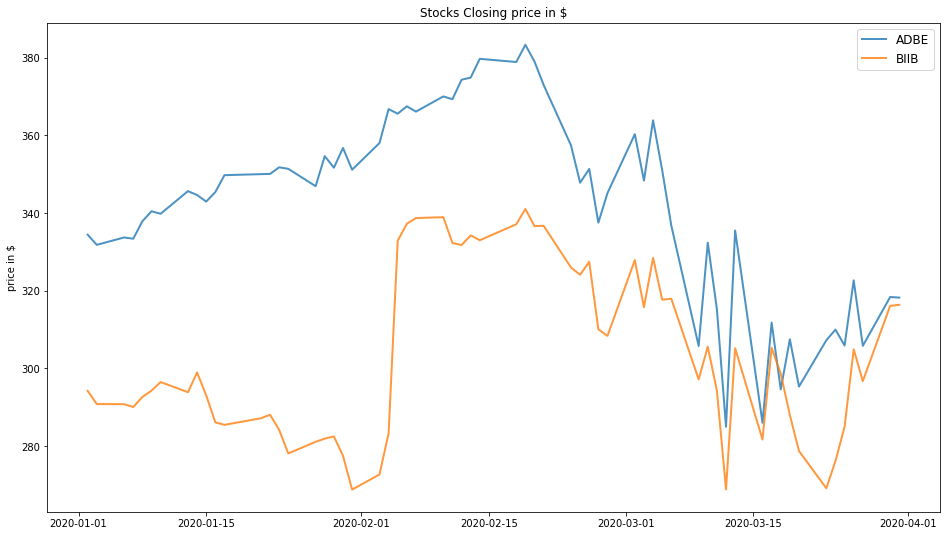

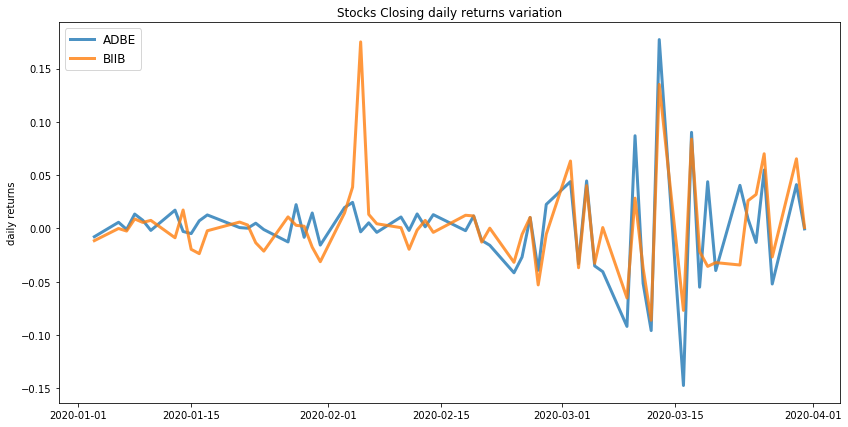

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.13
Annualised Volatility: 0.34


            ADBE   BIIB
allocation   0.0  100.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.08
Annualised Volatility: 0.32


             ADBE   BIIB
allocation  41.52  58.48


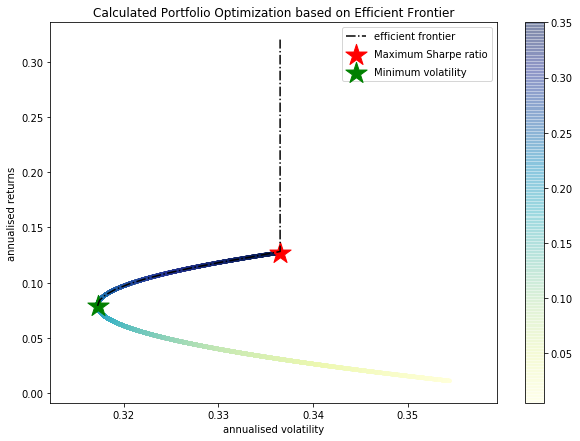

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

ADBE : annuaised return 0.01 , annualised volatility: 0.35
BIIB : annuaised return 0.13 , annualised volatility: 0.33
--------------------------------------------------------------------------------


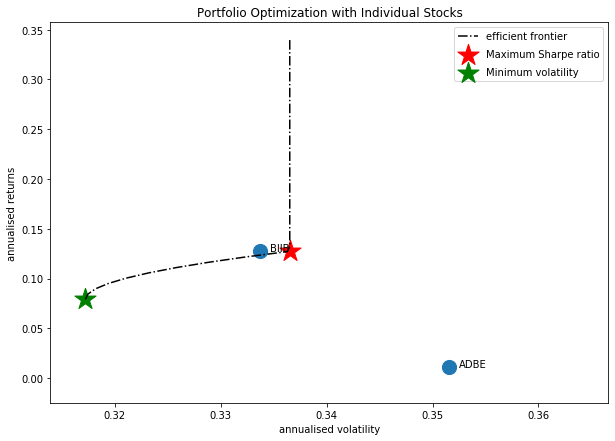

[[0.48191032767011616, 0.06, 0.11, ['EQIX', 'CAG'], array([[  0., 100.]]), '2018-04-01'], [1.7878336227575213, 0.23, 0.12, ['AMZN', 'CAG'], array([[100.,   0.]]), '2018-04-01'], [1.7878336227575213, 0.23, 0.12, ['AMZN', 'BKNG'], array([[100.,   0.]]), '2018-04-01'], [0.7175124288466208, 0.12, 0.15, ['CBS', 'CAG'], array([[  0., 100.]]), '2018-04-01'], [0.5221590659169628, 0.06, 0.1, ['GOOGL', 'BKNG'], array([[  0., 100.]]), '2018-07-01'], [0.5720921720594088, 0.1, 0.15, ['AZO', 'BAC'], array([[100.,   0.]]), '2018-10-01'], [0.5720921720594092, 0.1, 0.15, ['AZO', 'CMCSA'], array([[100.,   0.]]), '2018-10-01'], [0.5720921720594092, 0.1, 0.15, ['AZO', 'EQIX'], array([[100.,   0.]]), '2018-10-01'], [0.5720921720594091, 0.1, 0.15, ['AZO', 'BKNG'], array([[100.,   0.]]), '2018-10-01'], [1.2053003301930514, 0.21, 0.16, ['BKNG', 'AAPL'], array([[100.,   0.]]), '2019-01-01'], [1.4976895619345192, 0.59, 0.39, ['BKNG', 'COTY'], array([[  0., 100.]]), '2019-01-01'], [2.637171791765924, 0.26, 0.09,

In [15]:
quarter_list=["2018-04-01", "2018-07-01", "2018-10-01", "2019-01-01", "2019-04-01", "2019-07-01", "2019-10-01", "2020-01-01", "2020-04-01"]
## Taken from
# https://www.treasury.gov/resource-center/data-chart-center/interest-rates/Pages/TextView.aspx?data=billRatesYear&year=2018
# 13 weeks period, COUPON EQUIVALENT, based on last possible date of each quarter
risk_free_rates = [1.93, 2.19, 2.45, 2.40, 2.13, 1.88, 1.55, 0.03]

returns_sharpe_company_list = []
for idx in range(1, len(quarter_list)):
    df_quarter_data = new_df[(new_df["start_date"] >= quarter_list[idx-1]) & (new_df["start_date"]< quarter_list[idx])]
    print("Companies listed in quarter {} which is between {} and {}".format(idx, quarter_list[idx-1], quarter_list[idx]))
    list_of_companies = df_quarter_data["symbol"].unique()
    #generate the stocks pairs which are uncorrelated and having covariance less than mean covariance 
    stocks_pair = get_portfolio_pairs(list_of_companies)
    #print(stocks_pair)
    for stock_list in stocks_pair:
        print("perform efficient_frontier_stock_portfolio Pairs of the companies we got {}".format(stock_list))
        pos_sharpe, Annualised_Return, Annualised_Volatility, allocation_weights = efficient_frontier_stock_portfolio(stock_list, len(stock_list), risk_free_rates[idx-1], quarter_list[idx-1], quarter_list[idx])
        returns_sharpe_company_list.append([pos_sharpe, Annualised_Return, Annualised_Volatility, stock_list, allocation_weights, quarter_list[idx-1]])
print(returns_sharpe_company_list)

In [16]:
shortlisted_portfolio_df = pd.DataFrame(returns_sharpe_company_list)

In [17]:
shortlisted_portfolio_df.columns = ["Sharpe Ratio", "Portfolio Annualised Return", "Portfolio Annualised_Volatility", "Stock Portfolio", "Stocks Weight Allocation", "Quarter Start Date"]

### we know that higher the sharpe ratio value the stocks have a good returns with consideration of the risk in  the investment and for the portfolio we tag quantitative values such as below for the portfolio generated:

#### Sharpe Ratio >=  3 ---> "Excellent Portfolio"

#### Sharpe Ratio >=  2 ---> "Very Good Portfolio"

#### Sharpe Ratio >= 1 ---> "Good Portfolio"

#### Sharpe Ratio < 1 ---> "Bad Portfolio"

In [18]:
# creating a blank series 
Portfolio_Tag = pd.Series([]) 

for row in range(len(shortlisted_portfolio_df)):
    if (shortlisted_portfolio_df["Sharpe Ratio"][row] >= 3):
        Portfolio_Tag[row] = "Excellent"
    elif (shortlisted_portfolio_df["Sharpe Ratio"][row] >= 2 and (shortlisted_portfolio_df["Sharpe Ratio"][row] < 3)):
        Portfolio_Tag[row] = "Very Good"
    elif ((shortlisted_portfolio_df["Sharpe Ratio"][row] >= 1)  and (shortlisted_portfolio_df["Sharpe Ratio"][row] < 2)):
        Portfolio_Tag[row] = "Good"
    else:
        Portfolio_Tag[row] = "Bad"
        
# inserting new column with values of list made above         
shortlisted_portfolio_df.insert(5, "Portfolio Tag", Portfolio_Tag) 

/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:2: DeprecationWarning:

The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.



## Possible combinations of the company from which we will take the final Portfolio list

In [19]:
shortlisted_portfolio_df

,Sharpe Ratio,Portfolio Annualised Return,Portfolio Annualised_Volatility,Stock Portfolio,Stocks Weight Allocation,Portfolio Tag,Quarter Start Date
0,0.481910,0.06,0.11,"[EQIX, CAG]","[[0.0, 100.0]]",Bad,2018-04-01
1,1.787834,0.23,0.12,"[AMZN, CAG]","[[100.0, 0.0]]",Good,2018-04-01
2,1.787834,0.23,0.12,"[AMZN, BKNG]","[[100.0, 0.0]]",Good,2018-04-01
3,0.717512,0.12,0.15,"[CBS, CAG]","[[0.0, 100.0]]",Bad,2018-04-01
4,0.522159,0.06,0.10,"[GOOGL, BKNG]","[[0.0, 100.0]]",Bad,2018-07-01
5,0.572092,0.10,0.15,"[AZO, BAC]","[[100.0, 0.0]]",Bad,2018-10-01
6,0.572092,0.10,0.15,"[AZO, CMCSA]","[[100.0, 0.0]]",Bad,2018-10-01
7,0.572092,0.10,0.15,"[AZO, EQIX]","[[100.0, 0.0]]",Bad,2018-10-01
8,0.572092,0.10,0.15,"[AZO, BKNG]","[[100.0, 0.0]]",Bad,2018-10-01
9,1.205300,0.21,0.16,"[BKNG, AAPL]","[[100.0, 0.0]]",Good,2019-01-01


In [20]:
shortlisted_portfolio = shortlisted_portfolio_df[(shortlisted_portfolio_df["Portfolio Tag"] == "Excellent") | (shortlisted_portfolio_df["Portfolio Tag"] == "Very Good") |
                                                    (shortlisted_portfolio_df["Portfolio Tag"] == "Good")]

In [21]:
shortlisted_portfolio = shortlisted_portfolio.sort_values(by="Sharpe Ratio", ascending=False)

In [22]:
shortlisted_portfolio

,Sharpe Ratio,Portfolio Annualised Return,Portfolio Annualised_Volatility,Stock Portfolio,Stocks Weight Allocation,Portfolio Tag,Quarter Start Date
23,2.928643,0.49,0.16,"[BKNG, AMD]","[[100.0, 0.0]]",Very Good,2019-10-01
11,2.637172,0.26,0.09,"[BKNG, KMI]","[[0.0, 100.0]]",Very Good,2019-01-01
21,2.009201,0.18,0.09,"[EFX, BLK, BIIB]","[[15.11, 84.89, 0.0]]",Very Good,2019-10-01
1,1.787834,0.23,0.12,"[AMZN, CAG]","[[100.0, 0.0]]",Good,2018-04-01
2,1.787834,0.23,0.12,"[AMZN, BKNG]","[[100.0, 0.0]]",Good,2018-04-01
19,1.721227,0.20,0.11,"[AJG, DHI]","[[0.0, 100.0]]",Good,2019-07-01
13,1.659488,0.34,0.20,"[AMZN, COTY]","[[58.37, 41.63]]",Good,2019-01-01
16,1.509432,0.23,0.14,"[ESS, BKNG, BIIB, APC, CPB]","[[36.88, 0.0, 35.56, 27.56, 0.0]]",Good,2019-04-01
10,1.497690,0.59,0.39,"[BKNG, COTY]","[[0.0, 100.0]]",Good,2019-01-01
15,1.461092,0.24,0.15,"[ESS, BKNG, BIIB, APC]","[[40.96, 0.0, 41.96, 17.08]]",Good,2019-04-01


# Top 5 stock portfolios to be taken from the data (User to choose)

In [23]:
shortlisted_portfolio[:5]

,Sharpe Ratio,Portfolio Annualised Return,Portfolio Annualised_Volatility,Stock Portfolio,Stocks Weight Allocation,Portfolio Tag,Quarter Start Date
23,2.928643,0.49,0.16,"[BKNG, AMD]","[[100.0, 0.0]]",Very Good,2019-10-01
11,2.637172,0.26,0.09,"[BKNG, KMI]","[[0.0, 100.0]]",Very Good,2019-01-01
21,2.009201,0.18,0.09,"[EFX, BLK, BIIB]","[[15.11, 84.89, 0.0]]",Very Good,2019-10-01
1,1.787834,0.23,0.12,"[AMZN, CAG]","[[100.0, 0.0]]",Good,2018-04-01
2,1.787834,0.23,0.12,"[AMZN, BKNG]","[[100.0, 0.0]]",Good,2018-04-01


## portfolio generated quarterwise from 2018 - 2020

In [24]:
shortlisted_portfolio_quarterwise_max_df = shortlisted_portfolio_df.groupby("Quarter Start Date")["Sharpe Ratio"].max().reset_index()

In [25]:
portfolio_quarterwise_max = pd.merge(left=shortlisted_portfolio_quarterwise_max_df, right=shortlisted_portfolio_df,left_on='Sharpe Ratio', right_on='Sharpe Ratio').drop(["Quarter Start Date_y"], axis=1)

In [47]:
portfolio_quarterwise_max

,Quarter Start Date_x,Sharpe Ratio,Portfolio Annualised Return,Portfolio Annualised_Volatility,Stock Portfolio,Stocks Weight Allocation,Portfolio Tag
0,2018-04-01,1.787834,0.23,0.12,"[AMZN, CAG]","[[100.0, 0.0]]",Good
1,2018-04-01,1.787834,0.23,0.12,"[AMZN, BKNG]","[[100.0, 0.0]]",Good
2,2018-07-01,0.522159,0.06,0.10,"[GOOGL, BKNG]","[[0.0, 100.0]]",Bad
3,2018-10-01,0.572092,0.10,0.15,"[AZO, CMCSA]","[[100.0, 0.0]]",Bad
4,2018-10-01,0.572092,0.10,0.15,"[AZO, EQIX]","[[100.0, 0.0]]",Bad
5,2019-01-01,2.637172,0.26,0.09,"[BKNG, KMI]","[[0.0, 100.0]]",Very Good
6,2019-04-01,1.509432,0.23,0.14,"[ESS, BKNG, BIIB, APC, CPB]","[[36.88, 0.0, 35.56, 27.56, 0.0]]",Good
7,2019-07-01,1.721227,0.20,0.11,"[AJG, DHI]","[[0.0, 100.0]]",Good
8,2019-10-01,2.928643,0.49,0.16,"[BKNG, AMD]","[[100.0, 0.0]]",Very Good
9,2020-01-01,0.401801,0.13,0.30,"[BIIB, EQIX, AOS]","[[0.0, 37.45, 62.55]]",Bad


## portfolio generated for the shortlisted companies for overall 2 yr period

In [27]:
portfolio_list

array(['EQIX', 'AMZN', 'GOOGL', 'GOOG', 'AZO', 'BKNG', 'NEE', 'ESS',
       'AJG', 'EFX', 'BLK', 'BIIB', 'AAPL', 'CBS', 'AMD', 'CAG', 'MRO',
       'NEM', 'BAC', 'CMCSA', 'HP', 'COTY', 'KMI', 'EXC', 'APC', 'CPB',
       'EMR', 'MLM', 'DHI', 'AOS', 'CTXS', 'ALGN', 'BA', 'ADBE'],
      dtype=object)

['EQIX' 'AMZN' 'GOOGL' 'GOOG' 'AZO' 'BKNG' 'NEE' 'ESS' 'AJG' 'EFX' 'BLK'
 'BIIB' 'AAPL' 'CBS' 'AMD' 'CAG' 'MRO' 'NEM' 'BAC' 'CMCSA' 'HP' 'COTY'
 'KMI' 'EXC' 'APC' 'CPB' 'EMR' 'MLM' 'DHI' 'AOS' 'CTXS' 'ALGN' 'BA' 'ADBE']
perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'ESS', 'AMD', 'CAG', 'BAC']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



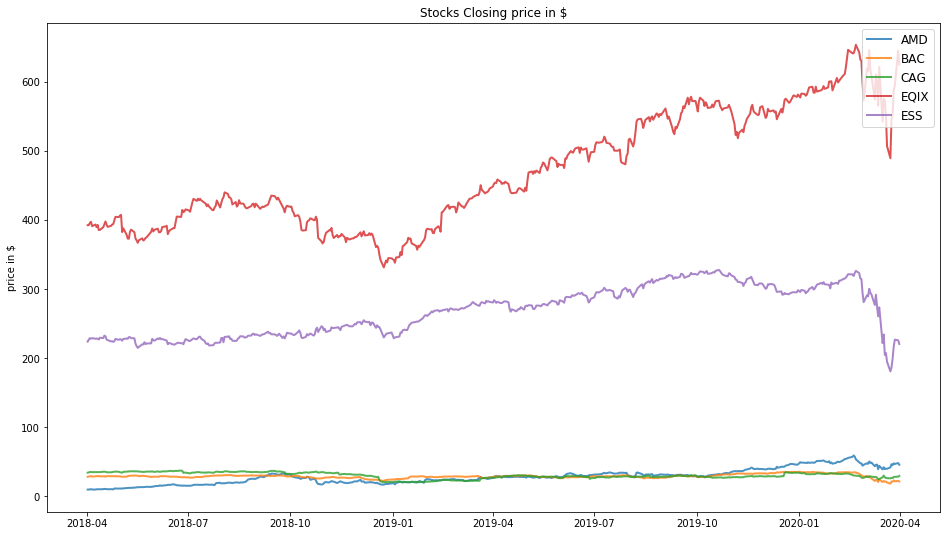

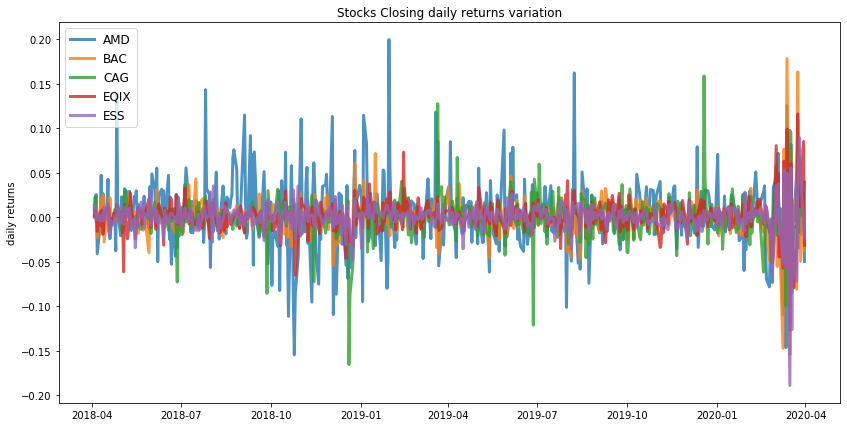

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.43
Annualised Volatility: 0.63


             AMD  BAC  CAG  EQIX  ESS
allocation  62.5  0.0  0.0  37.5  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.16
Annualised Volatility: 0.33


             AMD    BAC    CAG   EQIX    ESS
allocation  0.56  10.36  25.71  24.24  39.13


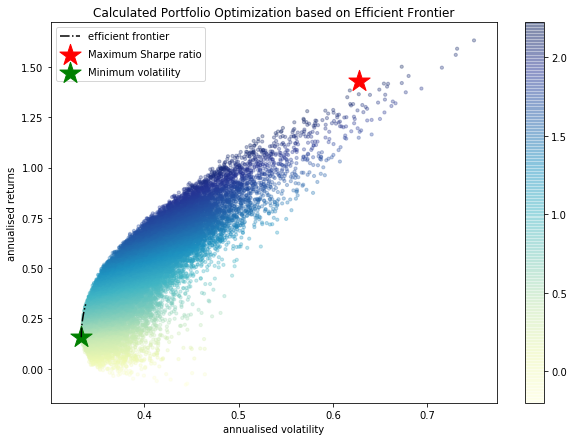

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMD : annuaised return 1.96 , annualised volatility: 0.88
BAC : annuaised return -0.14 , annualised volatility: 0.52
CAG : annuaised return -0.0 , annualised volatility: 0.53
EQIX : annuaised return 0.56 , annualised volatility: 0.42
ESS : annuaised return 0.07 , annualised volatility: 0.4
--------------------------------------------------------------------------------


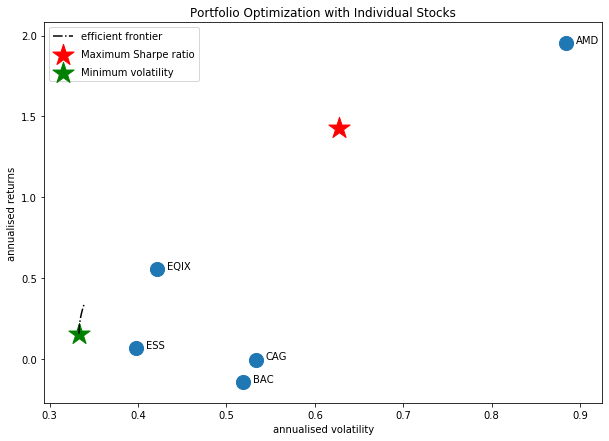

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'ESS', 'AJG', 'BIIB', 'AMD', 'CAG', 'MRO', 'BAC']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



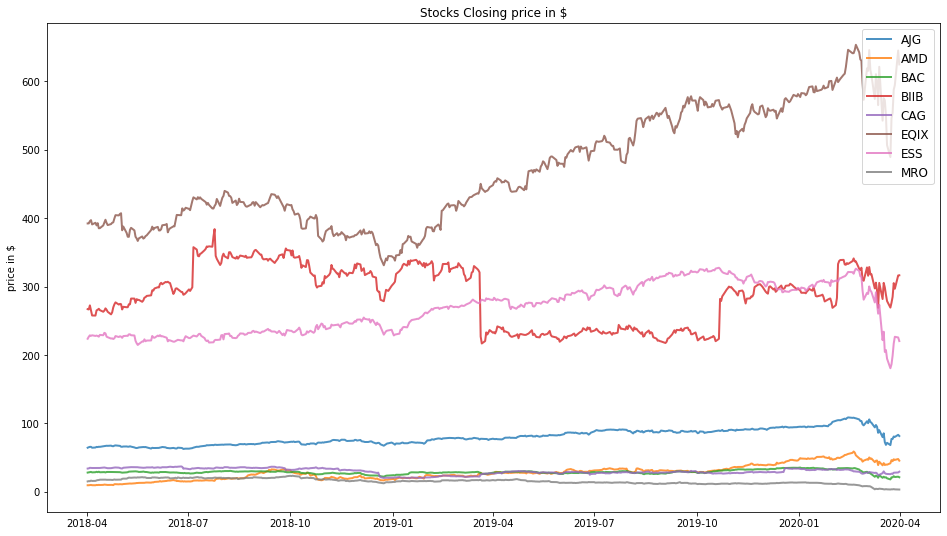

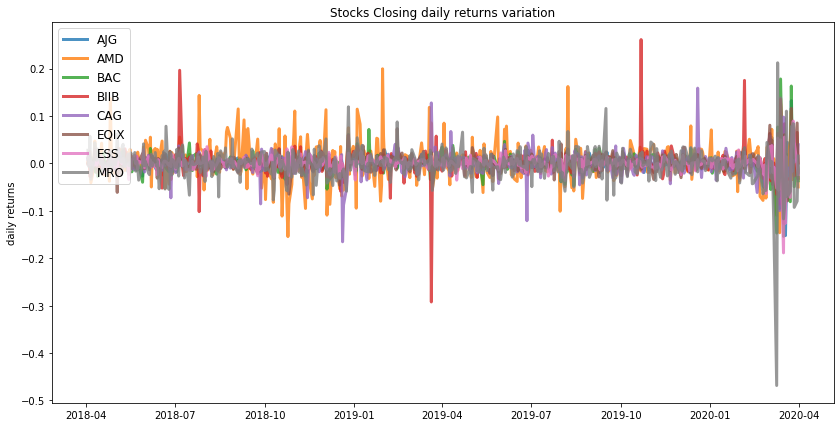

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.42
Annualised Volatility: 0.62


            AJG    AMD  BAC  BIIB  CAG   EQIX  ESS  MRO
allocation  0.0  62.12  0.0  0.93  0.0  36.96  0.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.21
Annualised Volatility: 0.32


             AJG  AMD  BAC   BIIB    CAG   EQIX    ESS  MRO
allocation  25.6  0.0  0.0  10.89  21.06  14.87  26.39  1.2


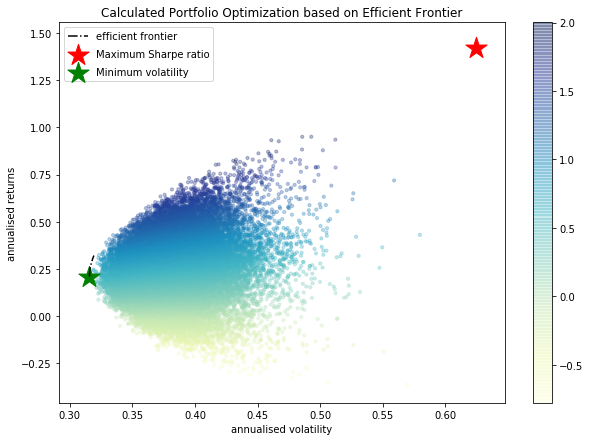

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AJG : annuaised return 0.31 , annualised volatility: 0.38
AMD : annuaised return 1.96 , annualised volatility: 0.88
BAC : annuaised return -0.14 , annualised volatility: 0.52
BIIB : annuaised return 0.39 , annualised volatility: 0.65
CAG : annuaised return -0.0 , annualised volatility: 0.53
EQIX : annuaised return 0.56 , annualised volatility: 0.42
ESS : annuaised return 0.07 , annualised volatility: 0.4
MRO : annuaised return -1.12 , annualised volatility: 0.84
--------------------------------------------------------------------------------


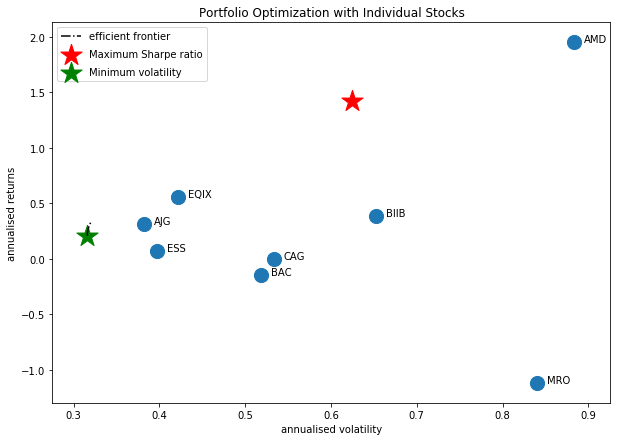

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'ESS', 'BIIB', 'AMD', 'MRO', 'HP']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



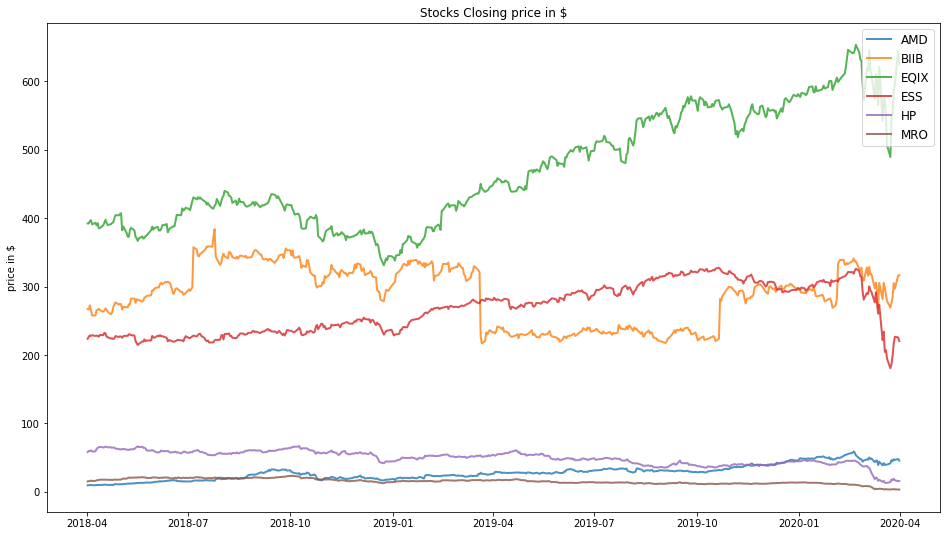

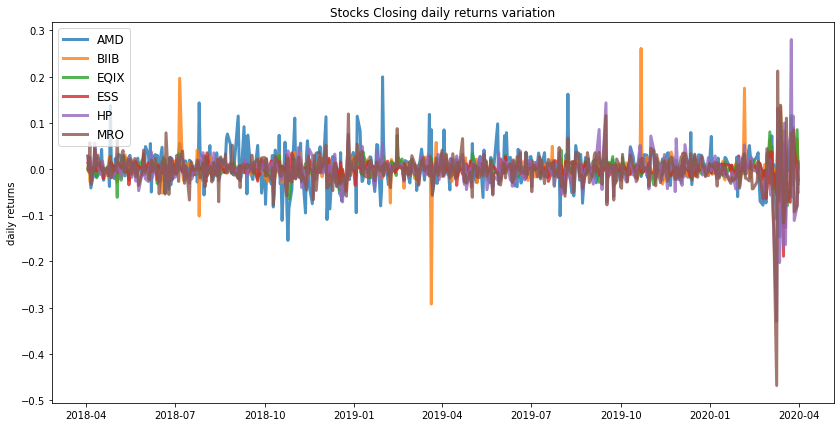

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.42
Annualised Volatility: 0.62


              AMD  BIIB   EQIX  ESS   HP  MRO
allocation  62.14  0.85  37.01  0.0  0.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.27
Annualised Volatility: 0.35


             AMD  BIIB   EQIX    ESS   HP  MRO
allocation  2.57  14.0  30.31  49.73  0.0  3.4


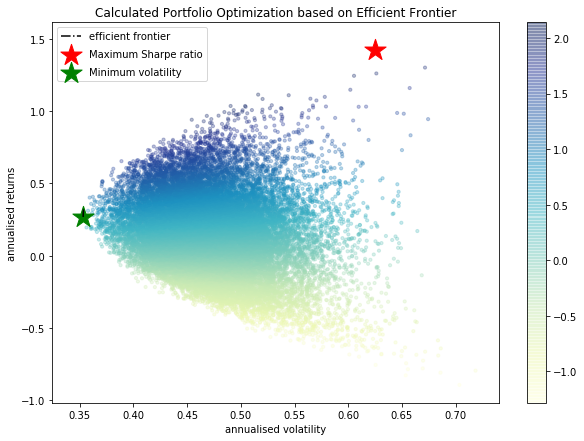

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMD : annuaised return 1.96 , annualised volatility: 0.88
BIIB : annuaised return 0.39 , annualised volatility: 0.65
EQIX : annuaised return 0.56 , annualised volatility: 0.42
ESS : annuaised return 0.07 , annualised volatility: 0.4
HP : annuaised return -0.97 , annualised volatility: 0.81
MRO : annuaised return -1.12 , annualised volatility: 0.84
--------------------------------------------------------------------------------


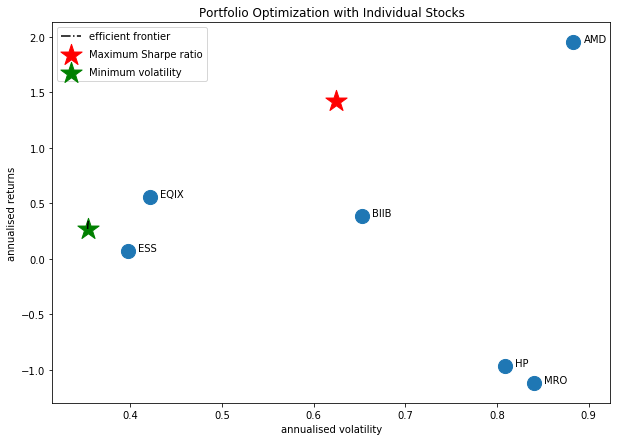

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'ADBE']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



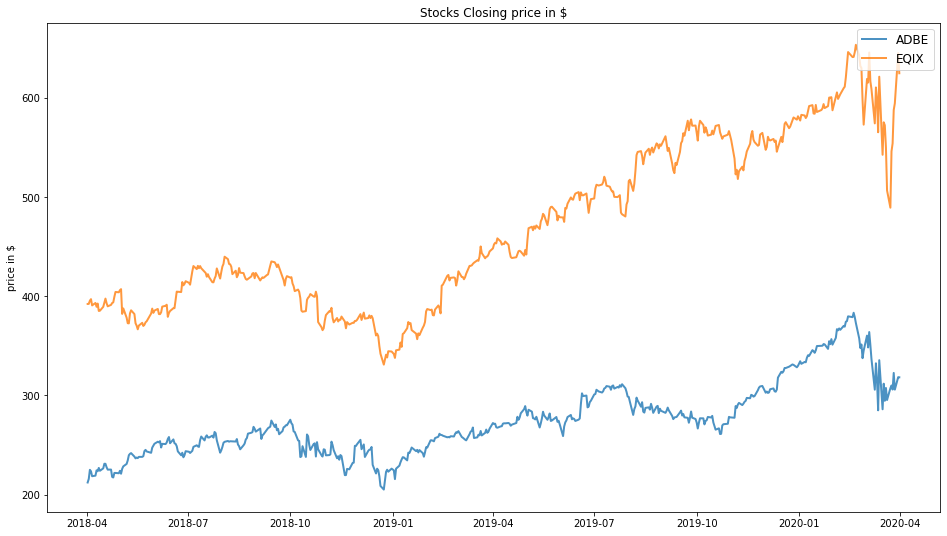

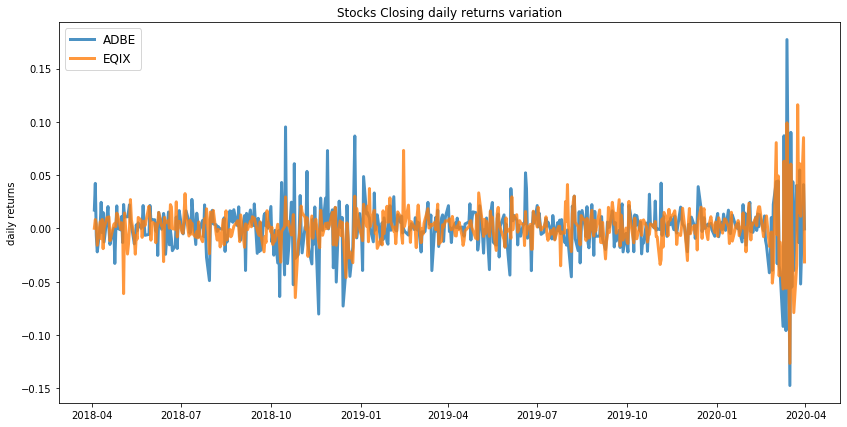

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.55
Annualised Volatility: 0.4


            ADBE  EQIX
allocation  27.2  72.8
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.55
Annualised Volatility: 0.4


             ADBE   EQIX
allocation  28.52  71.48


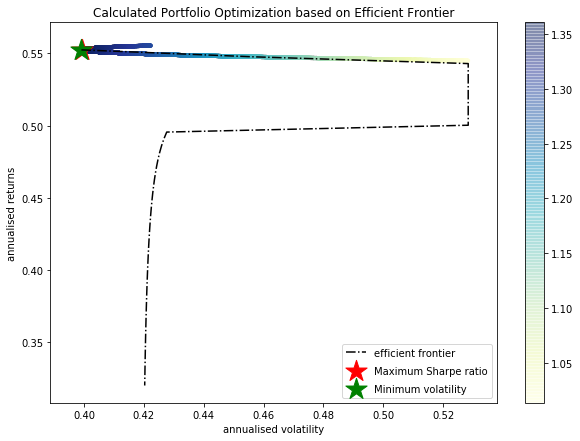

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

ADBE : annuaised return 0.55 , annualised volatility: 0.53
EQIX : annuaised return 0.56 , annualised volatility: 0.42
--------------------------------------------------------------------------------


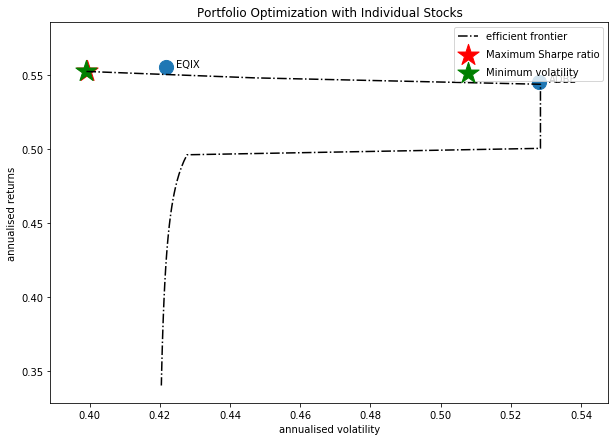

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AMZN', 'ESS', 'AMD', 'CAG', 'BAC']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



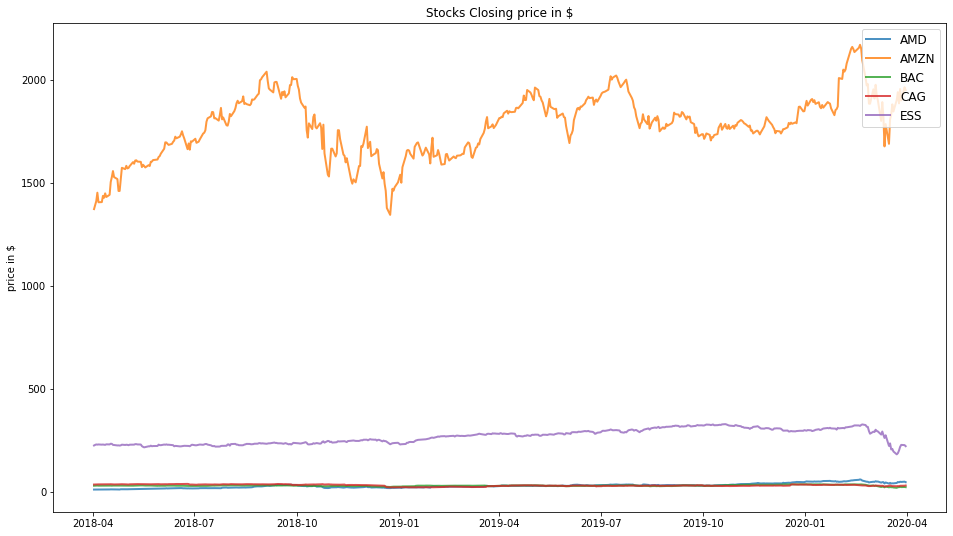

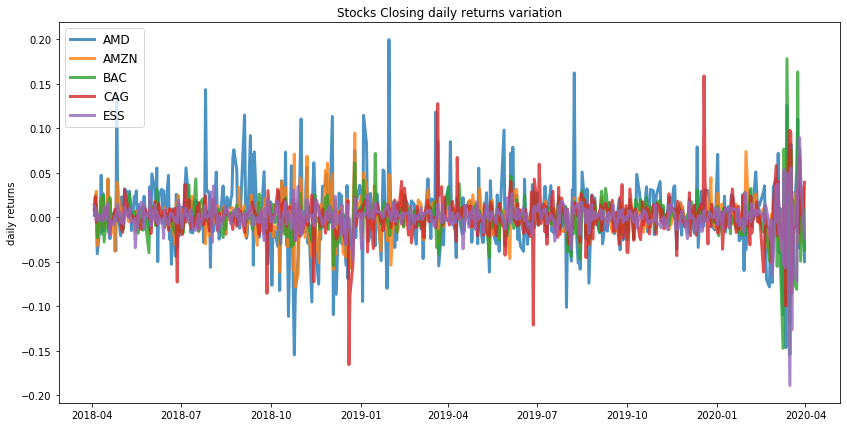

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.96
Annualised Volatility: 0.88


              AMD  AMZN  BAC  CAG  ESS
allocation  100.0   0.0  0.0  0.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.18
Annualised Volatility: 0.31


            AMD   AMZN  BAC    CAG    ESS
allocation  0.0  32.45  0.0  22.17  45.38


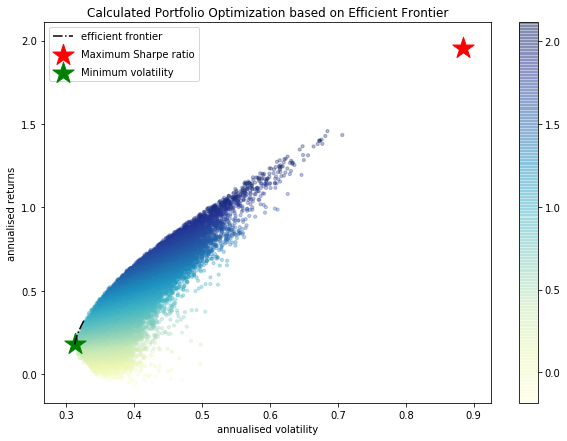

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMD : annuaised return 1.96 , annualised volatility: 0.88
AMZN : annuaised return 0.46 , annualised volatility: 0.45
BAC : annuaised return -0.14 , annualised volatility: 0.52
CAG : annuaised return -0.0 , annualised volatility: 0.53
ESS : annuaised return 0.07 , annualised volatility: 0.4
--------------------------------------------------------------------------------


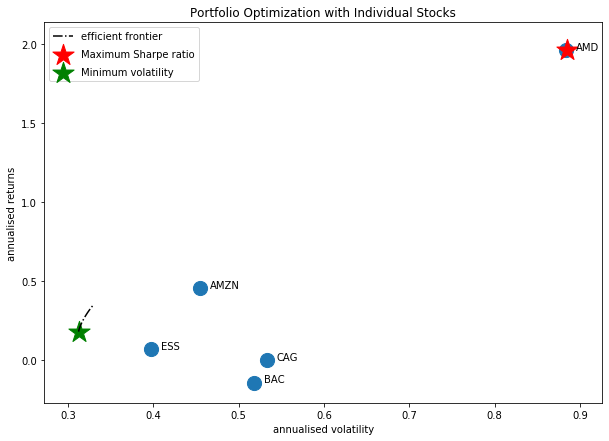

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AMZN', 'ESS', 'AJG', 'BIIB', 'AMD', 'CAG', 'MRO', 'BAC']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



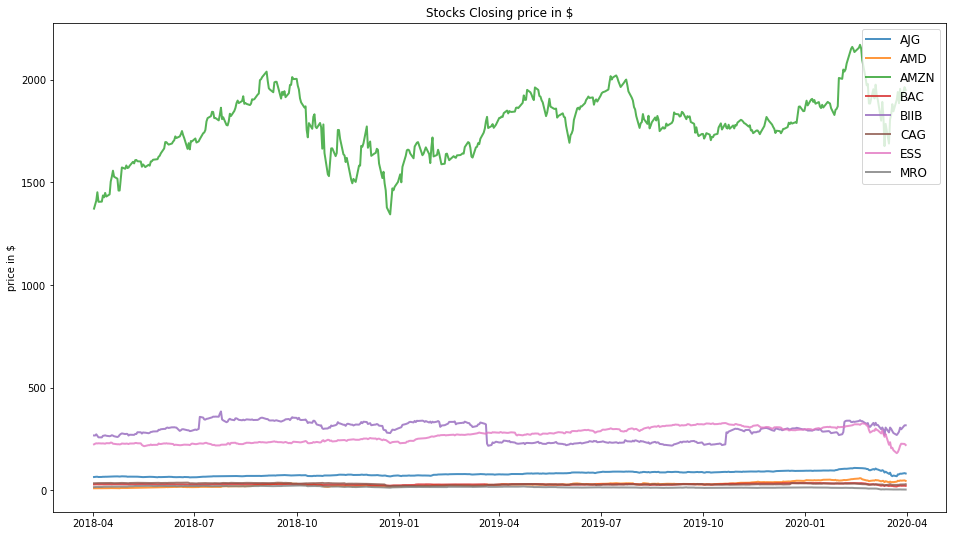

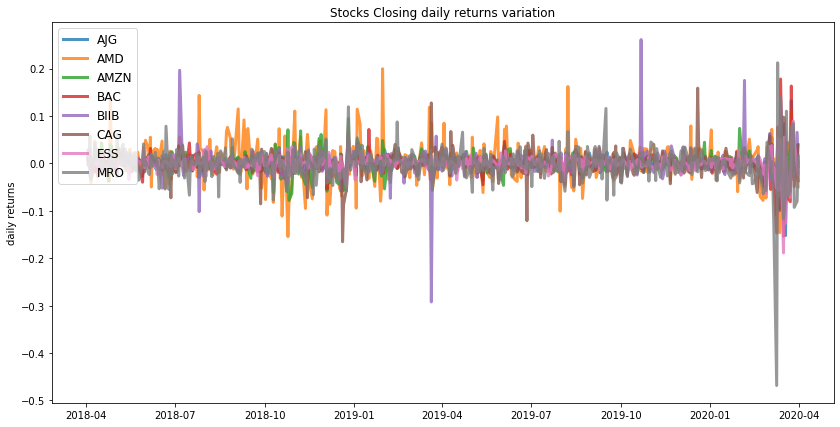

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.82
Annualised Volatility: 0.82


            AJG    AMD  AMZN  BAC  BIIB  CAG  ESS  MRO
allocation  0.0  91.18   0.0  0.0  8.82  0.0  0.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.22
Annualised Volatility: 0.3


              AJG  AMD  AMZN  BAC  BIIB    CAG    ESS  MRO
allocation  18.14  0.0  23.8  0.0  7.92  19.15  30.99  0.0


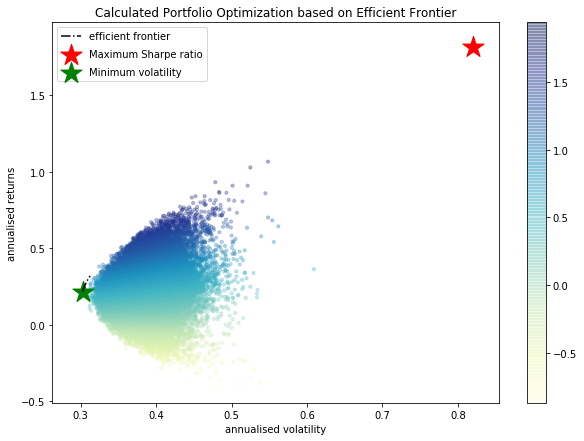

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AJG : annuaised return 0.31 , annualised volatility: 0.38
AMD : annuaised return 1.96 , annualised volatility: 0.88
AMZN : annuaised return 0.46 , annualised volatility: 0.45
BAC : annuaised return -0.14 , annualised volatility: 0.52
BIIB : annuaised return 0.39 , annualised volatility: 0.65
CAG : annuaised return -0.0 , annualised volatility: 0.53
ESS : annuaised return 0.07 , annualised volatility: 0.4
MRO : annuaised return -1.12 , annualised volatility: 0.84
--------------------------------------------------------------------------------


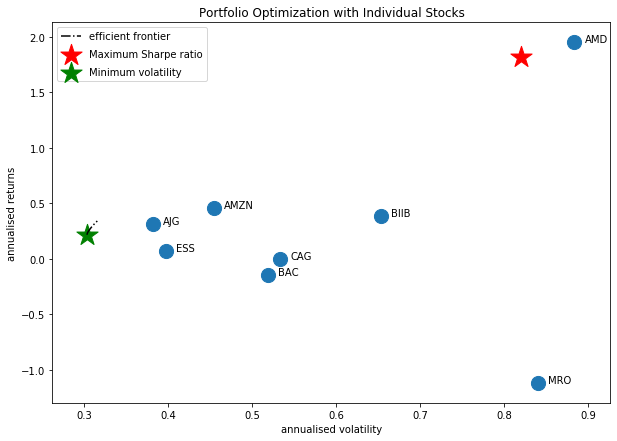

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AMZN', 'AOS']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



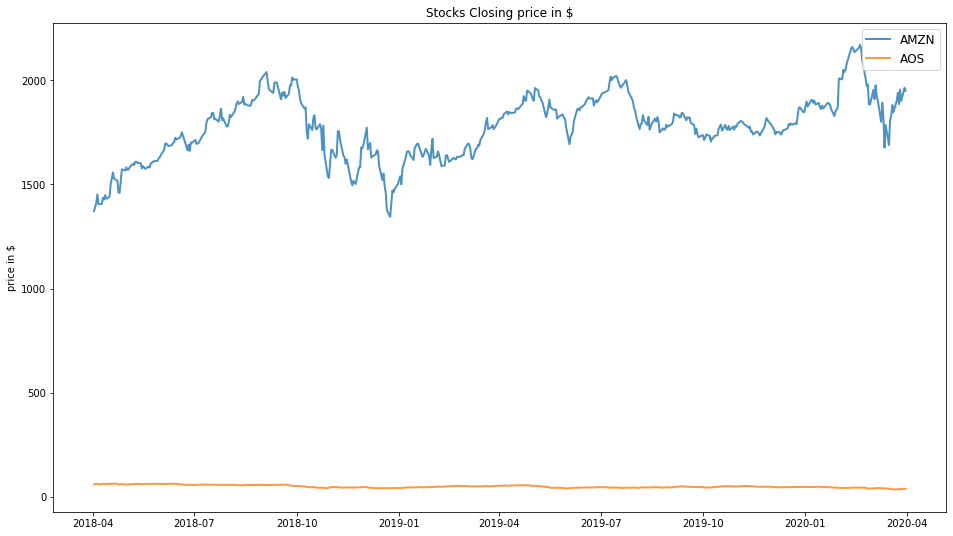

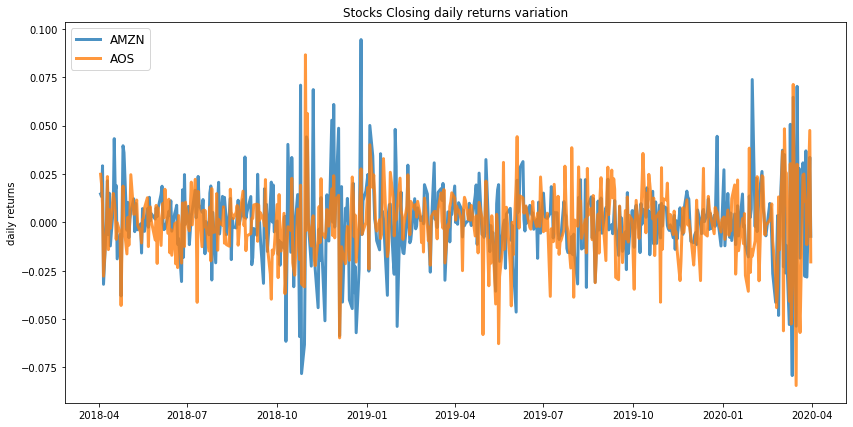

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.46
Annualised Volatility: 0.46


             AMZN  AOS
allocation  100.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: -0.03
Annualised Volatility: 0.36


             AMZN    AOS
allocation  40.63  59.37


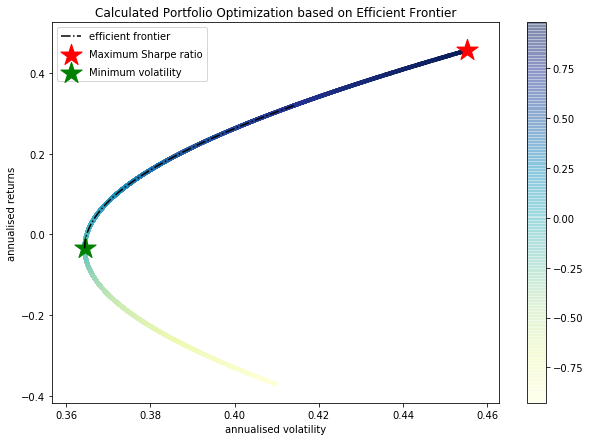

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMZN : annuaised return 0.46 , annualised volatility: 0.45
AOS : annuaised return -0.37 , annualised volatility: 0.41
--------------------------------------------------------------------------------


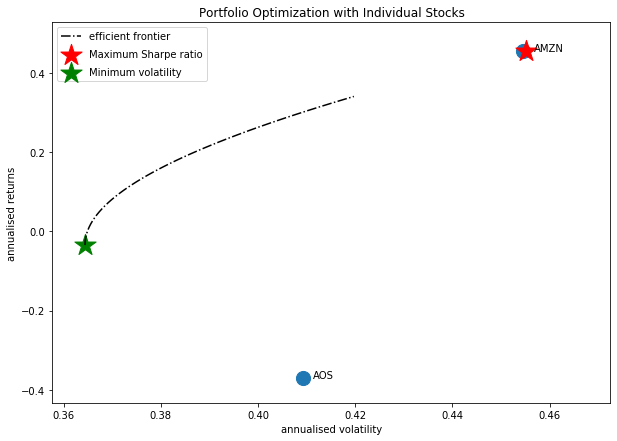

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BA', 'AMZN']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



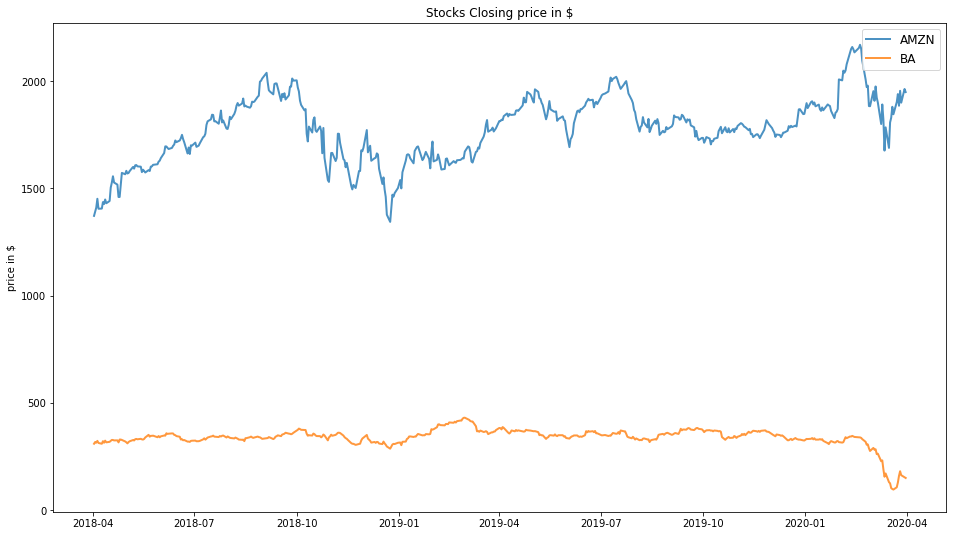

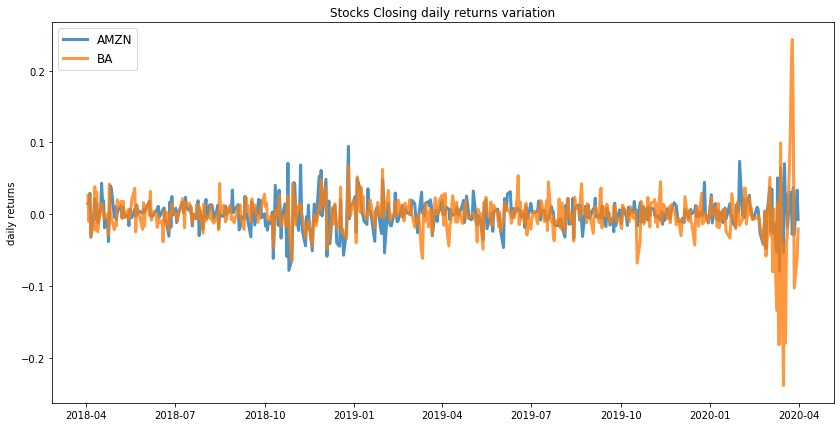

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.46
Annualised Volatility: 0.46


             AMZN   BA
allocation  100.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.3
Annualised Volatility: 0.44


            AMZN    BA
allocation  83.4  16.6


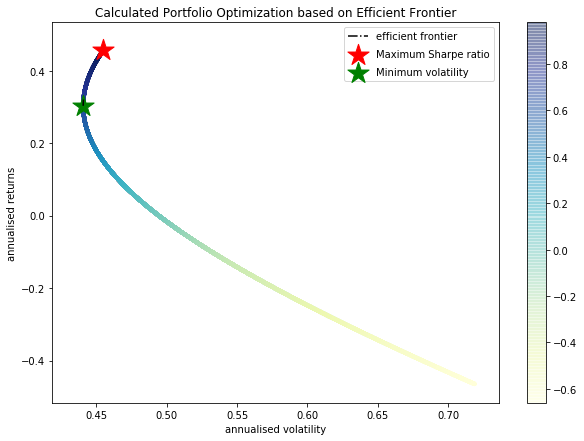

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMZN : annuaised return 0.46 , annualised volatility: 0.45
BA : annuaised return -0.47 , annualised volatility: 0.72
--------------------------------------------------------------------------------


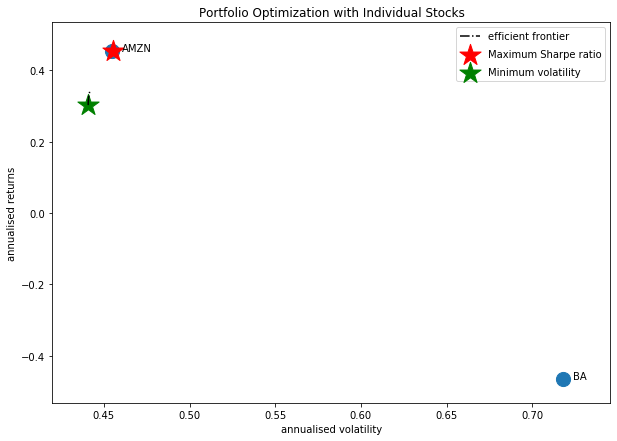

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['GOOGL', 'BKNG', 'AJG', 'BIIB', 'AMD', 'CAG', 'MRO', 'BAC']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



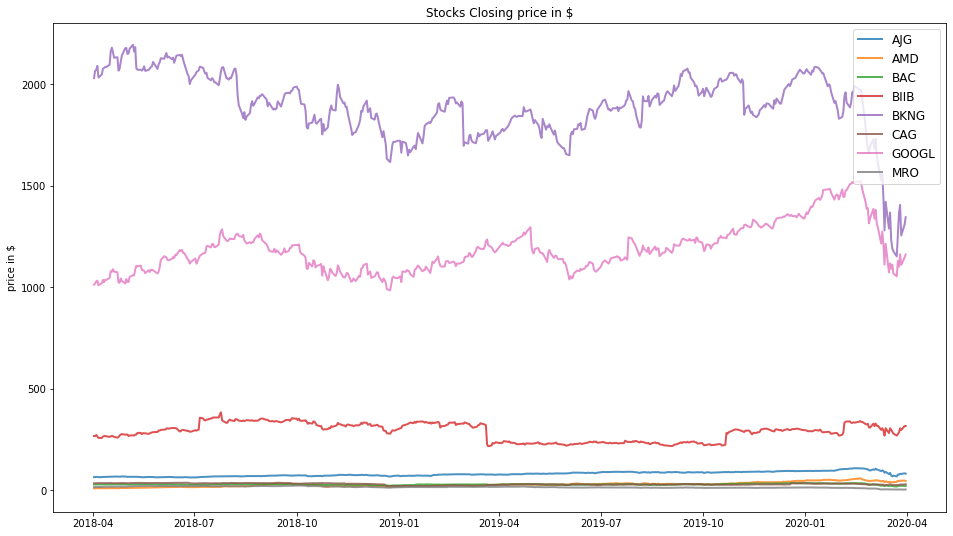

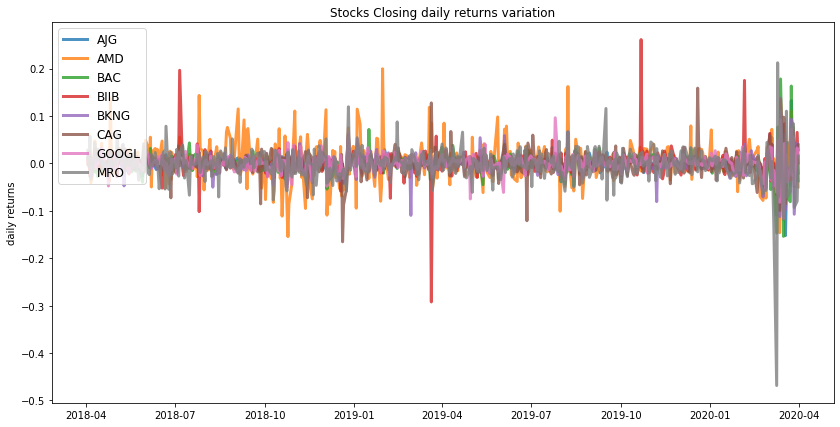

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.82
Annualised Volatility: 0.82


            AJG    AMD  BAC  BIIB  BKNG  CAG  GOOGL  MRO
allocation  0.0  91.18  0.0  8.82   0.0  0.0    0.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.2
Annualised Volatility: 0.32


              AJG  AMD  BAC   BIIB  BKNG    CAG  GOOGL  MRO
allocation  37.43  0.0  0.0  10.14  3.98  22.93  25.53  0.0


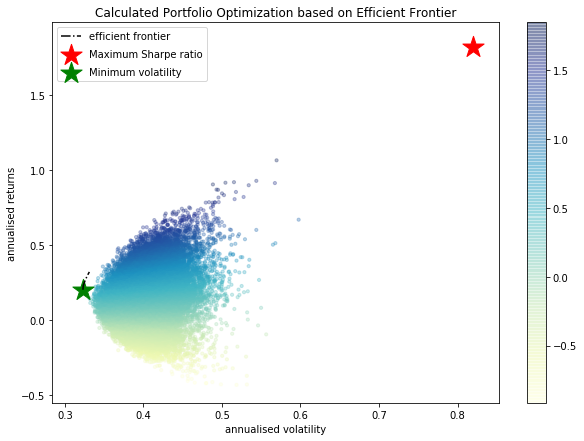

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AJG : annuaised return 0.31 , annualised volatility: 0.38
AMD : annuaised return 1.96 , annualised volatility: 0.88
BAC : annuaised return -0.14 , annualised volatility: 0.52
BIIB : annuaised return 0.39 , annualised volatility: 0.65
BKNG : annuaised return -0.3 , annualised volatility: 0.47
CAG : annuaised return -0.0 , annualised volatility: 0.53
GOOGL : annuaised return 0.23 , annualised volatility: 0.43
MRO : annuaised return -1.12 , annualised volatility: 0.84
--------------------------------------------------------------------------------


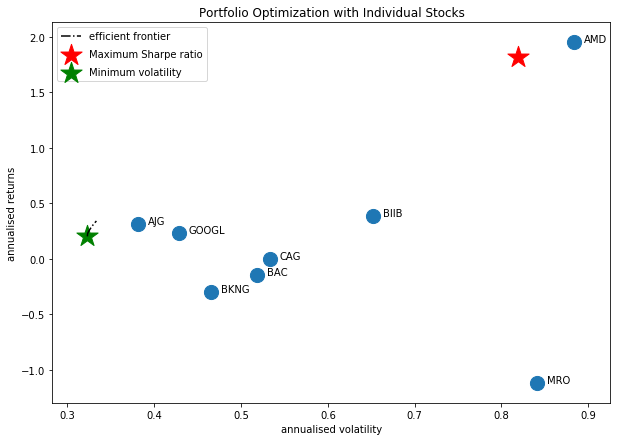

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['GOOGL', 'NEE', 'ESS', 'AJG', 'BIIB', 'AMD', 'CAG', 'MRO', 'BAC', 'CMCSA']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



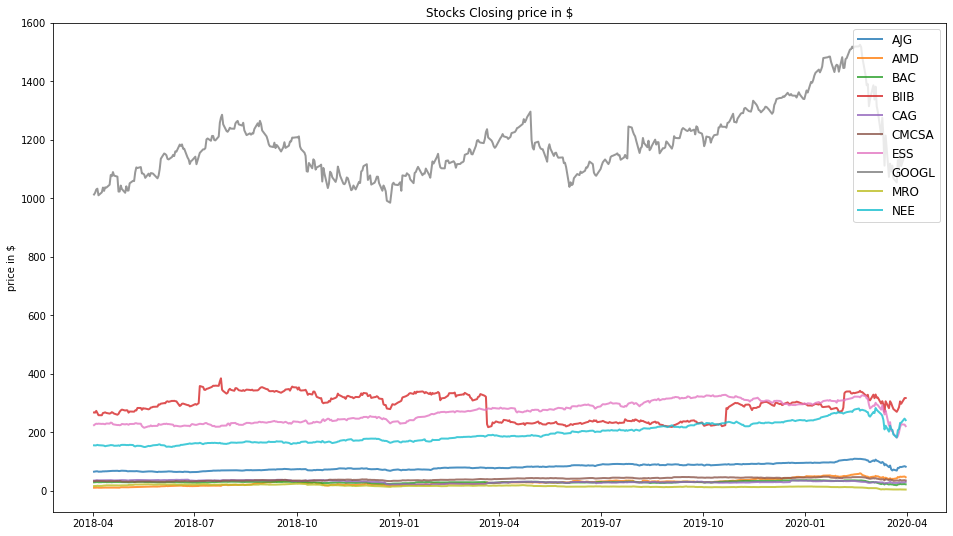

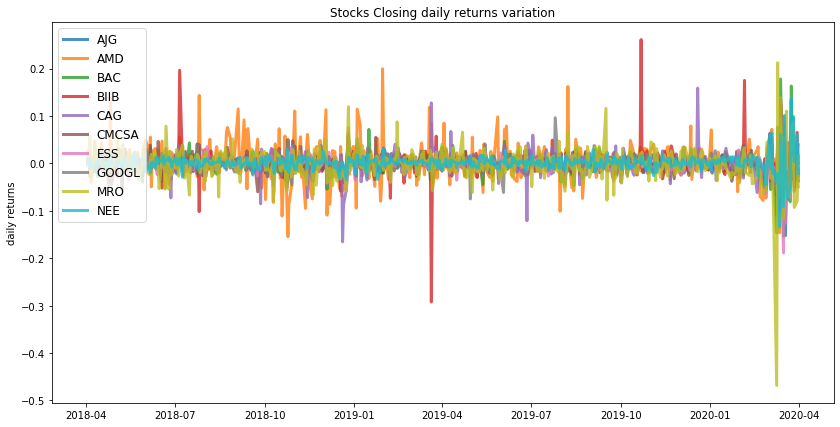

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.24
Annualised Volatility: 0.52


            AJG    AMD  BAC  BIIB  CAG  CMCSA  ESS  GOOGL  MRO    NEE
allocation  0.0  50.22  0.0   0.0  0.0    0.0  0.0    0.0  0.0  49.78
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.23
Annualised Volatility: 0.3


             AJG  AMD  BAC  BIIB    CAG  CMCSA   ESS  GOOGL  MRO    NEE
allocation  9.14  0.0  0.0  6.33  16.89  14.63  17.2  15.65  0.0  20.16


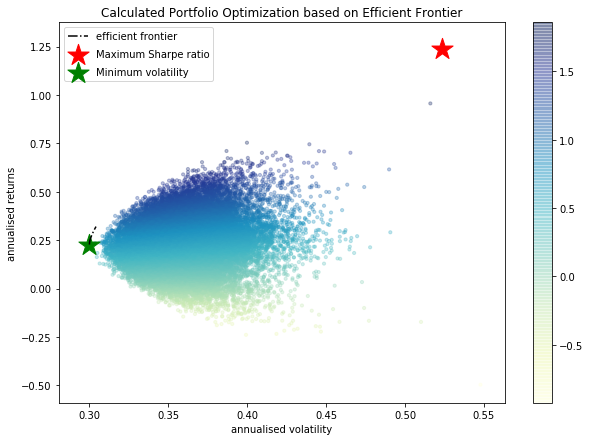

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AJG : annuaised return 0.31 , annualised volatility: 0.38
AMD : annuaised return 1.96 , annualised volatility: 0.88
BAC : annuaised return -0.14 , annualised volatility: 0.52
BIIB : annuaised return 0.39 , annualised volatility: 0.65
CAG : annuaised return -0.0 , annualised volatility: 0.53
CMCSA : annuaised return 0.16 , annualised volatility: 0.42
ESS : annuaised return 0.07 , annualised volatility: 0.4
GOOGL : annuaised return 0.23 , annualised volatility: 0.43
MRO : annuaised return -1.12 , annualised volatility: 0.84
NEE : annuaised return 0.52 , annualised volatility: 0.38
--------------------------------------------------------------------------------


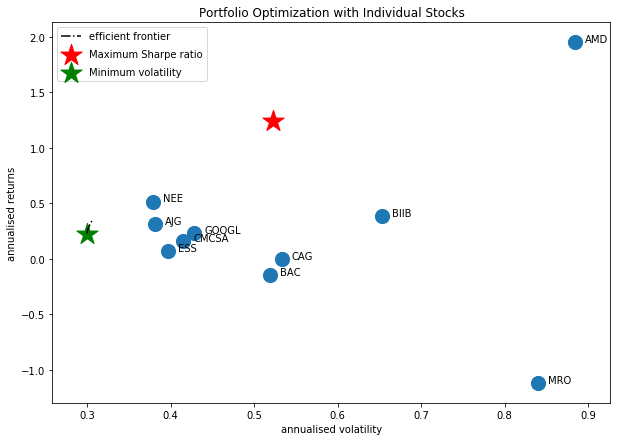

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['GOOGL', 'BKNG', 'NEE', 'ESS', 'AJG', 'BIIB', 'AMD', 'CAG', 'MRO', 'BAC']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



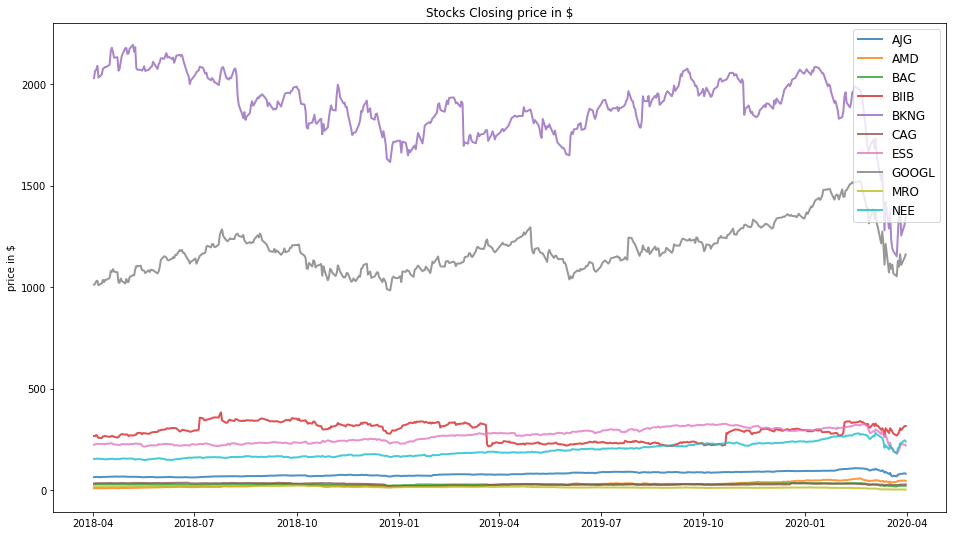

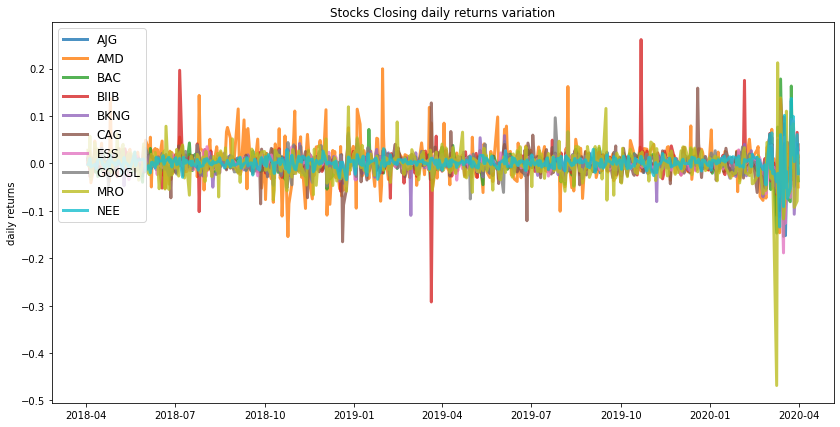

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.24
Annualised Volatility: 0.52


            AJG    AMD  BAC  BIIB  BKNG  CAG  ESS  GOOGL  MRO    NEE
allocation  0.0  50.21  0.0   0.0   0.0  0.0  0.0    0.0  0.0  49.79
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.23
Annualised Volatility: 0.3


              AJG  AMD  BAC  BIIB  BKNG    CAG    ESS  GOOGL  MRO   NEE
allocation  10.57  0.0  0.0  7.21  2.15  18.37  19.75  19.94  0.0  22.0


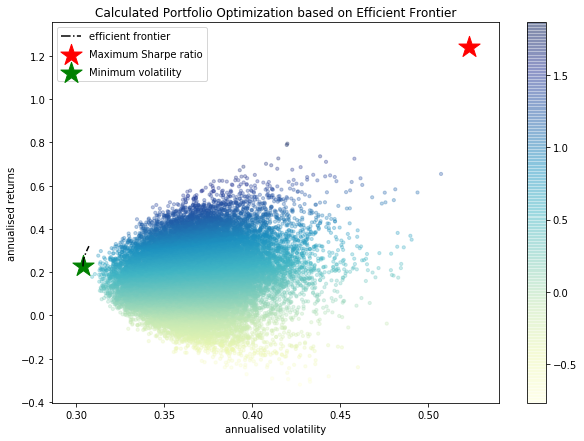

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AJG : annuaised return 0.31 , annualised volatility: 0.38
AMD : annuaised return 1.96 , annualised volatility: 0.88
BAC : annuaised return -0.14 , annualised volatility: 0.52
BIIB : annuaised return 0.39 , annualised volatility: 0.65
BKNG : annuaised return -0.3 , annualised volatility: 0.47
CAG : annuaised return -0.0 , annualised volatility: 0.53
ESS : annuaised return 0.07 , annualised volatility: 0.4
GOOGL : annuaised return 0.23 , annualised volatility: 0.43
MRO : annuaised return -1.12 , annualised volatility: 0.84
NEE : annuaised return 0.52 , annualised volatility: 0.38
--------------------------------------------------------------------------------


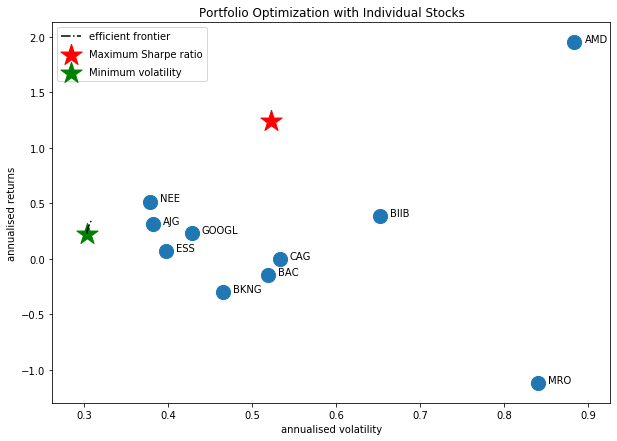

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['GOOGL', 'CTXS']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



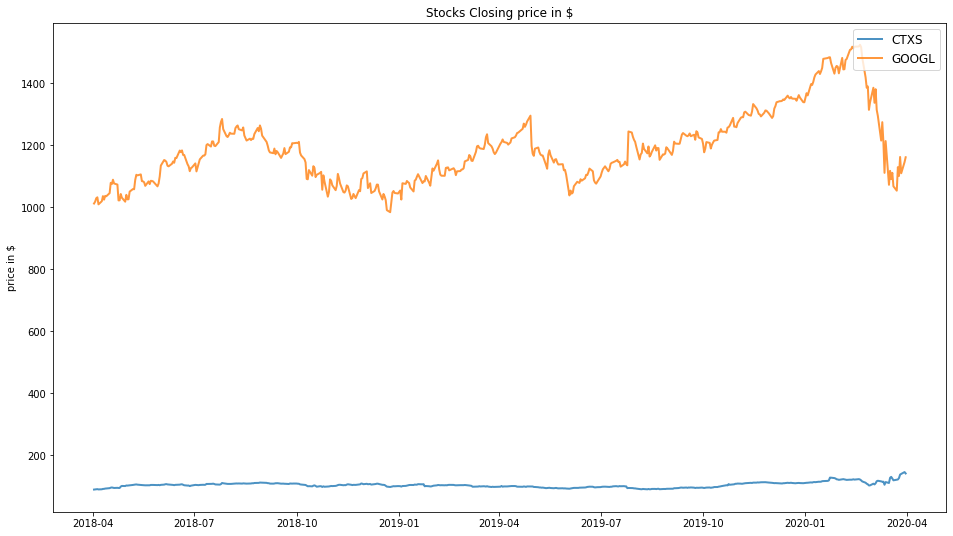

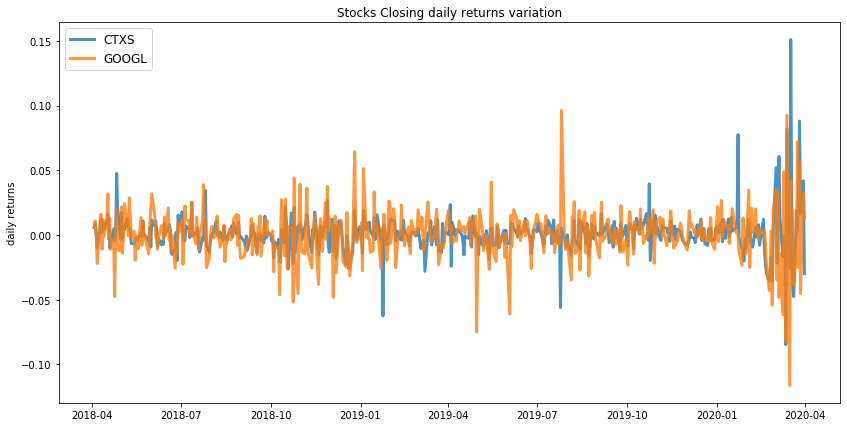

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.52
Annualised Volatility: 0.35


             CTXS  GOOGL
allocation  100.0    0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.43
Annualised Volatility: 0.32


             CTXS  GOOGL
allocation  68.56  31.44


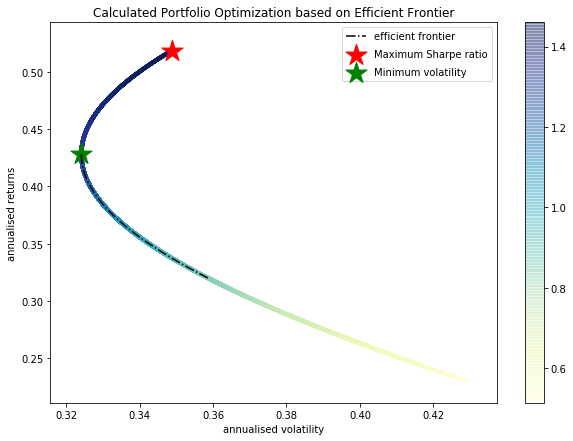

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

CTXS : annuaised return 0.52 , annualised volatility: 0.35
GOOGL : annuaised return 0.23 , annualised volatility: 0.43
--------------------------------------------------------------------------------


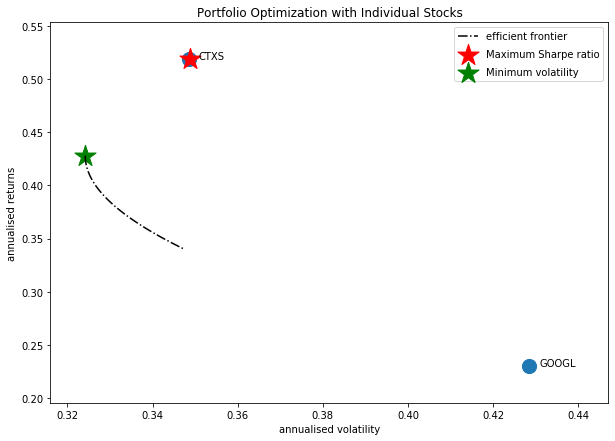

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BAC', 'GOOG', 'CAG']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



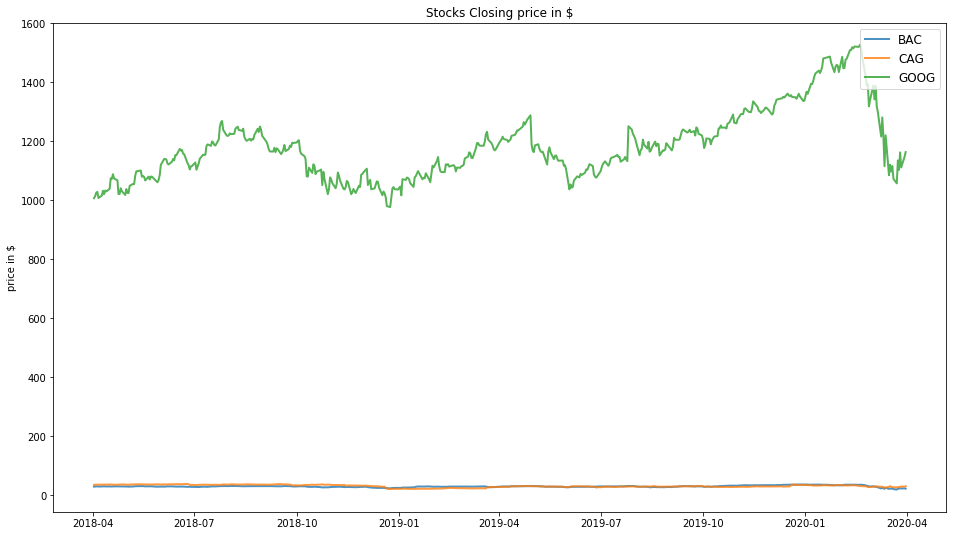

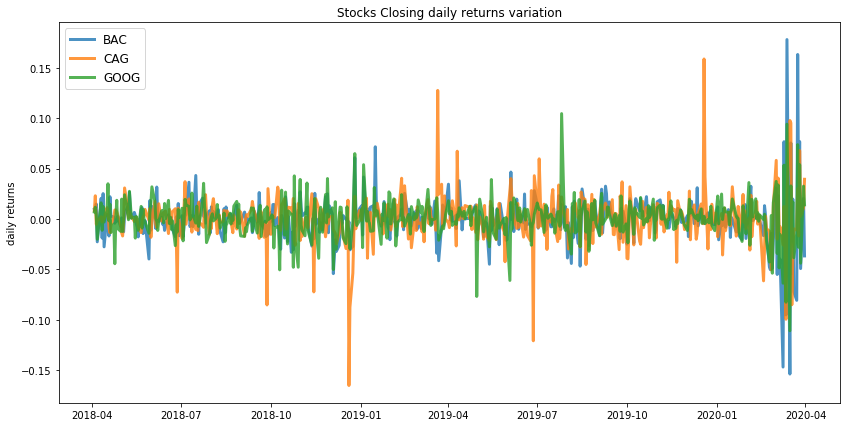

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.24
Annualised Volatility: 0.43


            BAC  CAG   GOOG
allocation  0.0  0.0  100.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.1
Annualised Volatility: 0.36


              BAC    CAG   GOOG
allocation  12.98  35.33  51.69


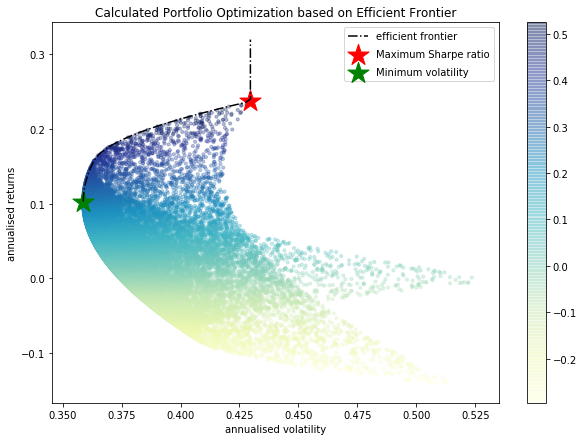

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

BAC : annuaised return -0.14 , annualised volatility: 0.52
CAG : annuaised return -0.0 , annualised volatility: 0.53
GOOG : annuaised return 0.24 , annualised volatility: 0.43
--------------------------------------------------------------------------------


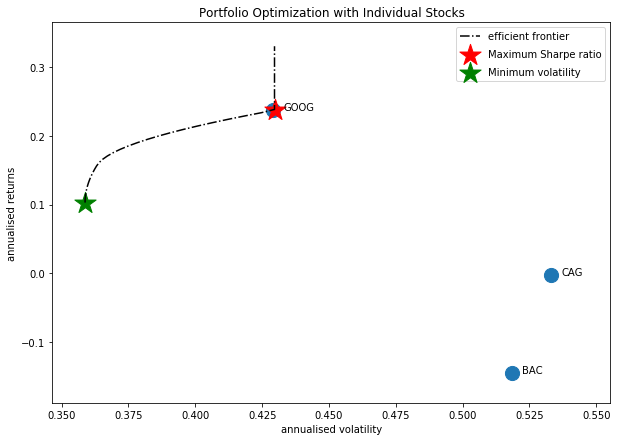

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['APC', 'AZO']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



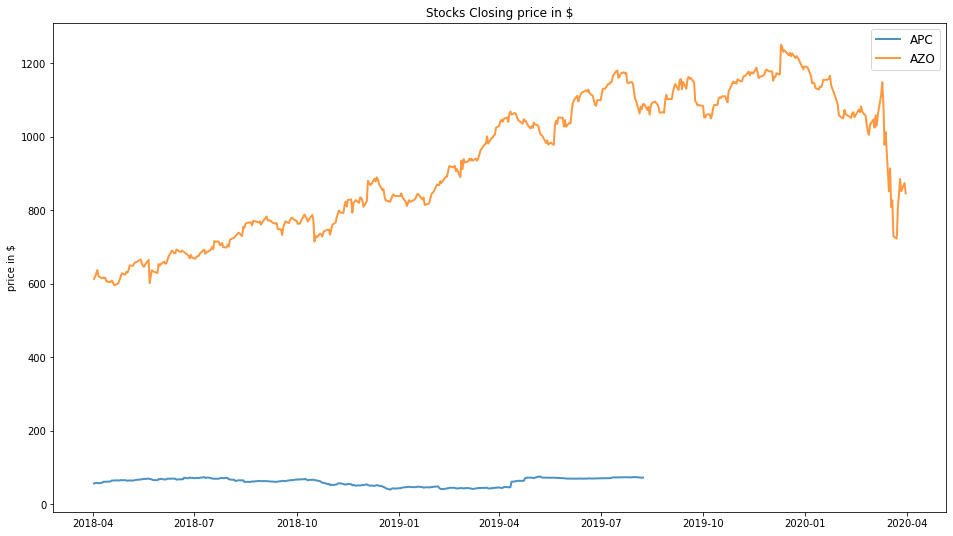

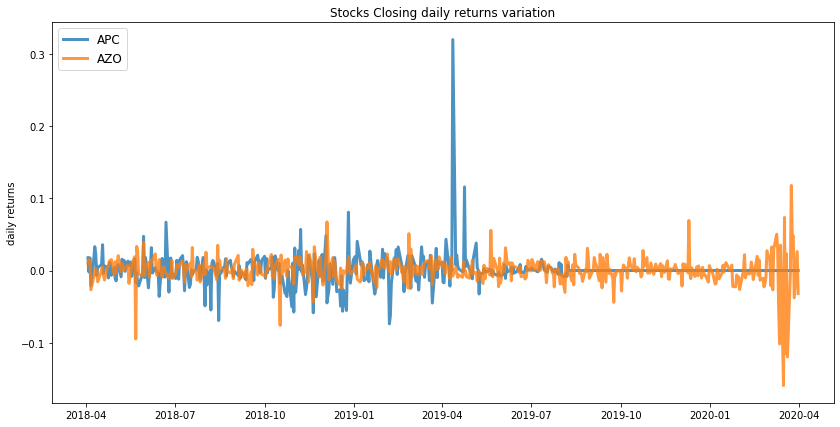

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.4
Annualised Volatility: 0.34


              APC    AZO
allocation  40.51  59.49
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.4
Annualised Volatility: 0.34


             APC   AZO
allocation  44.9  55.1


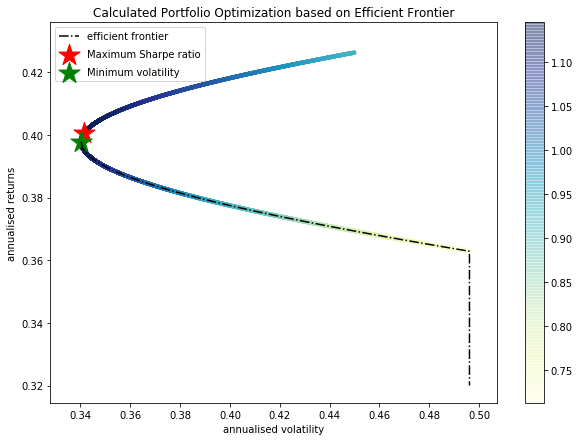

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

APC : annuaised return 0.36 , annualised volatility: 0.5
AZO : annuaised return 0.43 , annualised volatility: 0.45
--------------------------------------------------------------------------------


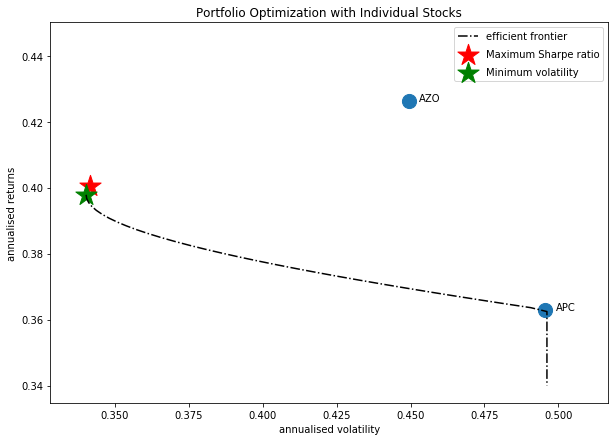

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BKNG', 'AJG', 'BIIB', 'AMD', 'MRO', 'BAC']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



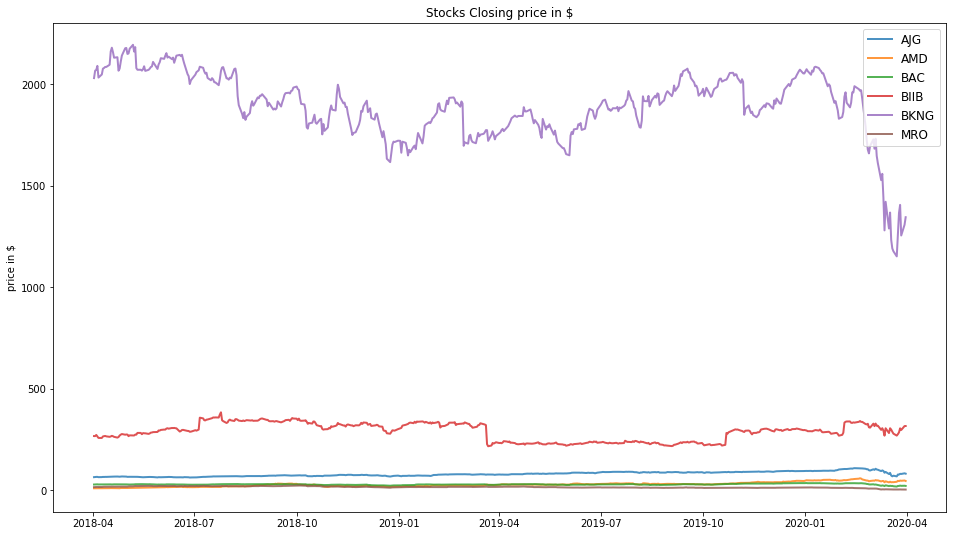

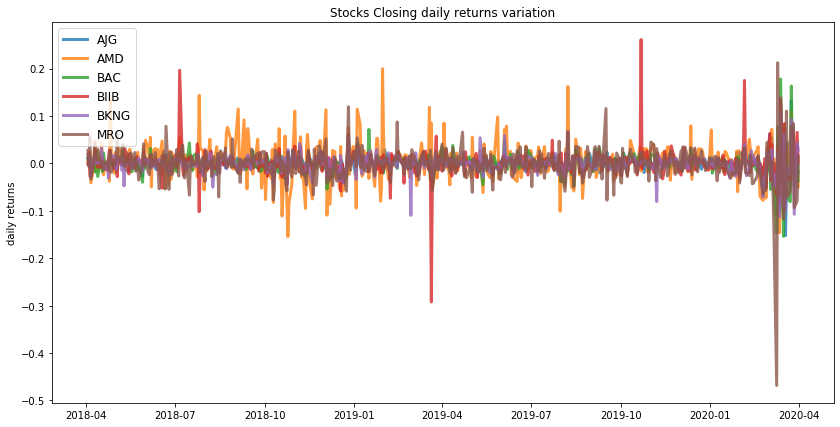

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.82
Annualised Volatility: 0.82


            AJG    AMD  BAC  BIIB  BKNG  MRO
allocation  0.0  91.18  0.0  8.82   0.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.17
Annualised Volatility: 0.36


              AJG  AMD  BAC   BIIB   BKNG   MRO
allocation  66.08  0.0  0.0  12.29  19.97  1.66


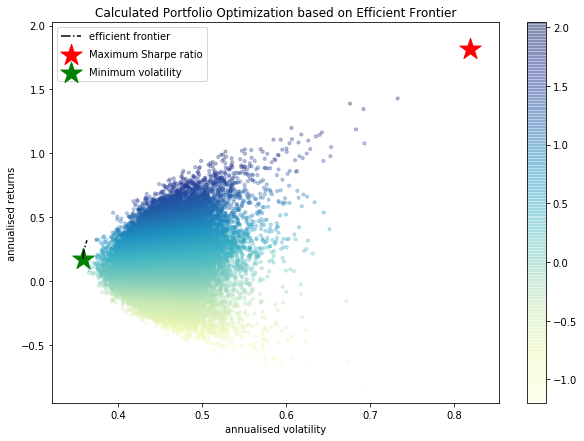

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AJG : annuaised return 0.31 , annualised volatility: 0.38
AMD : annuaised return 1.96 , annualised volatility: 0.88
BAC : annuaised return -0.14 , annualised volatility: 0.52
BIIB : annuaised return 0.39 , annualised volatility: 0.65
BKNG : annuaised return -0.3 , annualised volatility: 0.47
MRO : annuaised return -1.12 , annualised volatility: 0.84
--------------------------------------------------------------------------------


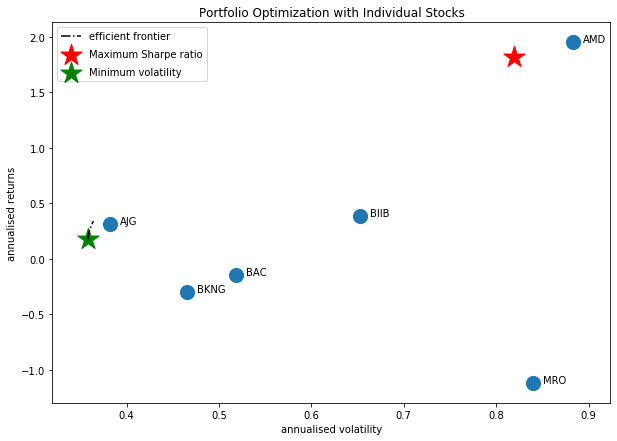

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['NEM', 'BKNG']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



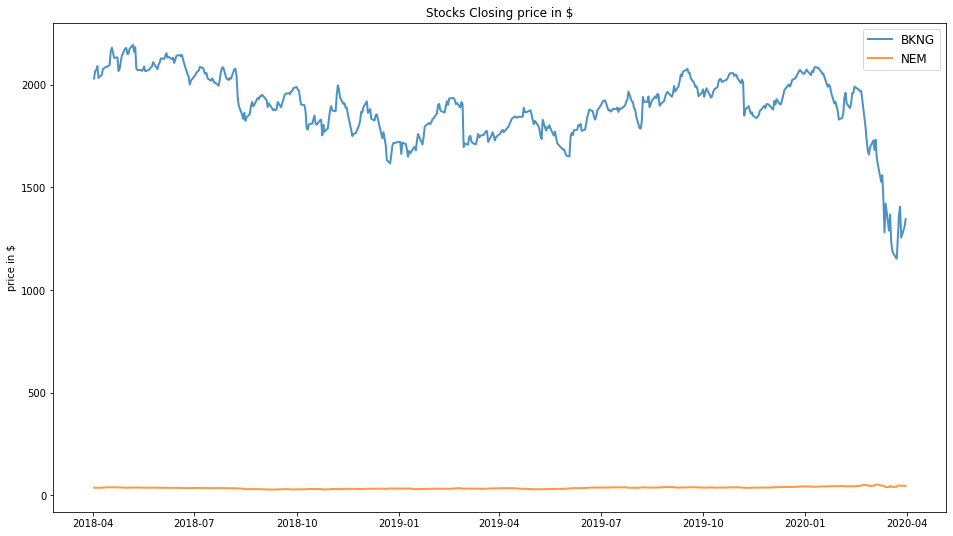

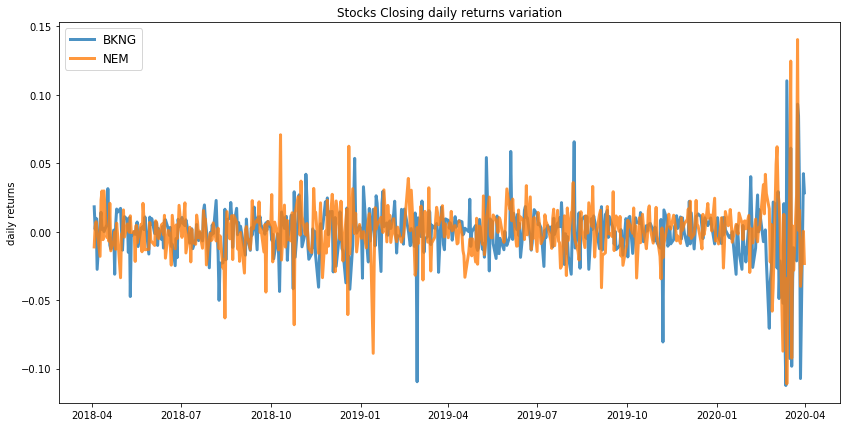

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.3
Annualised Volatility: 0.46


            BKNG    NEM
allocation   0.0  100.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.01
Annualised Volatility: 0.35


             BKNG    NEM
allocation  48.73  51.27


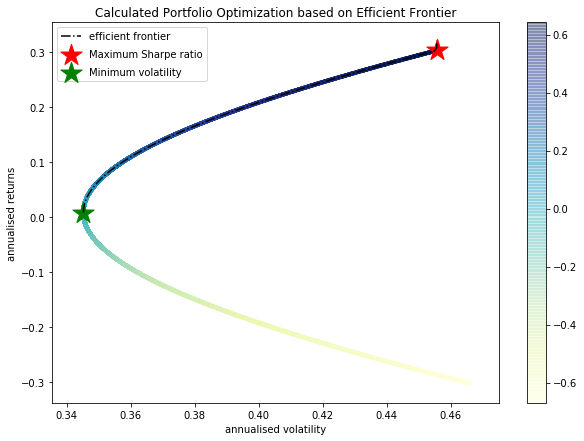

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

BKNG : annuaised return -0.3 , annualised volatility: 0.47
NEM : annuaised return 0.3 , annualised volatility: 0.46
--------------------------------------------------------------------------------


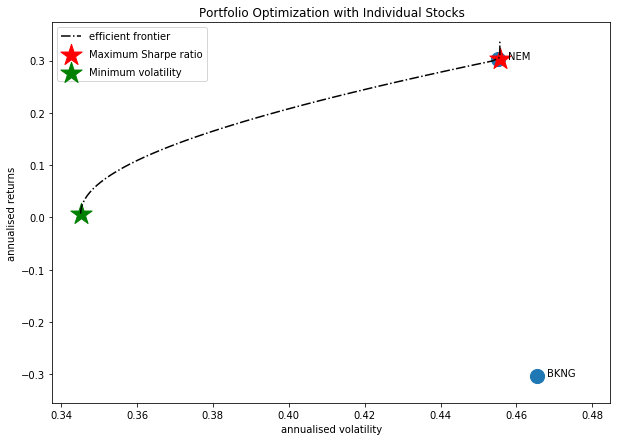

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BKNG', 'AJG', 'BIIB', 'AMD', 'CAG', 'MRO', 'BAC']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



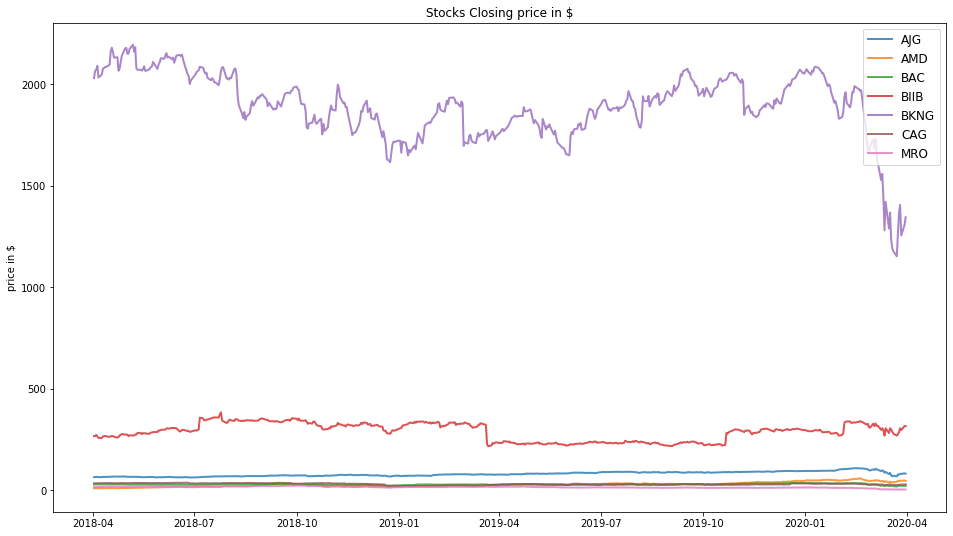

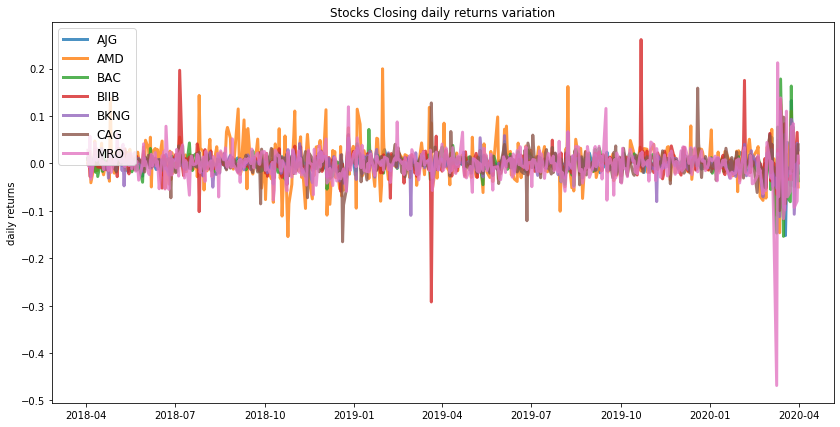

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.82
Annualised Volatility: 0.82


            AJG    AMD  BAC  BIIB  BKNG  CAG  MRO
allocation  0.0  91.18  0.0  8.82   0.0  0.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.14
Annualised Volatility: 0.33


              AJG  AMD  BAC   BIIB   BKNG    CAG   MRO
allocation  47.54  0.0  0.0  12.48  14.47  24.16  1.35


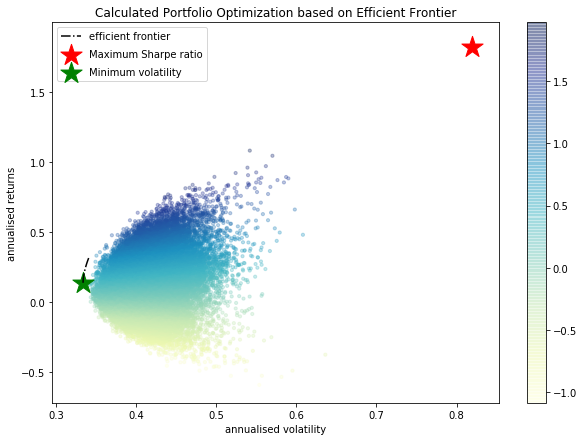

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AJG : annuaised return 0.31 , annualised volatility: 0.38
AMD : annuaised return 1.96 , annualised volatility: 0.88
BAC : annuaised return -0.14 , annualised volatility: 0.52
BIIB : annuaised return 0.39 , annualised volatility: 0.65
BKNG : annuaised return -0.3 , annualised volatility: 0.47
CAG : annuaised return -0.0 , annualised volatility: 0.53
MRO : annuaised return -1.12 , annualised volatility: 0.84
--------------------------------------------------------------------------------


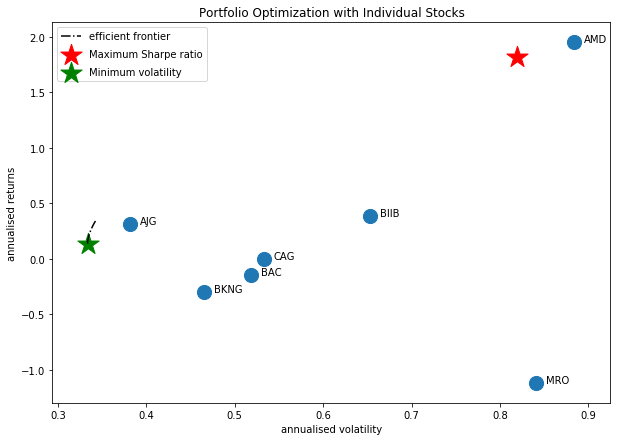

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BKNG', 'BIIB', 'AMD', 'MRO', 'HP']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



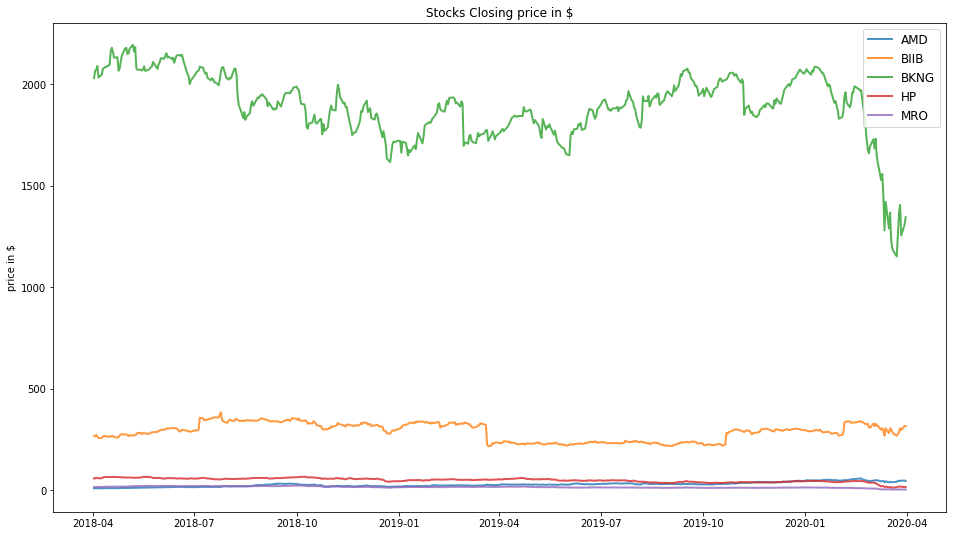

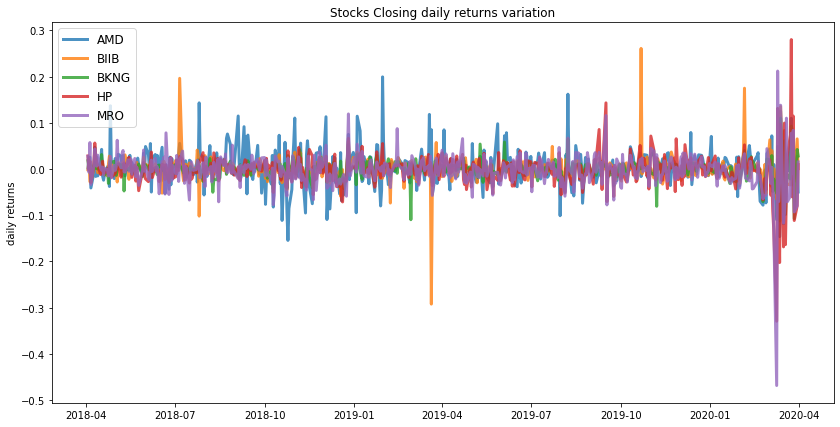

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.82
Annualised Volatility: 0.82


              AMD  BIIB  BKNG   HP  MRO
allocation  91.18  8.82   0.0  0.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: -0.13
Annualised Volatility: 0.43


             AMD   BIIB  BKNG   HP   MRO
allocation  2.91  22.96  68.0  0.0  6.12


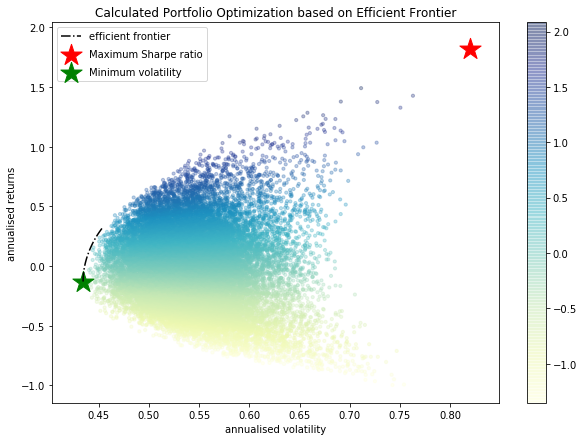

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMD : annuaised return 1.96 , annualised volatility: 0.88
BIIB : annuaised return 0.39 , annualised volatility: 0.65
BKNG : annuaised return -0.3 , annualised volatility: 0.47
HP : annuaised return -0.97 , annualised volatility: 0.81
MRO : annuaised return -1.12 , annualised volatility: 0.84
--------------------------------------------------------------------------------


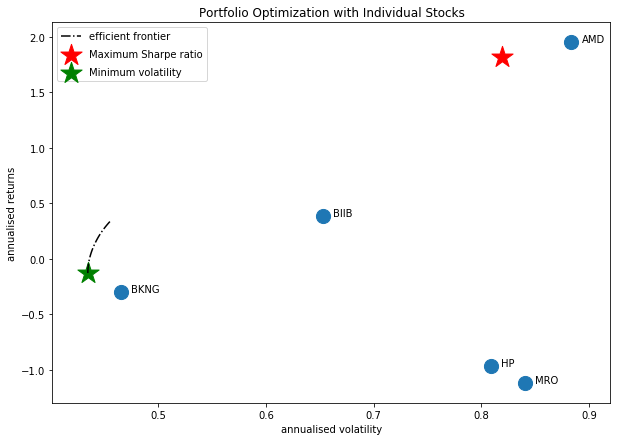

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BKNG', 'AJG', 'BIIB', 'AMD', 'MRO', 'COTY']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



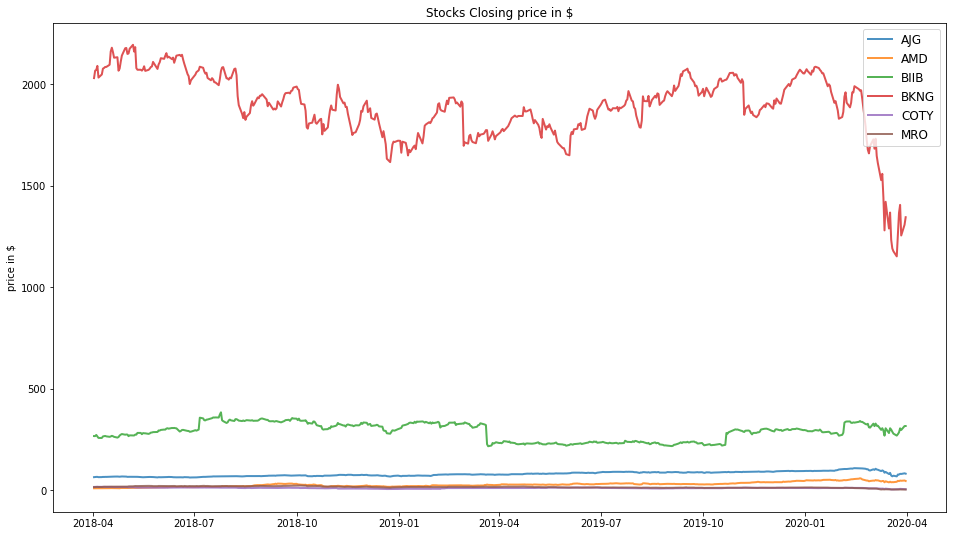

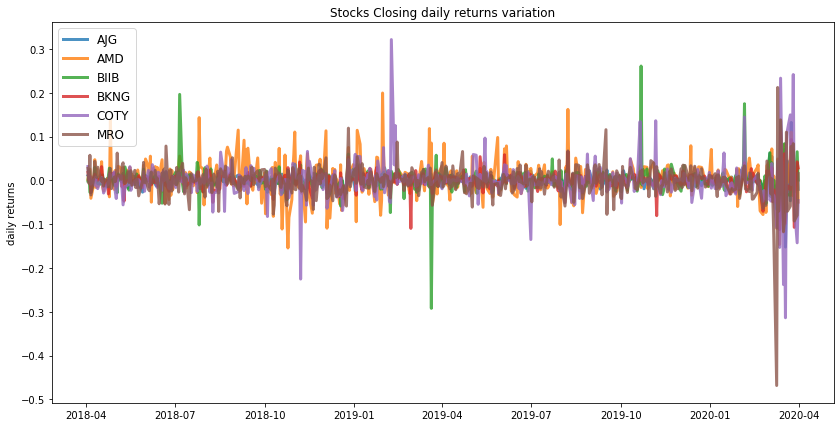

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.82
Annualised Volatility: 0.82


            AJG    AMD  BIIB  BKNG  COTY  MRO
allocation  0.0  91.18  8.82   0.0   0.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.17
Annualised Volatility: 0.36


              AJG  AMD   BIIB  BKNG  COTY   MRO
allocation  66.14  0.0  12.21  20.0   0.0  1.66


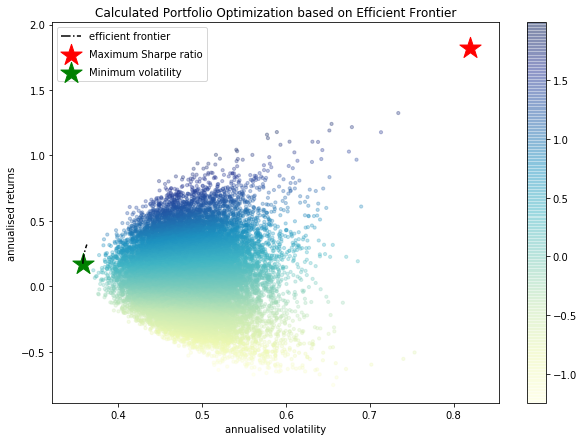

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AJG : annuaised return 0.31 , annualised volatility: 0.38
AMD : annuaised return 1.96 , annualised volatility: 0.88
BIIB : annuaised return 0.39 , annualised volatility: 0.65
BKNG : annuaised return -0.3 , annualised volatility: 0.47
COTY : annuaised return -0.7 , annualised volatility: 0.94
MRO : annuaised return -1.12 , annualised volatility: 0.84
--------------------------------------------------------------------------------


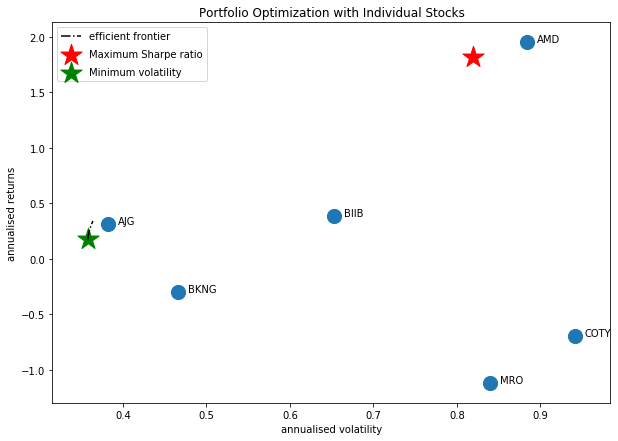

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BKNG', 'AJG', 'BIIB', 'AMD', 'MRO', 'EXC']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



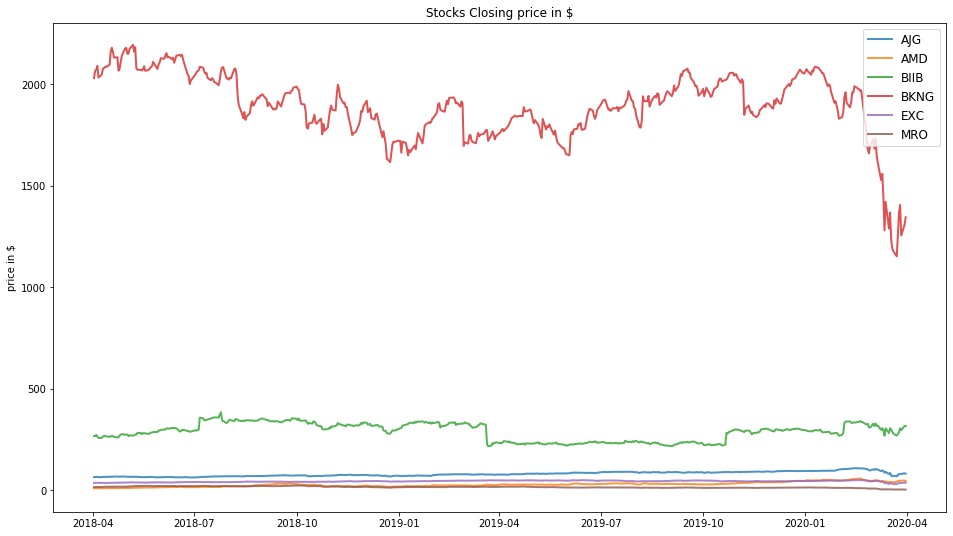

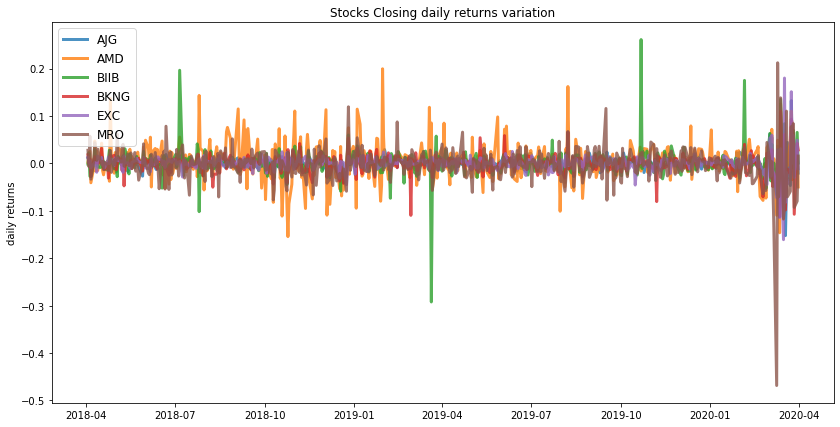

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.82
Annualised Volatility: 0.82


            AJG    AMD  BIIB  BKNG  EXC  MRO
allocation  0.0  91.18  8.82   0.0  0.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.14
Annualised Volatility: 0.35


              AJG  AMD   BIIB   BKNG    EXC   MRO
allocation  46.47  0.0  10.87  17.23  23.77  1.66


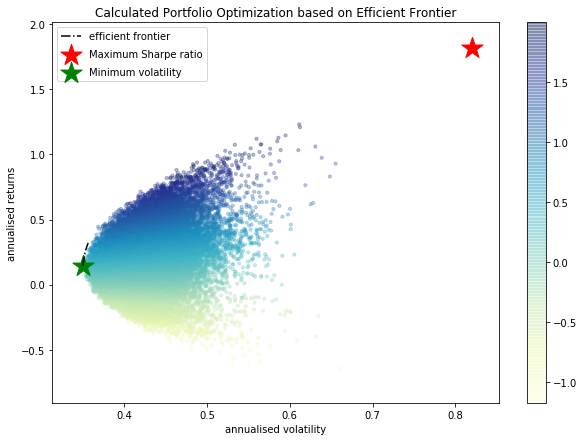

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AJG : annuaised return 0.31 , annualised volatility: 0.38
AMD : annuaised return 1.96 , annualised volatility: 0.88
BIIB : annuaised return 0.39 , annualised volatility: 0.65
BKNG : annuaised return -0.3 , annualised volatility: 0.47
EXC : annuaised return 0.11 , annualised volatility: 0.43
MRO : annuaised return -1.12 , annualised volatility: 0.84
--------------------------------------------------------------------------------


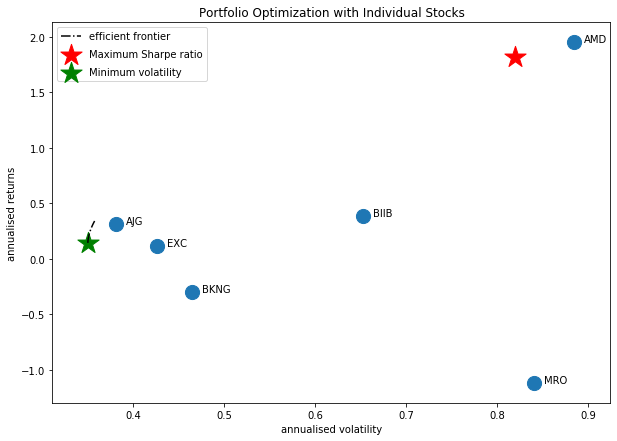

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['APC', 'BKNG']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



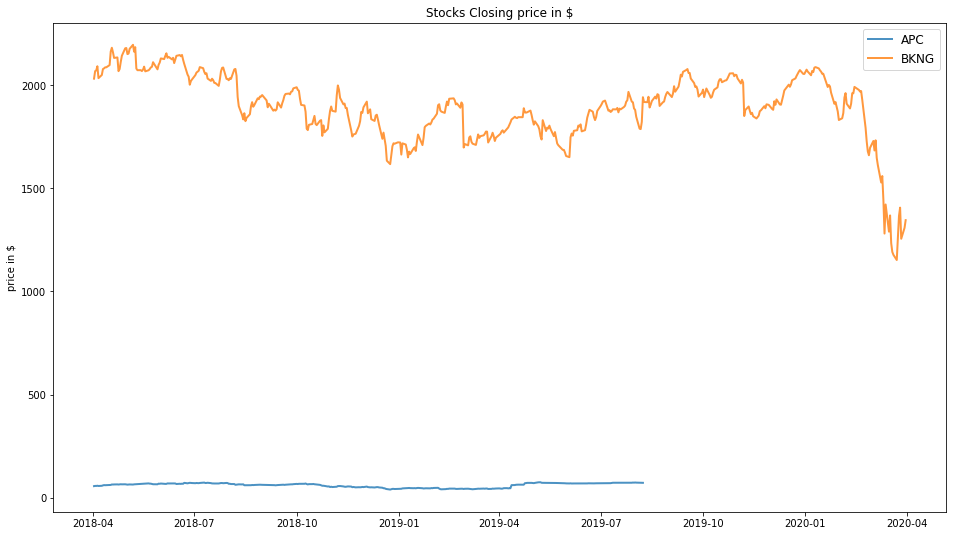

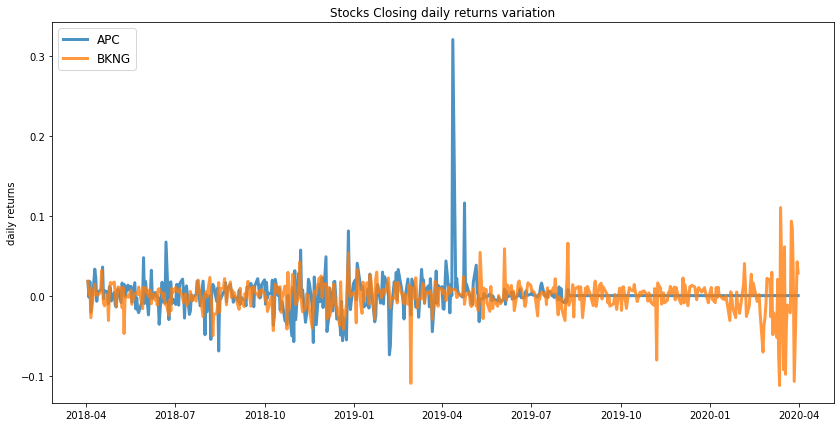

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.36
Annualised Volatility: 0.5


              APC  BKNG
allocation  100.0   0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.01
Annualised Volatility: 0.36


              APC   BKNG
allocation  46.38  53.62


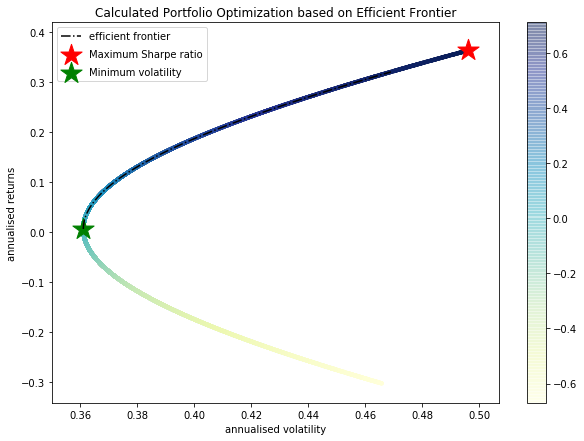

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

APC : annuaised return 0.36 , annualised volatility: 0.5
BKNG : annuaised return -0.3 , annualised volatility: 0.47
--------------------------------------------------------------------------------


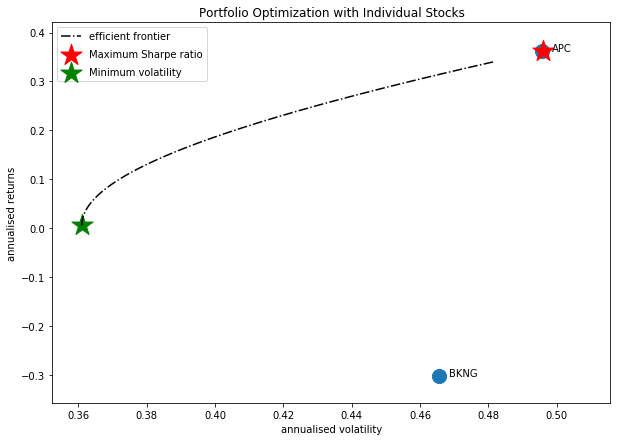

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['CPB', 'BKNG']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



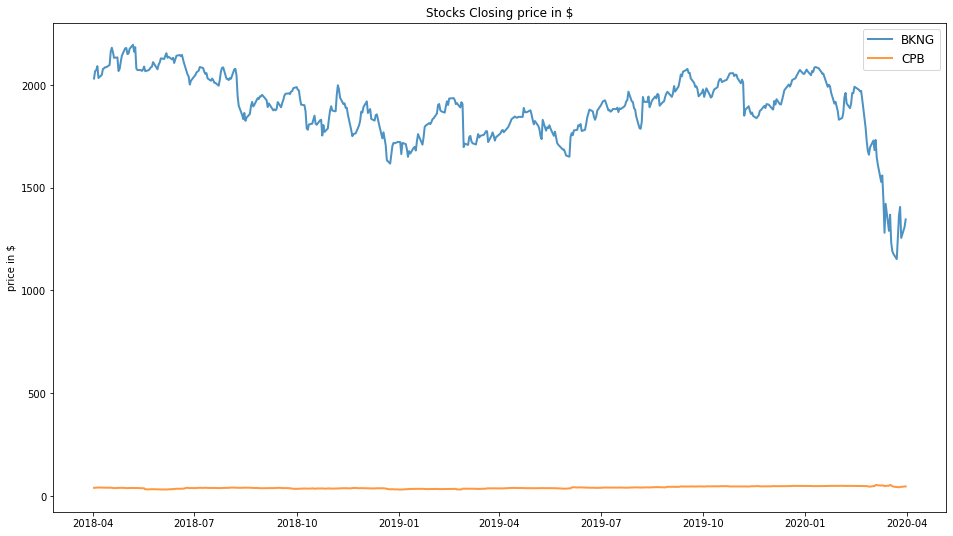

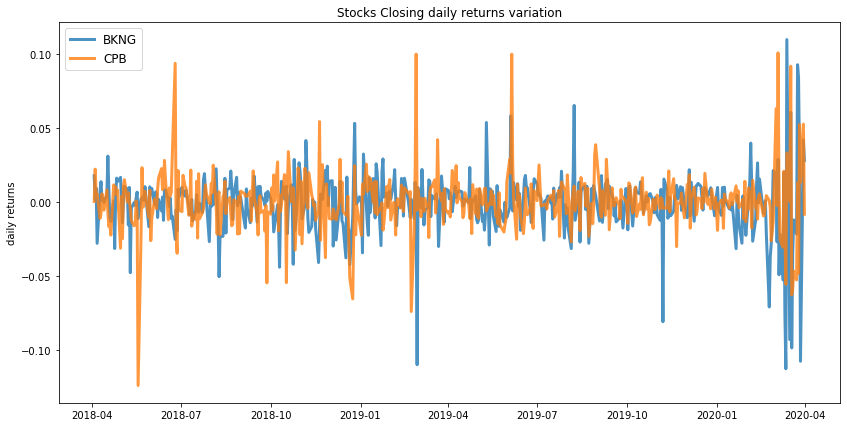

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.25
Annualised Volatility: 0.44


            BKNG    CPB
allocation   0.0  100.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: -0.0
Annualised Volatility: 0.35


             BKNG    CPB
allocation  45.79  54.21


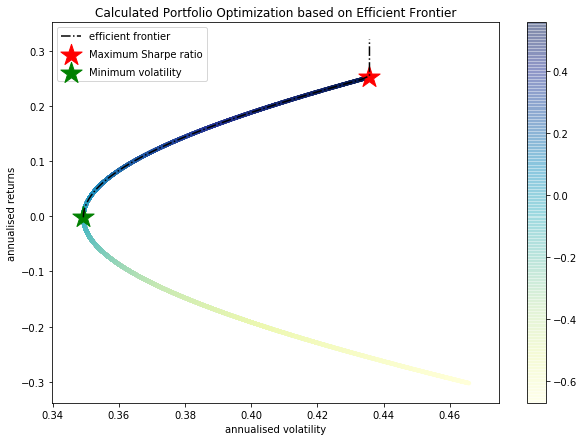

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

BKNG : annuaised return -0.3 , annualised volatility: 0.47
CPB : annuaised return 0.25 , annualised volatility: 0.44
--------------------------------------------------------------------------------


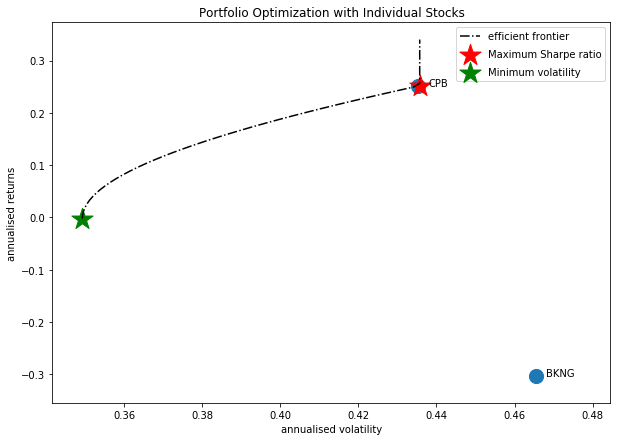

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['NEE', 'ESS', 'AJG', 'BIIB', 'AMD', 'CAG', 'MRO', 'BAC']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



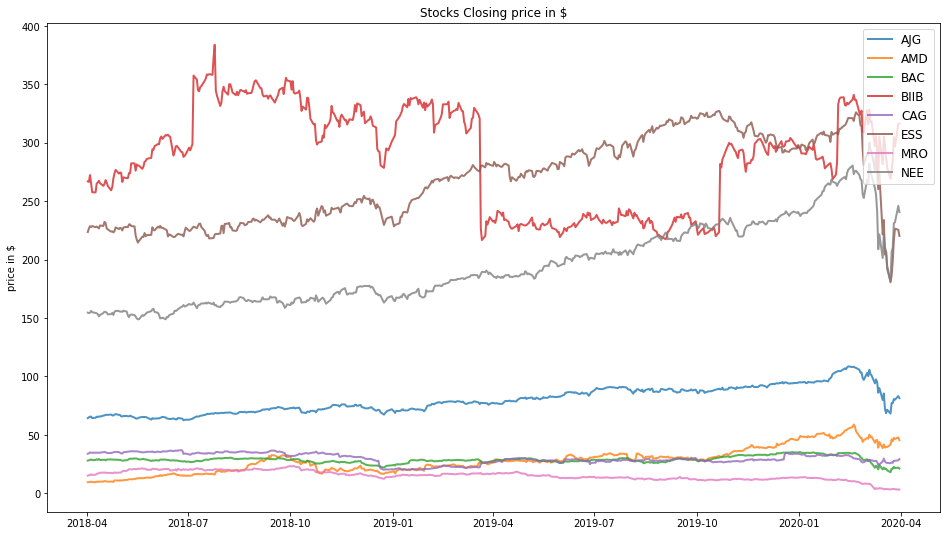

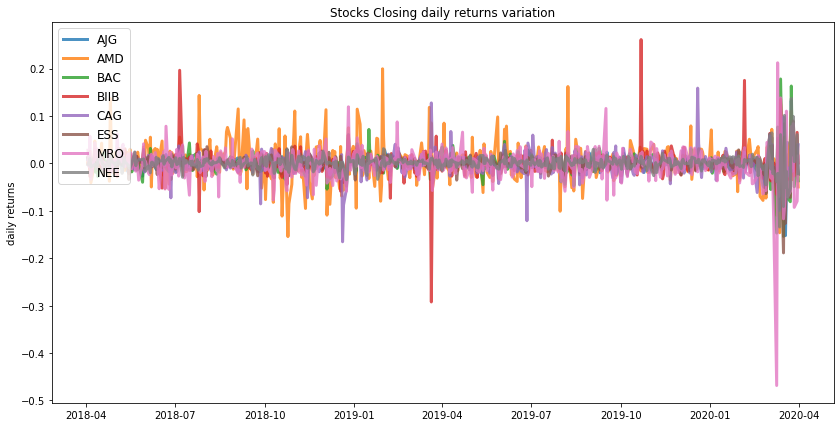

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.24
Annualised Volatility: 0.52


            AJG    AMD  BAC  BIIB  CAG  ESS  MRO    NEE
allocation  0.0  50.23  0.0   0.0  0.0  0.0  0.0  49.77
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.21
Annualised Volatility: 0.31


              AJG  AMD  BAC  BIIB    CAG    ESS   MRO    NEE
allocation  20.01  0.0  0.0  9.91  19.51  22.72  2.71  25.15


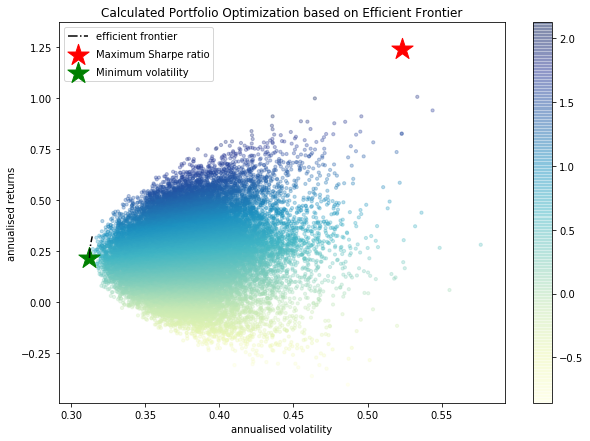

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AJG : annuaised return 0.31 , annualised volatility: 0.38
AMD : annuaised return 1.96 , annualised volatility: 0.88
BAC : annuaised return -0.14 , annualised volatility: 0.52
BIIB : annuaised return 0.39 , annualised volatility: 0.65
CAG : annuaised return -0.0 , annualised volatility: 0.53
ESS : annuaised return 0.07 , annualised volatility: 0.4
MRO : annuaised return -1.12 , annualised volatility: 0.84
NEE : annuaised return 0.52 , annualised volatility: 0.38
--------------------------------------------------------------------------------


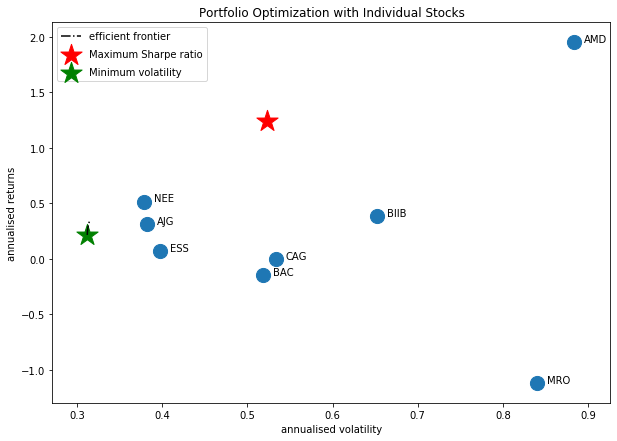

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['NEE', 'ESS', 'AJG', 'BIIB', 'AMD', 'CAG', 'MRO', 'BAC', 'COTY']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



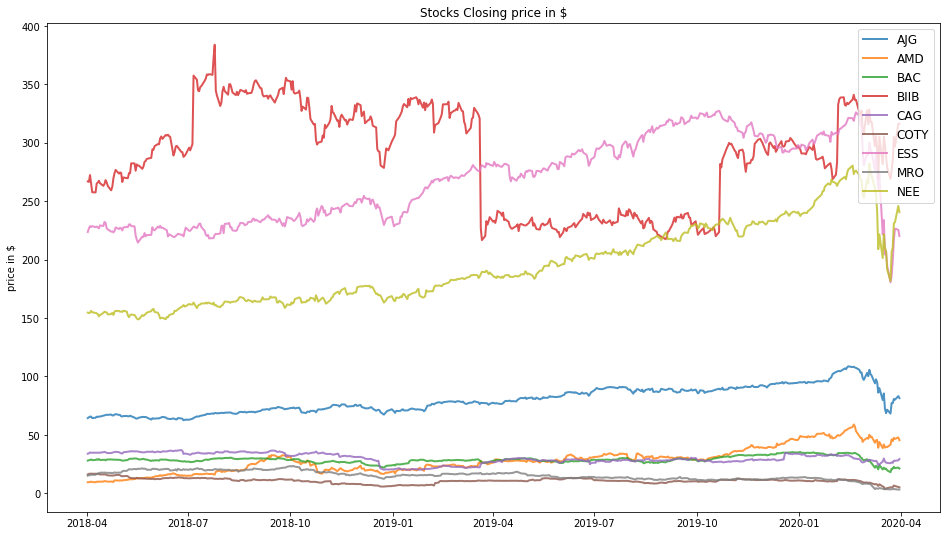

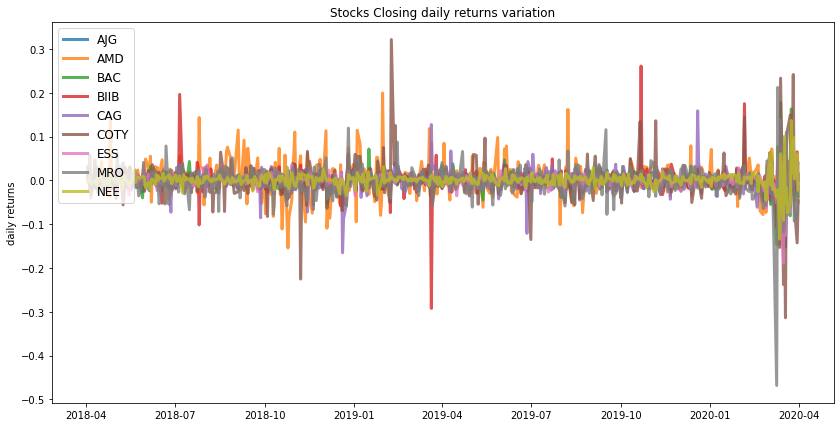

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.24
Annualised Volatility: 0.52


            AJG    AMD  BAC  BIIB  CAG  COTY  ESS  MRO    NEE
allocation  0.0  50.27  0.0   0.0  0.0   0.0  0.0  0.0  49.73
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.21
Annualised Volatility: 0.31


              AJG  AMD  BAC  BIIB    CAG  COTY    ESS   MRO    NEE
allocation  19.99  0.0  0.0  9.91  19.51   0.0  22.71  2.71  25.18


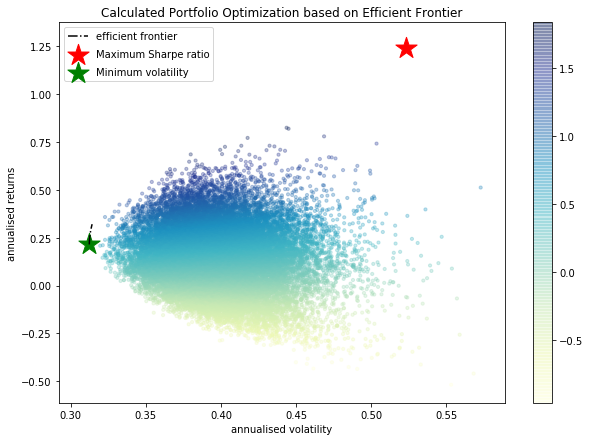

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AJG : annuaised return 0.31 , annualised volatility: 0.38
AMD : annuaised return 1.96 , annualised volatility: 0.88
BAC : annuaised return -0.14 , annualised volatility: 0.52
BIIB : annuaised return 0.39 , annualised volatility: 0.65
CAG : annuaised return -0.0 , annualised volatility: 0.53
COTY : annuaised return -0.7 , annualised volatility: 0.94
ESS : annuaised return 0.07 , annualised volatility: 0.4
MRO : annuaised return -1.12 , annualised volatility: 0.84
NEE : annuaised return 0.52 , annualised volatility: 0.38
--------------------------------------------------------------------------------


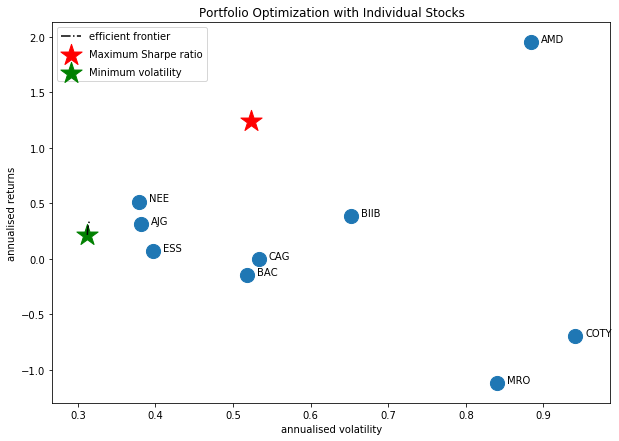

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['NEE', 'ESS', 'AJG', 'BIIB', 'AMD', 'CAG', 'MRO', 'BAC', 'EXC']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



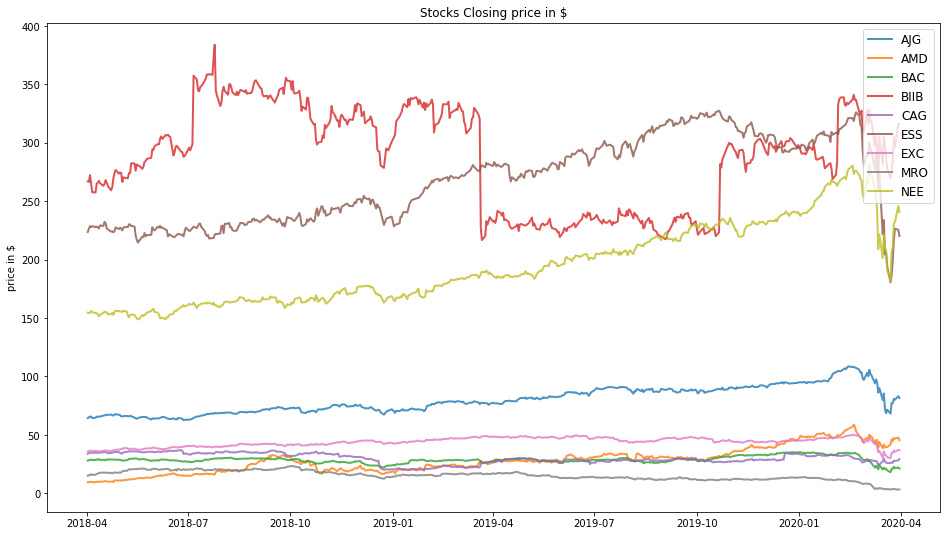

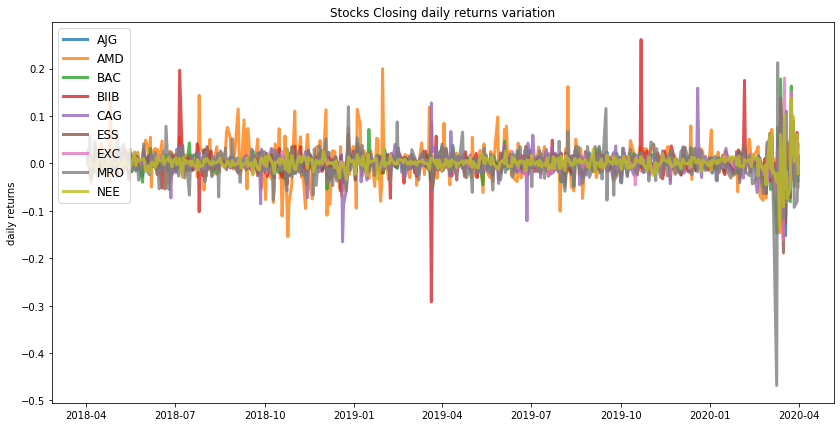

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.24
Annualised Volatility: 0.52


            AJG    AMD  BAC  BIIB  CAG  ESS  EXC  MRO    NEE
allocation  0.0  50.21  0.0   0.0  0.0  0.0  0.0  0.0  49.79
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.21
Annualised Volatility: 0.31


              AJG  AMD  BAC  BIIB    CAG    ESS  EXC   MRO    NEE
allocation  20.09  0.0  0.0  9.91  19.53  22.65  0.0  2.69  25.12


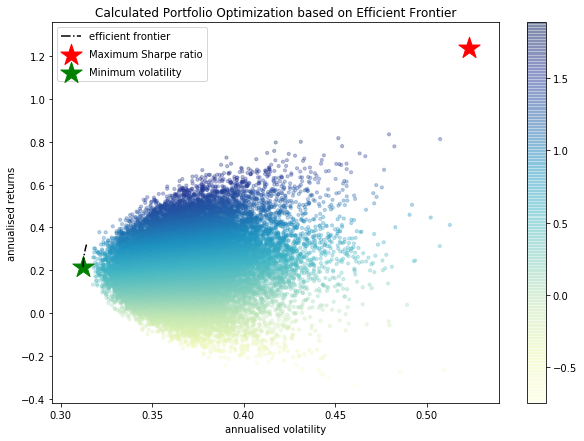

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AJG : annuaised return 0.31 , annualised volatility: 0.38
AMD : annuaised return 1.96 , annualised volatility: 0.88
BAC : annuaised return -0.14 , annualised volatility: 0.52
BIIB : annuaised return 0.39 , annualised volatility: 0.65
CAG : annuaised return -0.0 , annualised volatility: 0.53
ESS : annuaised return 0.07 , annualised volatility: 0.4
EXC : annuaised return 0.11 , annualised volatility: 0.43
MRO : annuaised return -1.12 , annualised volatility: 0.84
NEE : annuaised return 0.52 , annualised volatility: 0.38
--------------------------------------------------------------------------------


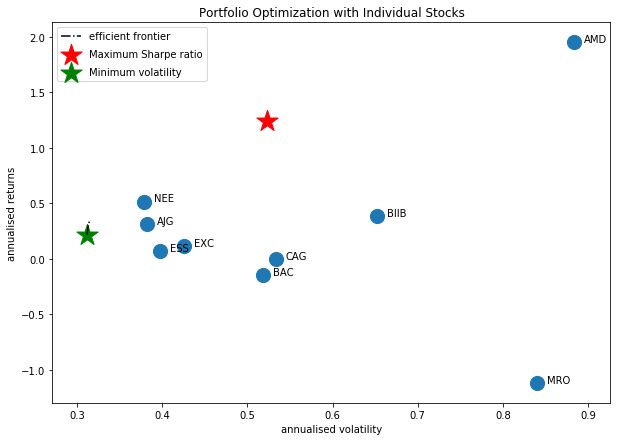

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['NEE', 'ESS', 'AJG', 'BIIB', 'AMD', 'CAG', 'MRO', 'BAC', 'APC']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



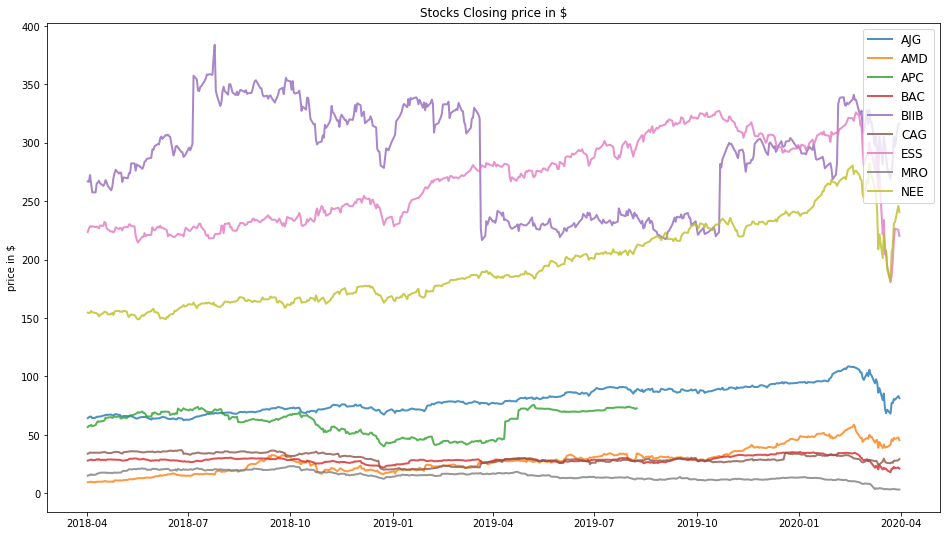

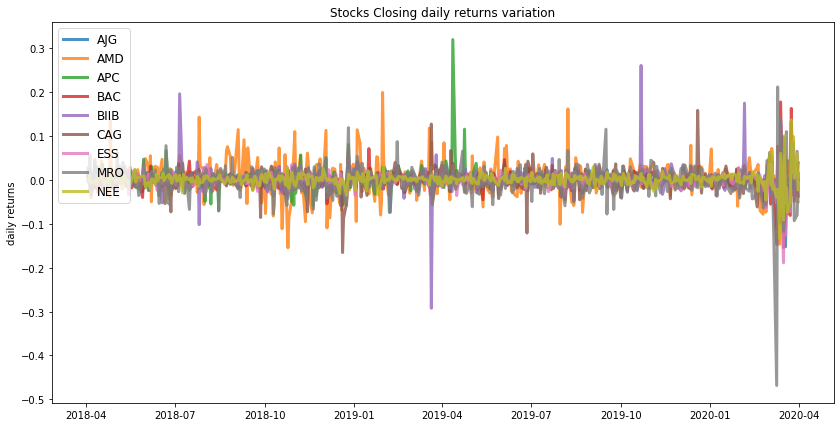

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.09
Annualised Volatility: 0.45


            AJG    AMD    APC  BAC  BIIB  CAG  ESS  MRO    NEE
allocation  0.0  41.42  15.69  0.0   0.0  0.0  0.0  0.0  42.89
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.29
Annualised Volatility: 0.28


              AJG  AMD    APC  BAC  BIIB    CAG    ESS  MRO    NEE
allocation  10.04  0.0  26.88  0.0  5.86  13.43  20.35  0.0  23.44


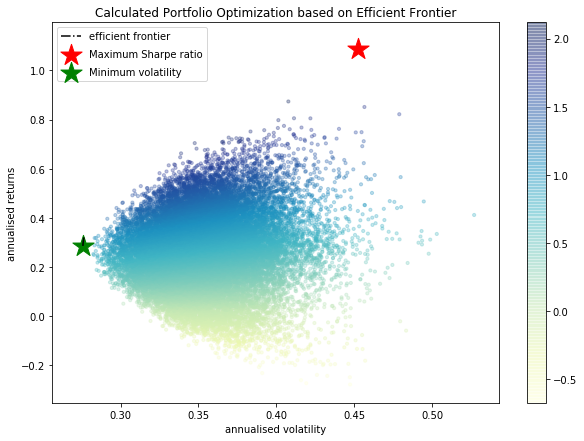

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AJG : annuaised return 0.31 , annualised volatility: 0.38
AMD : annuaised return 1.96 , annualised volatility: 0.88
APC : annuaised return 0.36 , annualised volatility: 0.5
BAC : annuaised return -0.14 , annualised volatility: 0.52
BIIB : annuaised return 0.39 , annualised volatility: 0.65
CAG : annuaised return -0.0 , annualised volatility: 0.53
ESS : annuaised return 0.07 , annualised volatility: 0.4
MRO : annuaised return -1.12 , annualised volatility: 0.84
NEE : annuaised return 0.52 , annualised volatility: 0.38
--------------------------------------------------------------------------------


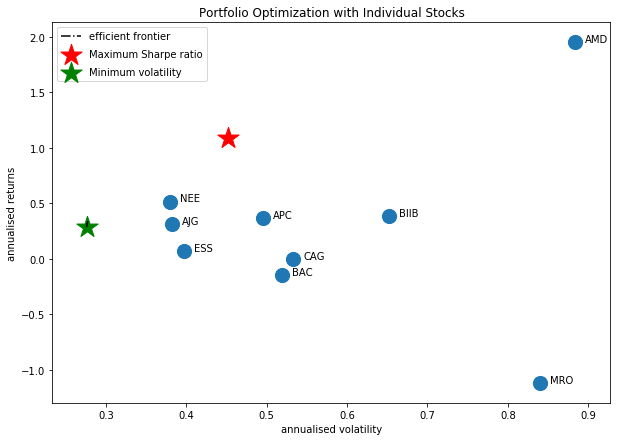

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['NEE', 'ESS', 'AJG', 'BIIB', 'AMD', 'CAG', 'MRO', 'BAC', 'CPB']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



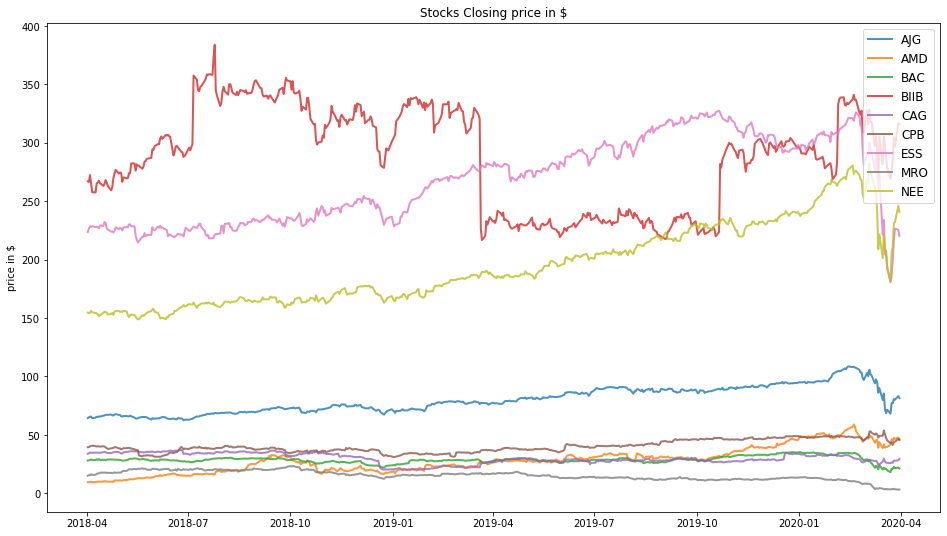

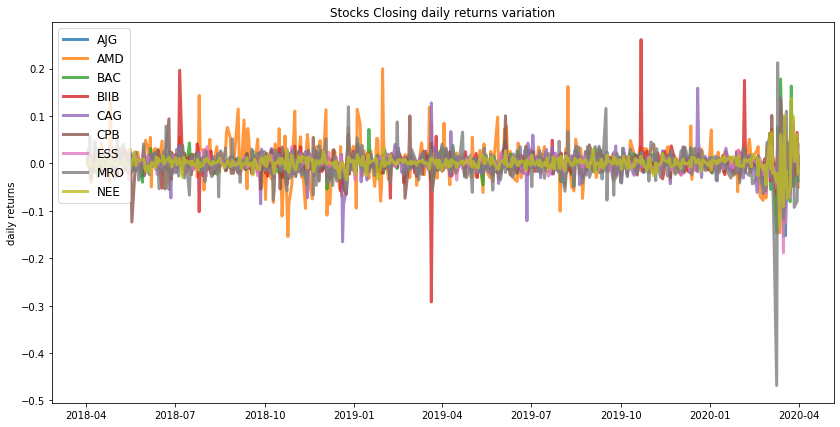

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.24
Annualised Volatility: 0.52


            AJG    AMD  BAC  BIIB  CAG  CPB  ESS  MRO    NEE
allocation  0.0  50.21  0.0   0.0  0.0  0.0  0.0  0.0  49.79
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.21
Annualised Volatility: 0.3


              AJG  AMD  BAC  BIIB    CAG    CPB    ESS   MRO    NEE
allocation  17.28  0.0  0.0  8.97  12.01  20.33  19.12  3.39  18.89


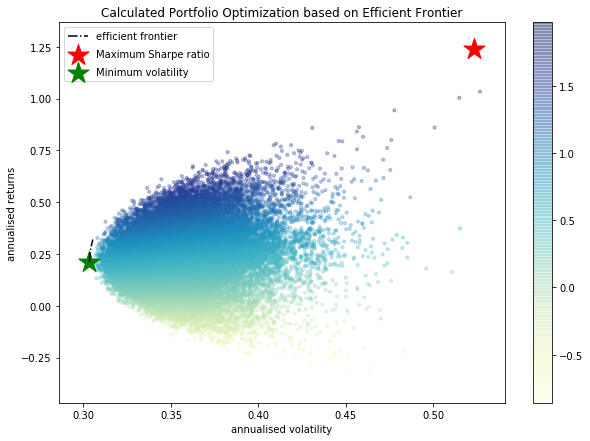

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AJG : annuaised return 0.31 , annualised volatility: 0.38
AMD : annuaised return 1.96 , annualised volatility: 0.88
BAC : annuaised return -0.14 , annualised volatility: 0.52
BIIB : annuaised return 0.39 , annualised volatility: 0.65
CAG : annuaised return -0.0 , annualised volatility: 0.53
CPB : annuaised return 0.25 , annualised volatility: 0.44
ESS : annuaised return 0.07 , annualised volatility: 0.4
MRO : annuaised return -1.12 , annualised volatility: 0.84
NEE : annuaised return 0.52 , annualised volatility: 0.38
--------------------------------------------------------------------------------


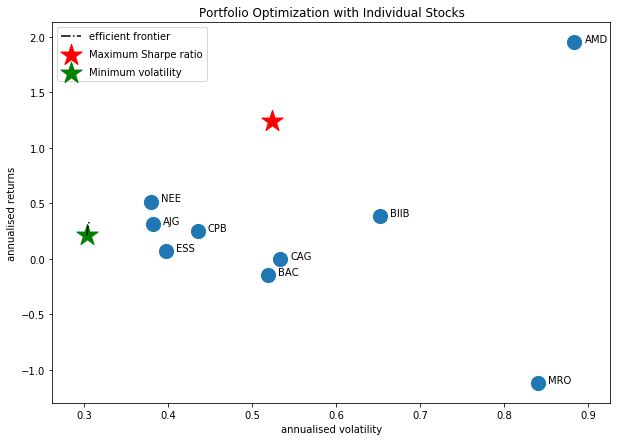

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['ESS', 'AAPL', 'AMD', 'CAG', 'BAC']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



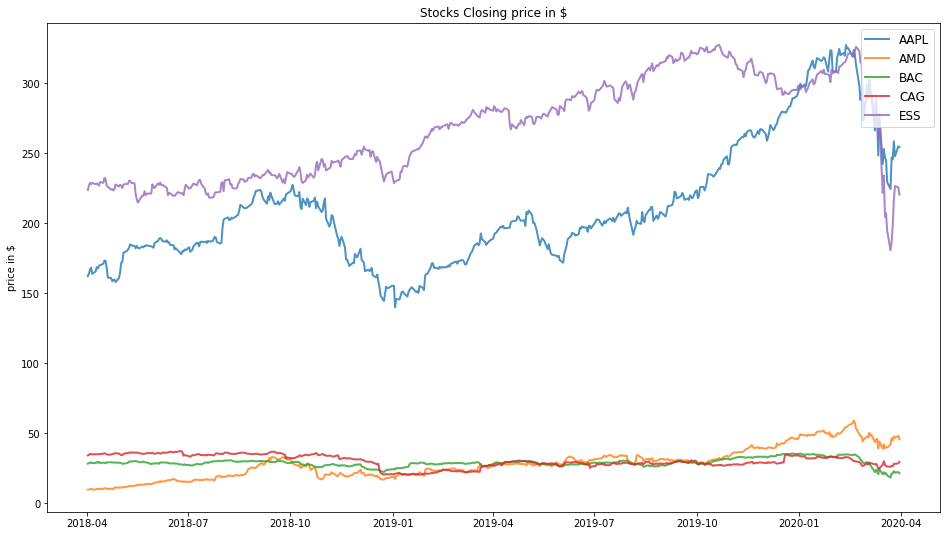

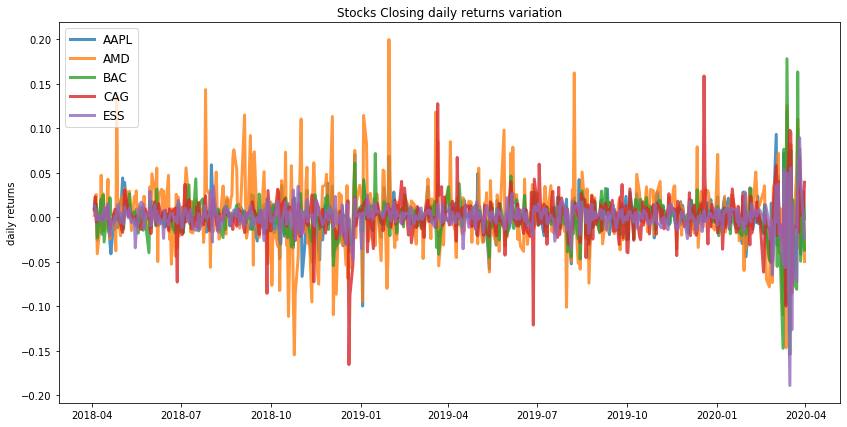

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.96
Annualised Volatility: 0.88


            AAPL    AMD  BAC  CAG  ESS
allocation   0.0  100.0  0.0  0.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.12
Annualised Volatility: 0.34


             AAPL  AMD   BAC    CAG   ESS
allocation  17.62  0.0  6.13  26.65  49.6


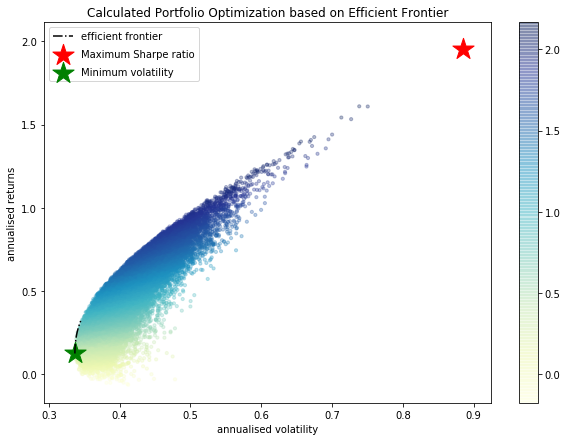

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AAPL : annuaised return 0.57 , annualised volatility: 0.49
AMD : annuaised return 1.96 , annualised volatility: 0.88
BAC : annuaised return -0.14 , annualised volatility: 0.52
CAG : annuaised return -0.0 , annualised volatility: 0.53
ESS : annuaised return 0.07 , annualised volatility: 0.4
--------------------------------------------------------------------------------


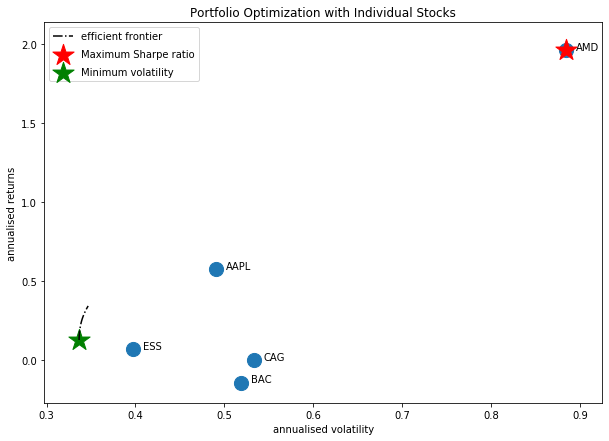

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'AMZN', 'ESS', 'AMD', 'BAC']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



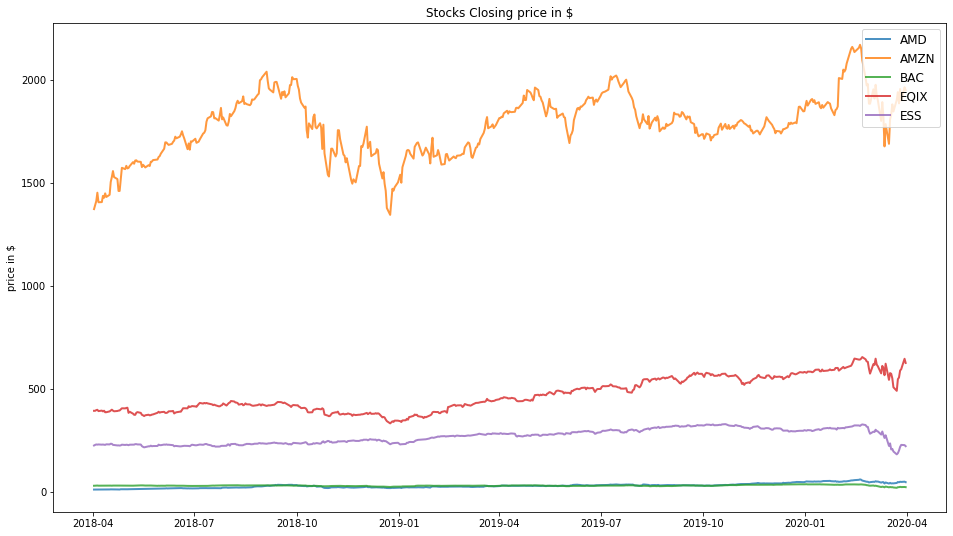

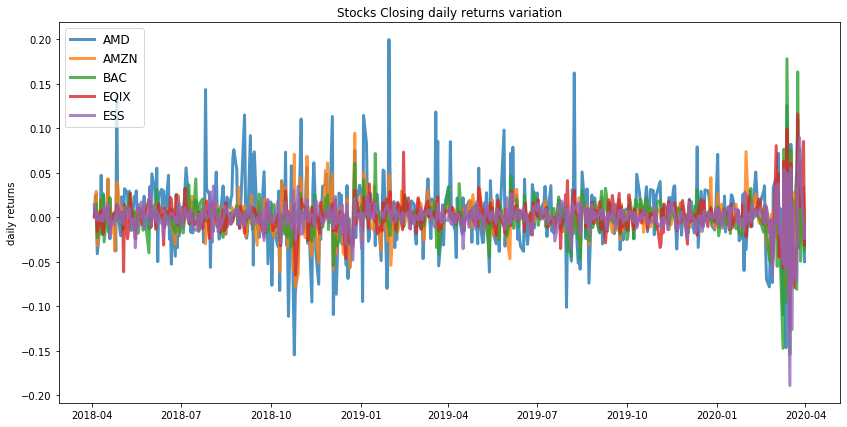

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.43
Annualised Volatility: 0.63


              AMD  AMZN  BAC   EQIX  ESS
allocation  62.48   0.0  0.0  37.52  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.3
Annualised Volatility: 0.33


            AMD   AMZN  BAC   EQIX    ESS
allocation  0.0  35.23  0.0  18.74  46.04


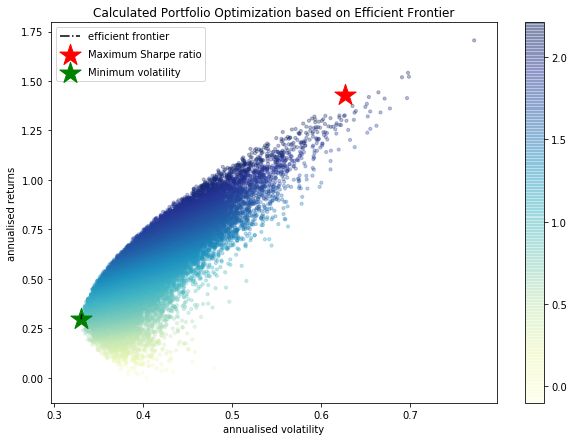

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMD : annuaised return 1.96 , annualised volatility: 0.88
AMZN : annuaised return 0.46 , annualised volatility: 0.45
BAC : annuaised return -0.14 , annualised volatility: 0.52
EQIX : annuaised return 0.56 , annualised volatility: 0.42
ESS : annuaised return 0.07 , annualised volatility: 0.4
--------------------------------------------------------------------------------


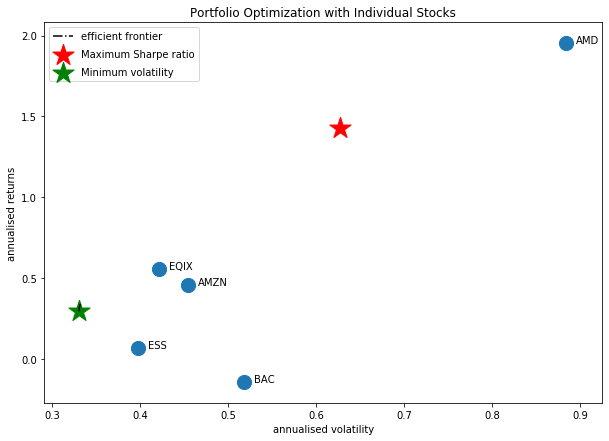

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['NEM', 'ESS']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



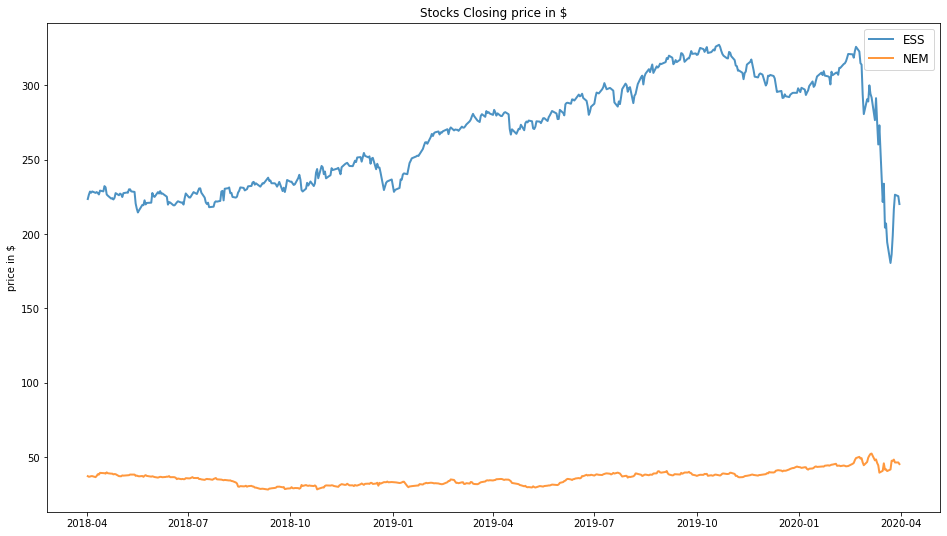

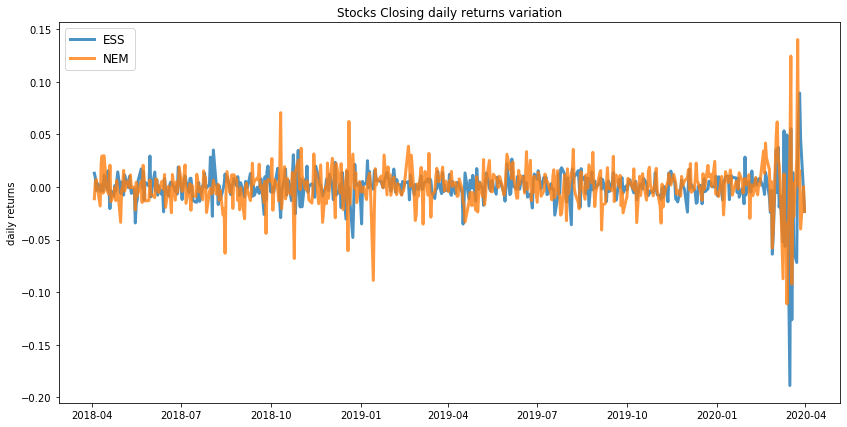

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.29
Annualised Volatility: 0.43


            ESS   NEM
allocation  6.0  94.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.17
Annualised Volatility: 0.32


              ESS    NEM
allocation  58.19  41.81


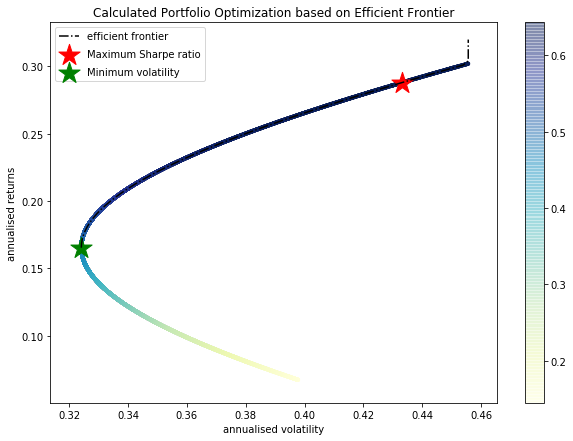

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

ESS : annuaised return 0.07 , annualised volatility: 0.4
NEM : annuaised return 0.3 , annualised volatility: 0.46
--------------------------------------------------------------------------------


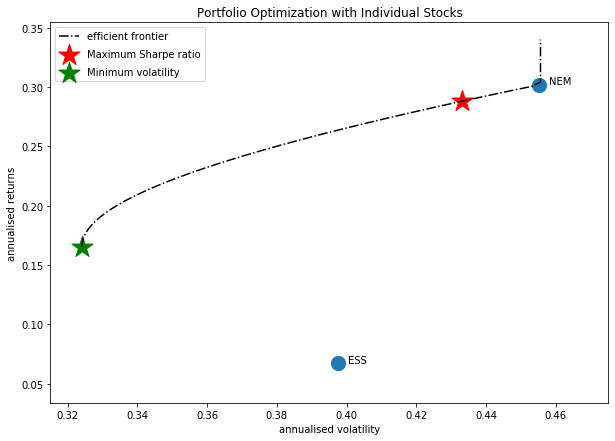

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'AMZN', 'ESS', 'AMD', 'CAG', 'BAC']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



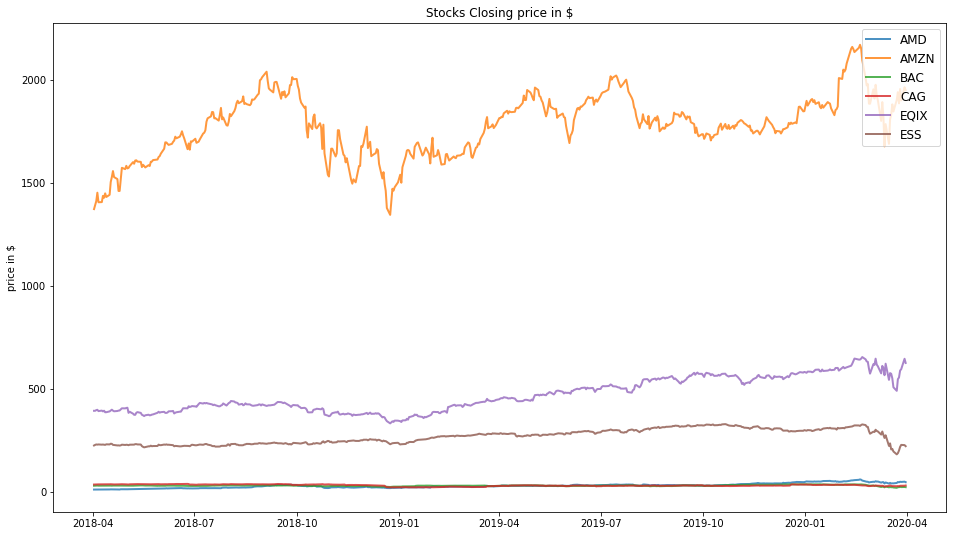

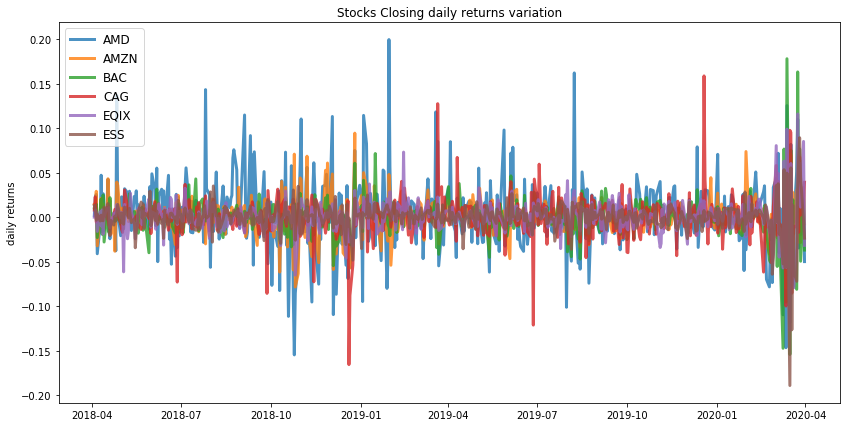

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.43
Annualised Volatility: 0.63


              AMD  AMZN  BAC  CAG   EQIX  ESS
allocation  62.49   0.0  0.0  0.0  37.51  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.23
Annualised Volatility: 0.31


            AMD   AMZN  BAC    CAG   EQIX    ESS
allocation  0.0  29.02  0.0  21.02  12.74  37.23


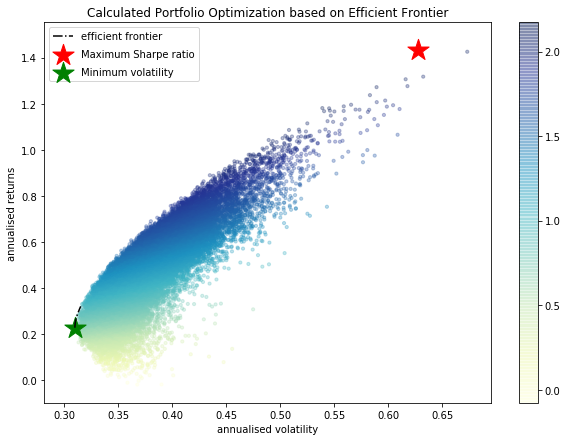

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMD : annuaised return 1.96 , annualised volatility: 0.88
AMZN : annuaised return 0.46 , annualised volatility: 0.45
BAC : annuaised return -0.14 , annualised volatility: 0.52
CAG : annuaised return -0.0 , annualised volatility: 0.53
EQIX : annuaised return 0.56 , annualised volatility: 0.42
ESS : annuaised return 0.07 , annualised volatility: 0.4
--------------------------------------------------------------------------------


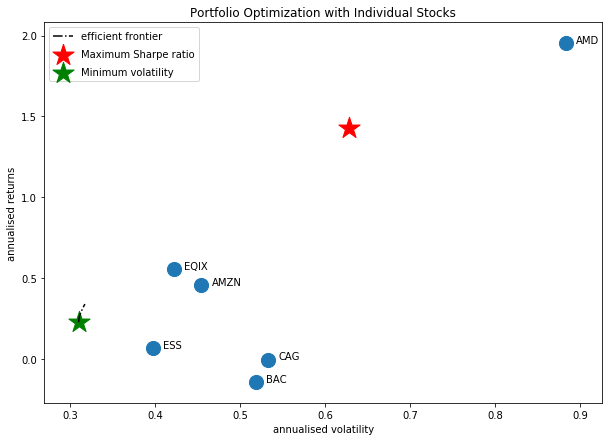

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EMR', 'ESS']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



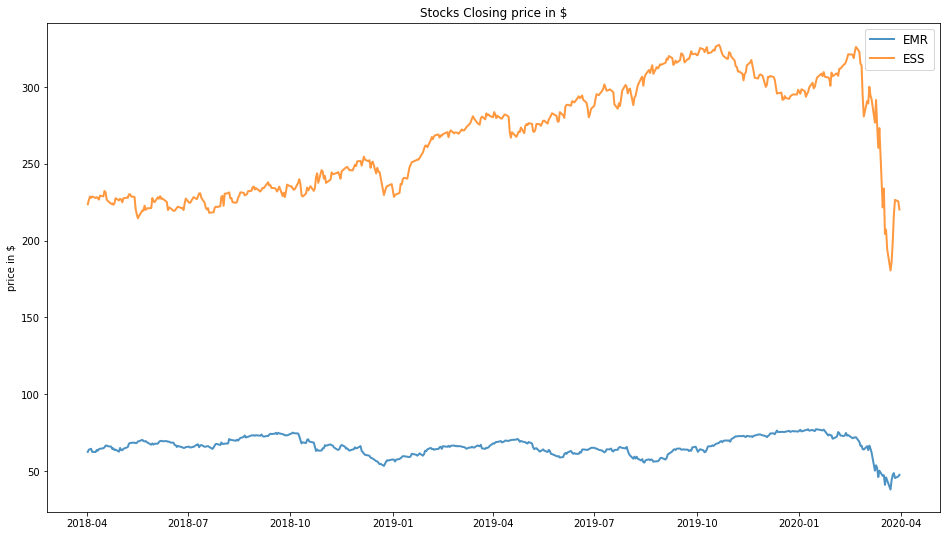

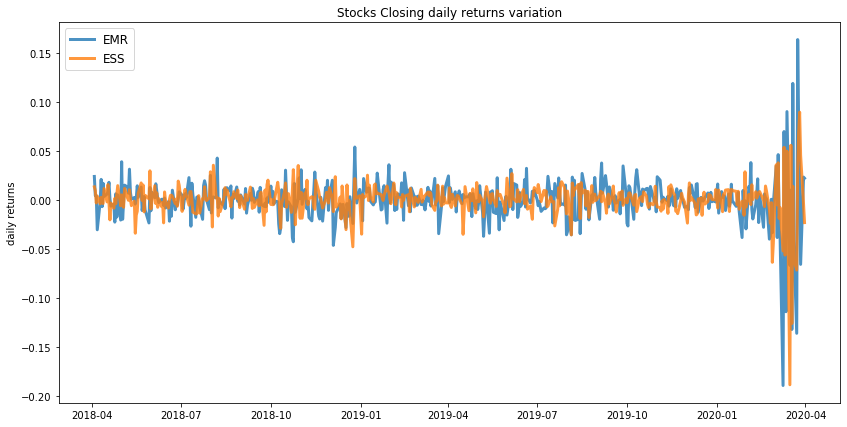

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.07
Annualised Volatility: 0.4


            EMR    ESS
allocation  0.0  100.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.01
Annualised Volatility: 0.38


              EMR    ESS
allocation  26.51  73.49


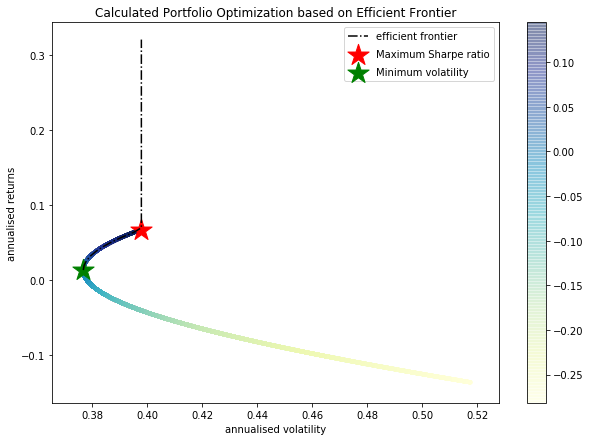

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

EMR : annuaised return -0.14 , annualised volatility: 0.52
ESS : annuaised return 0.07 , annualised volatility: 0.4
--------------------------------------------------------------------------------


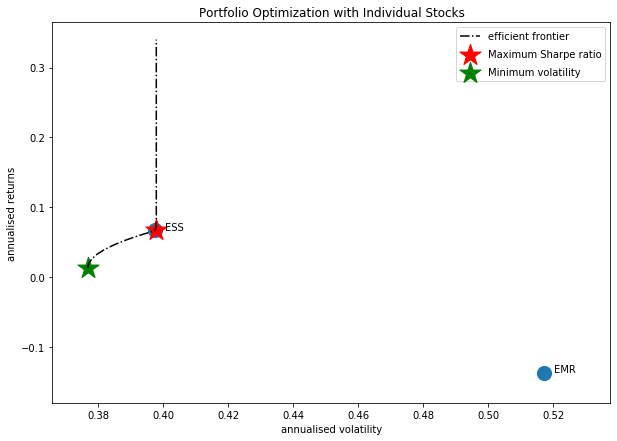

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BKNG', 'NEE', 'ESS', 'AJG', 'BIIB', 'AMD', 'CAG', 'MRO', 'BAC', 'COTY']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



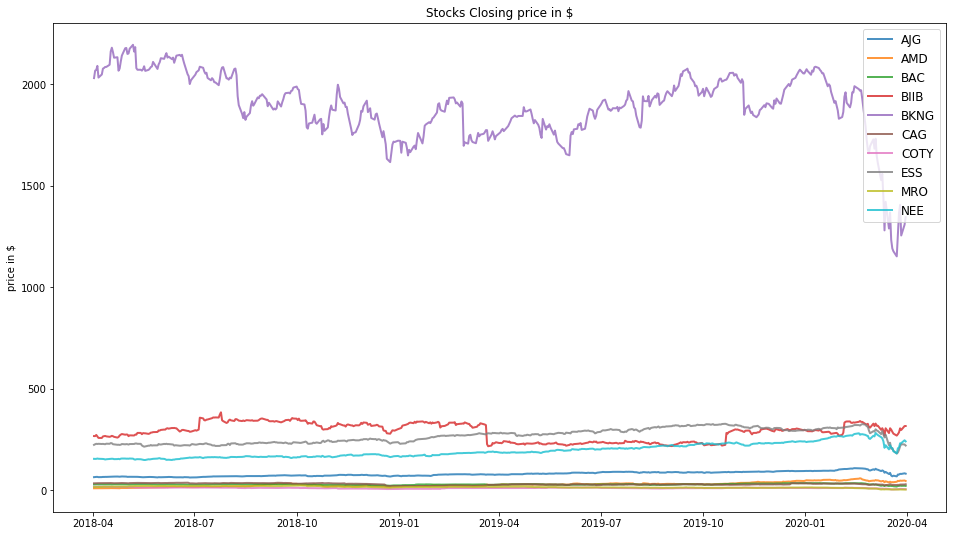

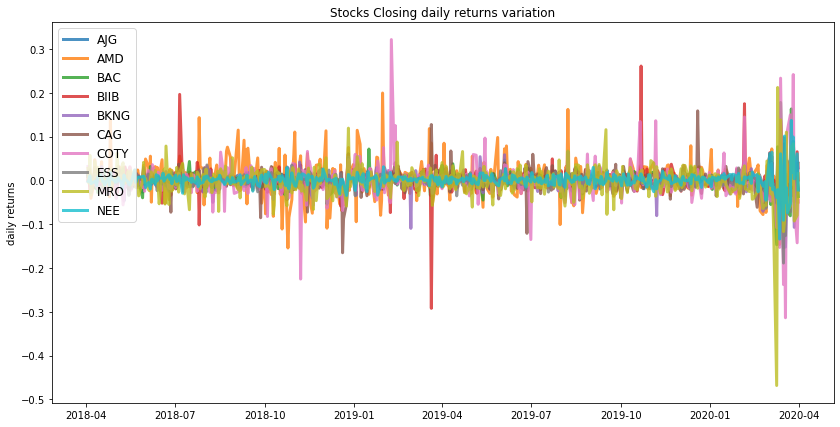

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.24
Annualised Volatility: 0.52


            AJG    AMD  BAC  BIIB  BKNG  CAG  COTY  ESS  MRO    NEE
allocation  0.0  50.19  0.0   0.0   0.0  0.0   0.0  0.0  0.0  49.81
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.17
Annualised Volatility: 0.31


              AJG  AMD  BAC  BIIB  BKNG    CAG  COTY    ESS   MRO    NEE
allocation  15.55  0.0  0.0  8.58  9.55  18.78   0.0  22.19  1.61  23.73


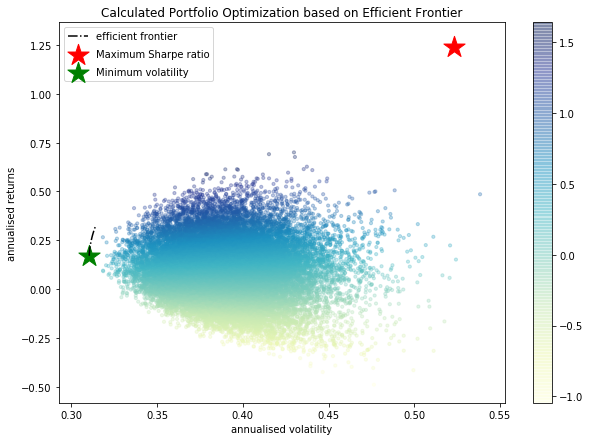

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AJG : annuaised return 0.31 , annualised volatility: 0.38
AMD : annuaised return 1.96 , annualised volatility: 0.88
BAC : annuaised return -0.14 , annualised volatility: 0.52
BIIB : annuaised return 0.39 , annualised volatility: 0.65
BKNG : annuaised return -0.3 , annualised volatility: 0.47
CAG : annuaised return -0.0 , annualised volatility: 0.53
COTY : annuaised return -0.7 , annualised volatility: 0.94
ESS : annuaised return 0.07 , annualised volatility: 0.4
MRO : annuaised return -1.12 , annualised volatility: 0.84
NEE : annuaised return 0.52 , annualised volatility: 0.38
--------------------------------------------------------------------------------


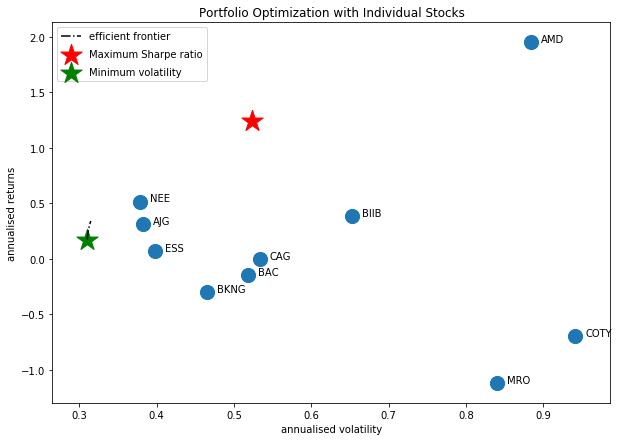

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['GOOGL', 'BKNG', 'NEE', 'ESS', 'AJG', 'BIIB', 'AMD', 'CAG', 'MRO', 'BAC', 'CMCSA']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



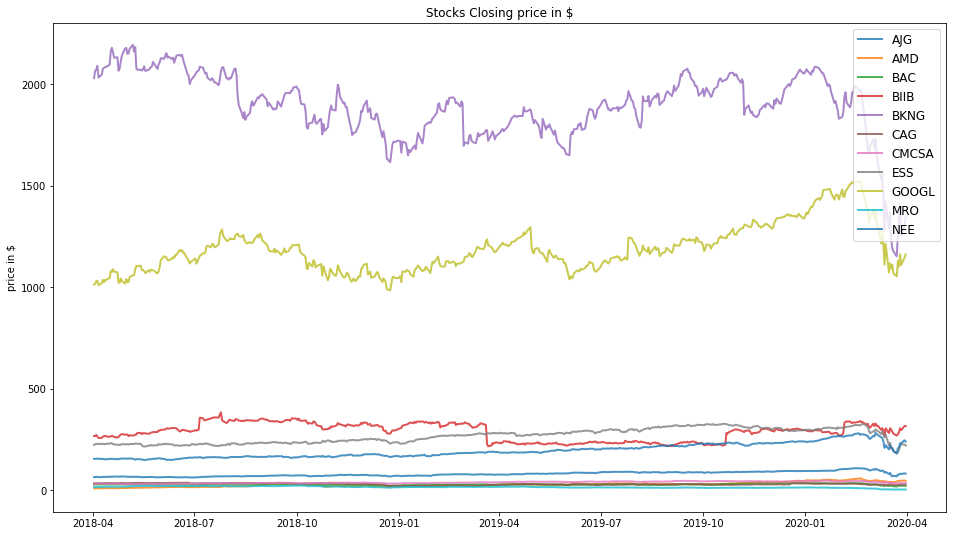

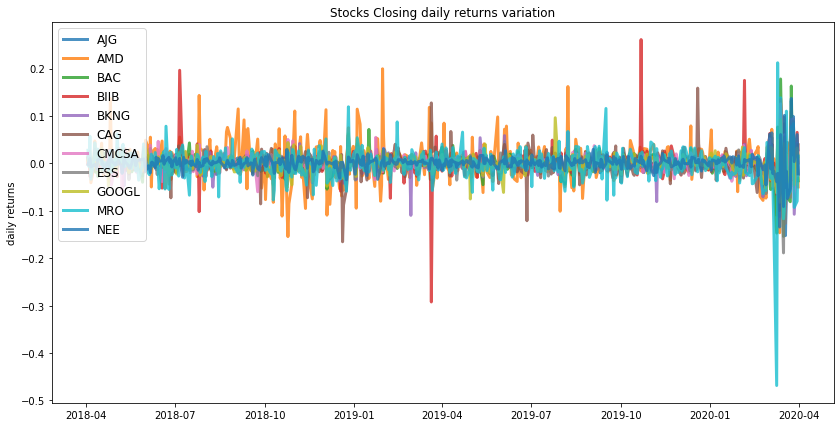

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.24
Annualised Volatility: 0.52


            AJG    AMD  BAC  BIIB  BKNG  CAG  CMCSA  ESS  GOOGL  MRO    NEE
allocation  0.0  50.19  0.0   0.0   0.0  0.0    0.0  0.0    0.0  0.0  49.81
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.23
Annualised Volatility: 0.3


             AJG  AMD  BAC  BIIB  BKNG   CAG  CMCSA    ESS  GOOGL  MRO    NEE
allocation  9.18  0.0  0.0  6.31  0.23  16.9  14.61  17.18  15.55  0.0  20.03


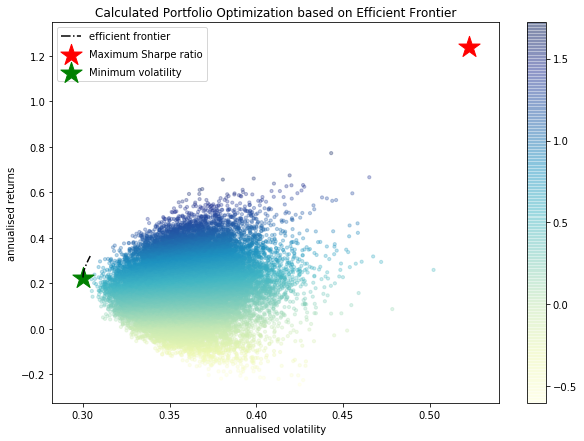

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AJG : annuaised return 0.31 , annualised volatility: 0.38
AMD : annuaised return 1.96 , annualised volatility: 0.88
BAC : annuaised return -0.14 , annualised volatility: 0.52
BIIB : annuaised return 0.39 , annualised volatility: 0.65
BKNG : annuaised return -0.3 , annualised volatility: 0.47
CAG : annuaised return -0.0 , annualised volatility: 0.53
CMCSA : annuaised return 0.16 , annualised volatility: 0.42
ESS : annuaised return 0.07 , annualised volatility: 0.4
GOOGL : annuaised return 0.23 , annualised volatility: 0.43
MRO : annuaised return -1.12 , annualised volatility: 0.84
NEE : annuaised return 0.52 , annualised volatility: 0.38
--------------------------------------------------------------------------------


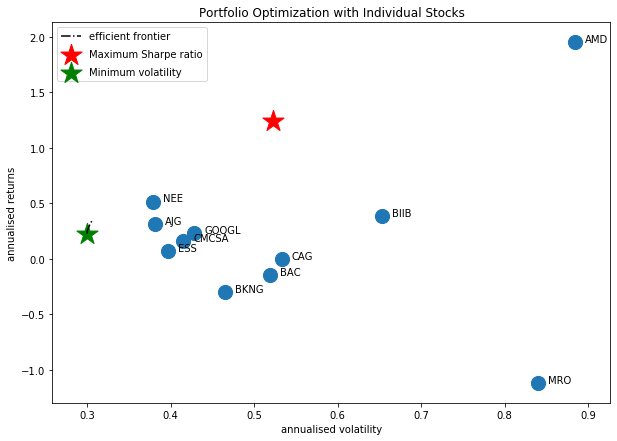

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BKNG', 'NEE', 'ESS', 'AJG', 'BIIB', 'AMD', 'CAG', 'MRO', 'BAC', 'EXC']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



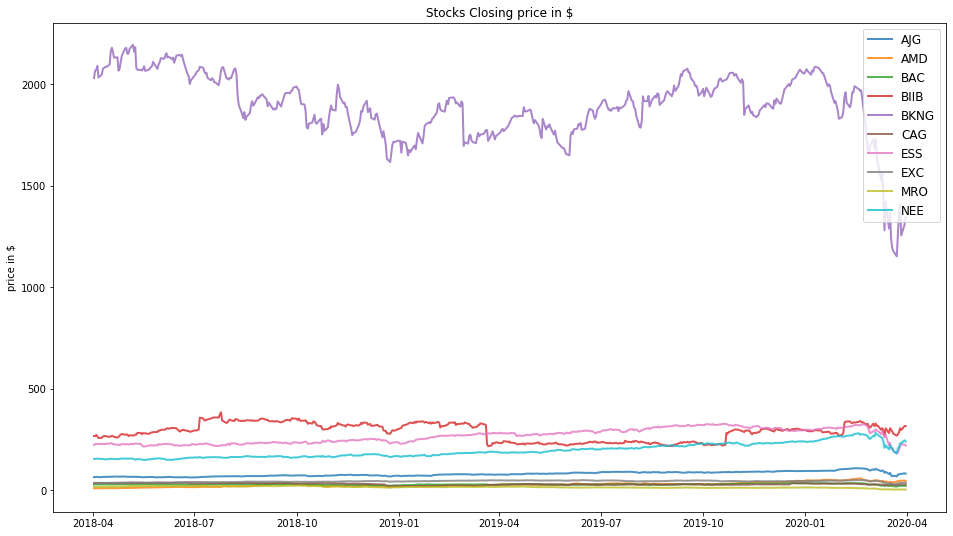

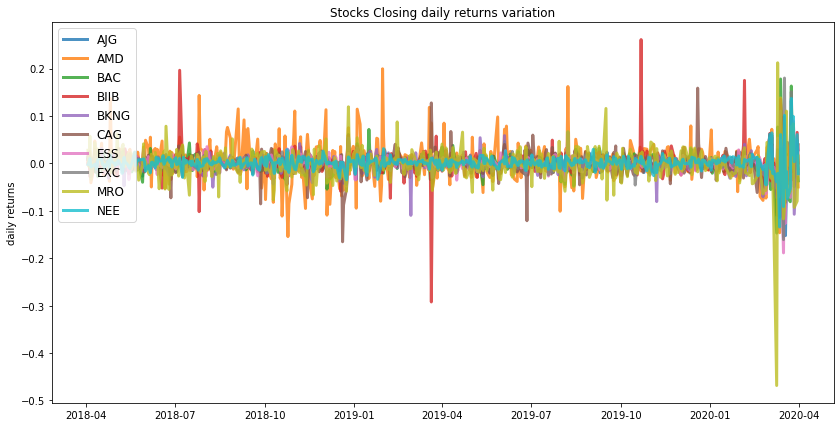

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.24
Annualised Volatility: 0.52


            AJG    AMD  BAC  BIIB  BKNG  CAG  ESS  EXC  MRO    NEE
allocation  0.0  50.17  0.0   0.0   0.0  0.0  0.0  0.0  0.0  49.83
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.17
Annualised Volatility: 0.31


              AJG  AMD  BAC  BIIB  BKNG    CAG    ESS  EXC   MRO    NEE
allocation  15.37  0.0  0.0   8.6  9.59  18.81  22.21  0.0  1.63  23.79


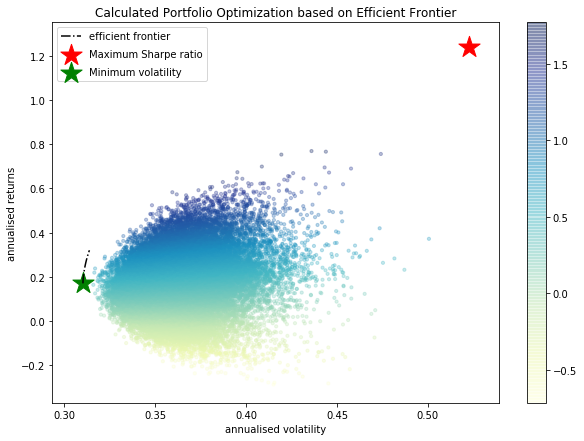

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AJG : annuaised return 0.31 , annualised volatility: 0.38
AMD : annuaised return 1.96 , annualised volatility: 0.88
BAC : annuaised return -0.14 , annualised volatility: 0.52
BIIB : annuaised return 0.39 , annualised volatility: 0.65
BKNG : annuaised return -0.3 , annualised volatility: 0.47
CAG : annuaised return -0.0 , annualised volatility: 0.53
ESS : annuaised return 0.07 , annualised volatility: 0.4
EXC : annuaised return 0.11 , annualised volatility: 0.43
MRO : annuaised return -1.12 , annualised volatility: 0.84
NEE : annuaised return 0.52 , annualised volatility: 0.38
--------------------------------------------------------------------------------


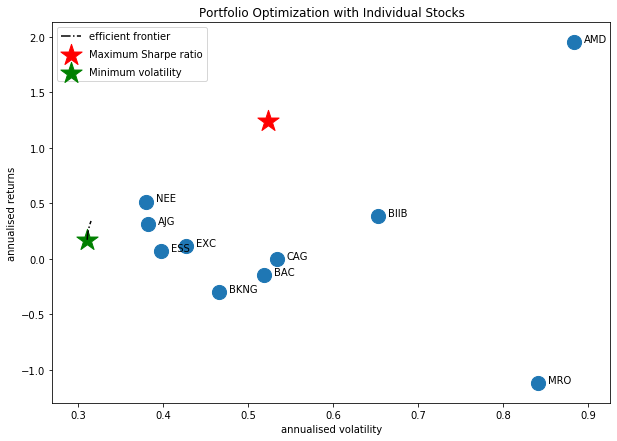

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EFX', 'AMD']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



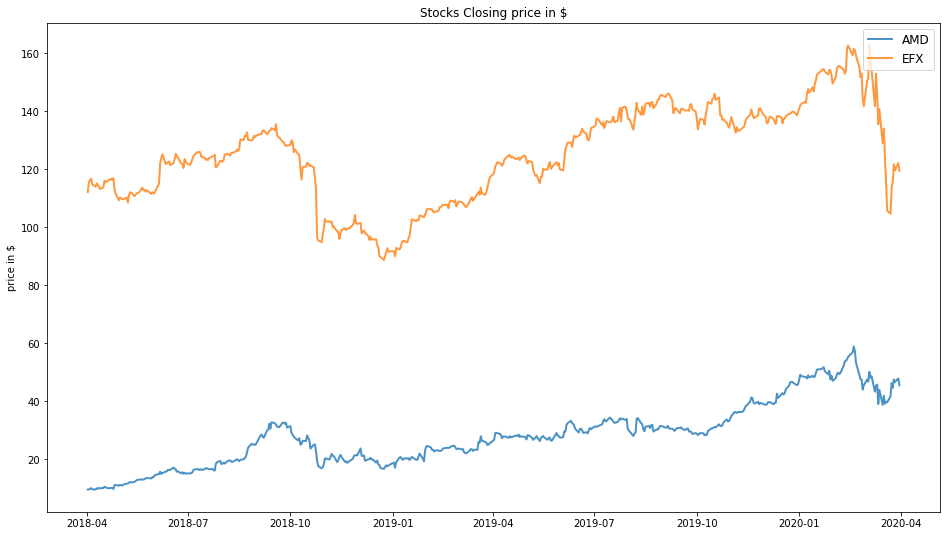

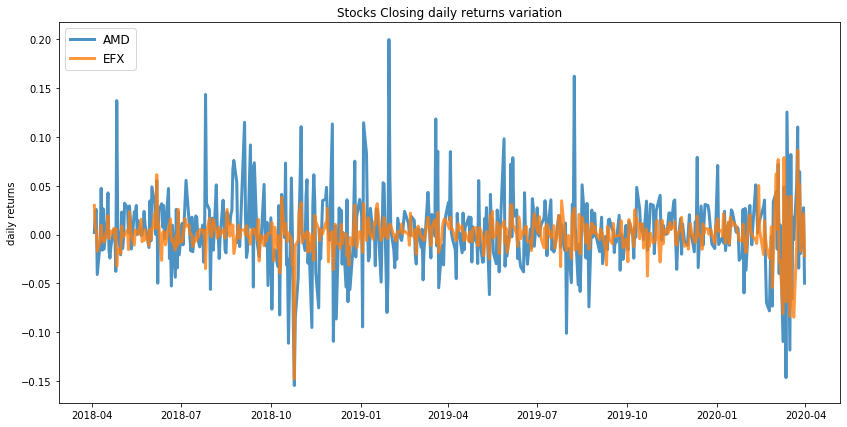

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.96
Annualised Volatility: 0.88


              AMD  EFX
allocation  100.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.17
Annualised Volatility: 0.42


             AMD    EFX
allocation  0.93  99.07


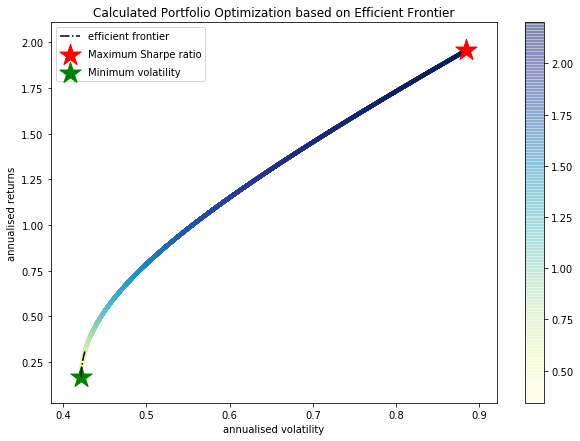

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMD : annuaised return 1.96 , annualised volatility: 0.88
EFX : annuaised return 0.15 , annualised volatility: 0.42
--------------------------------------------------------------------------------


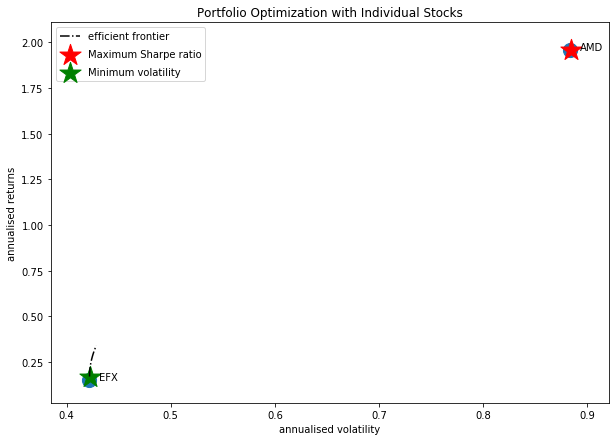

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EFX', 'BAC']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



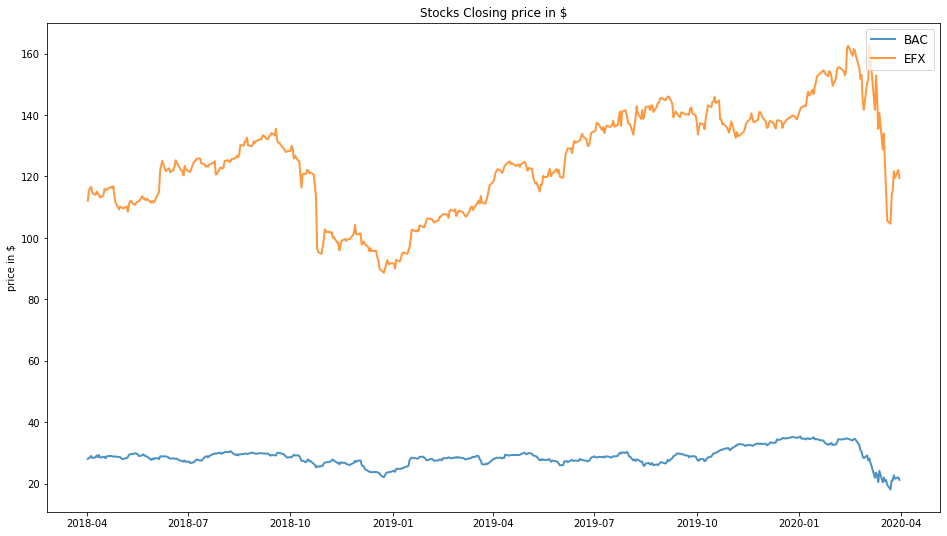

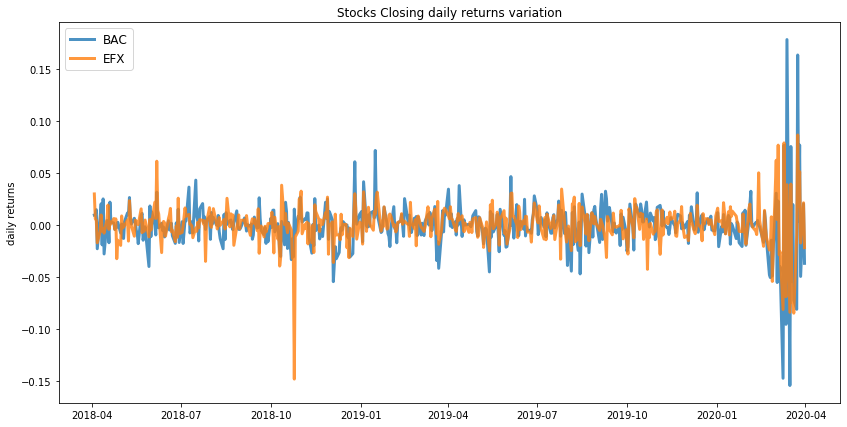

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.15
Annualised Volatility: 0.42


            BAC    EFX
allocation  0.0  100.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.07
Annualised Volatility: 0.41


              BAC    EFX
allocation  26.49  73.51


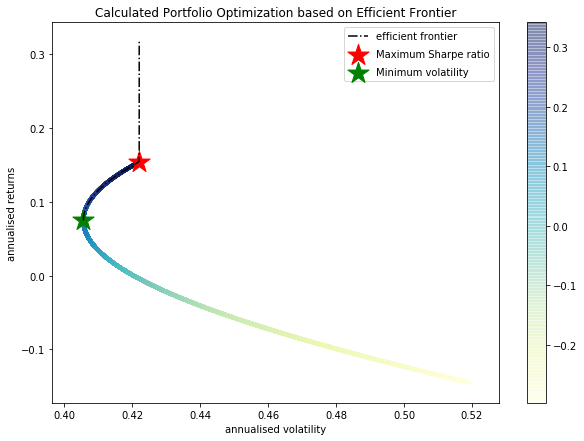

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

BAC : annuaised return -0.14 , annualised volatility: 0.52
EFX : annuaised return 0.15 , annualised volatility: 0.42
--------------------------------------------------------------------------------


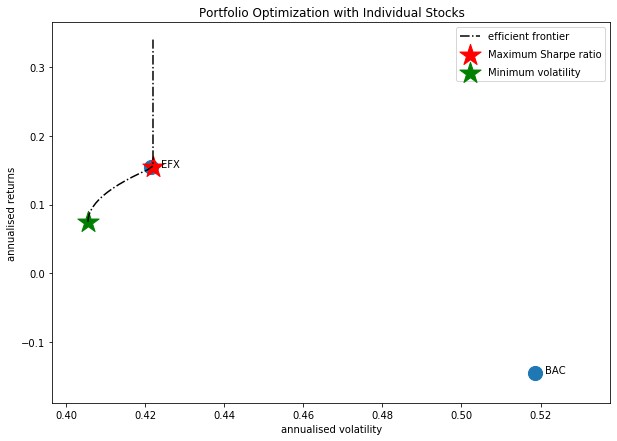

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BLK', 'AMD']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



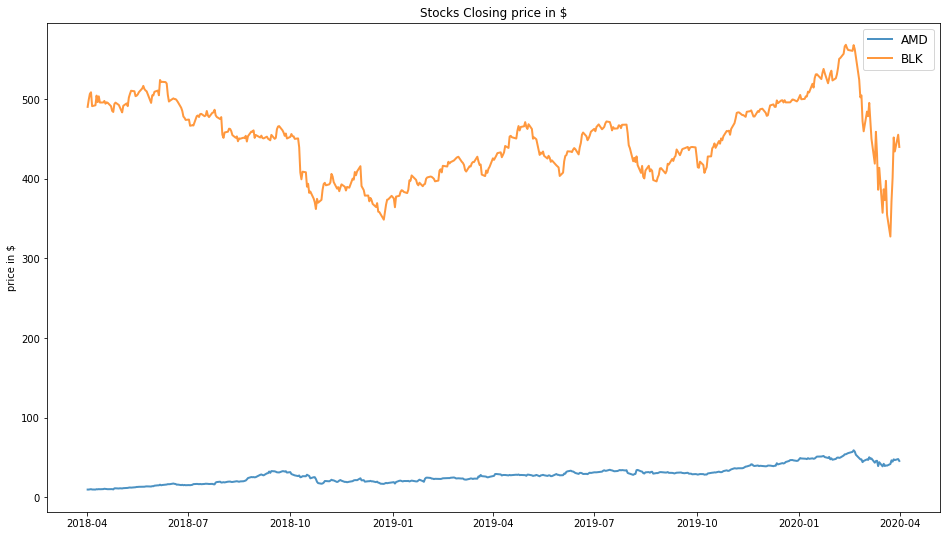

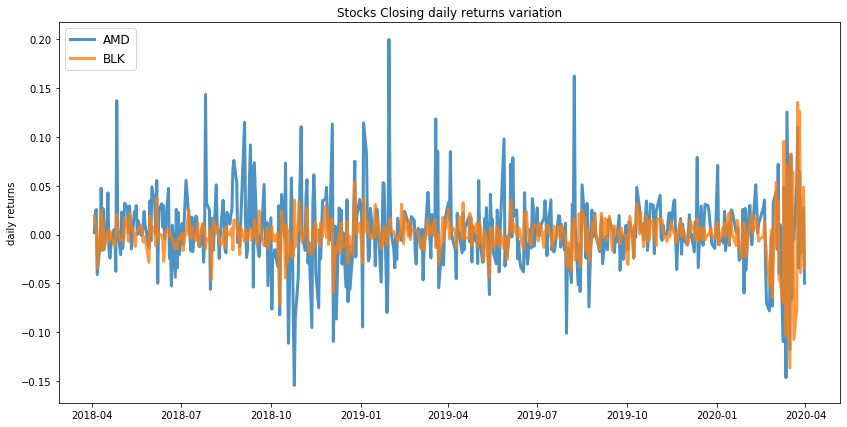

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.96
Annualised Volatility: 0.88


              AMD  BLK
allocation  100.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.16
Annualised Volatility: 0.49


             AMD    BLK
allocation  7.81  92.19


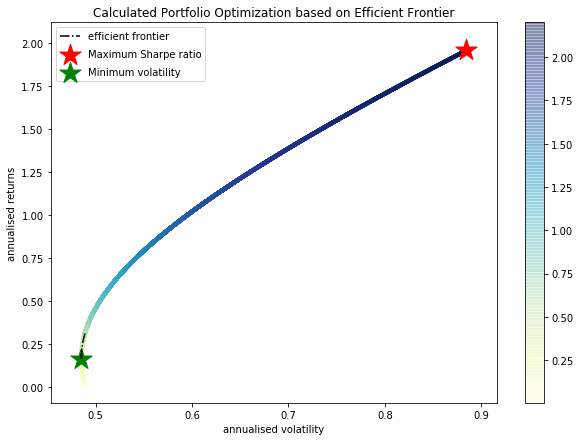

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMD : annuaised return 1.96 , annualised volatility: 0.88
BLK : annuaised return 0.01 , annualised volatility: 0.49
--------------------------------------------------------------------------------


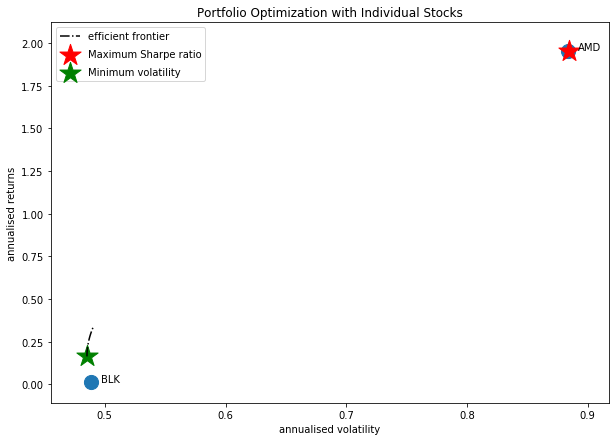

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BKNG', 'ESS', 'AJG', 'BIIB', 'AMD', 'MRO', 'BAC', 'HP']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



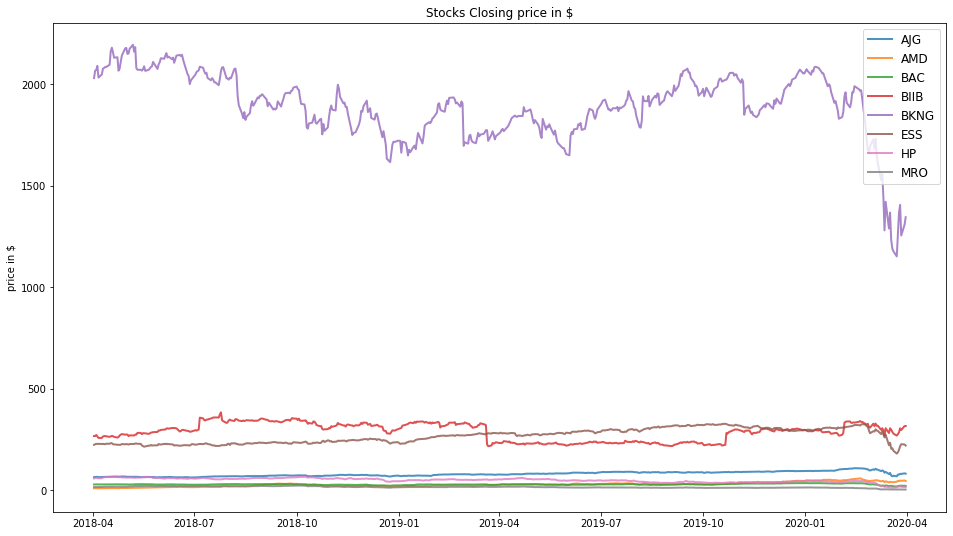

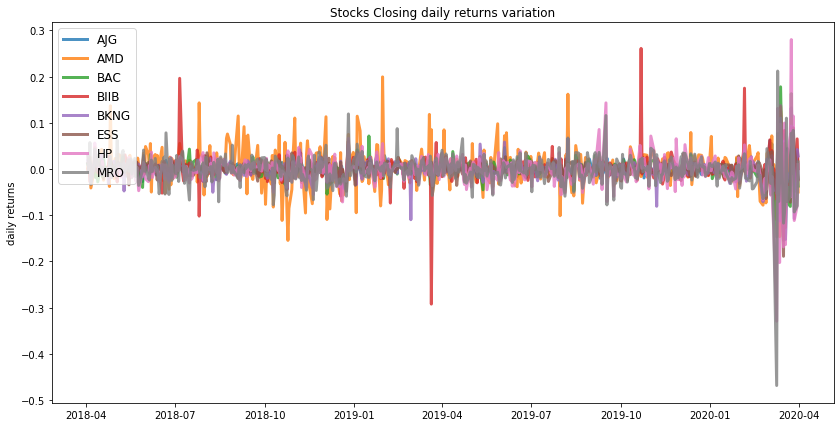

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.82
Annualised Volatility: 0.82


            AJG    AMD  BAC  BIIB  BKNG  ESS   HP  MRO
allocation  0.0  91.18  0.0  8.82   0.0  0.0  0.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.12
Annualised Volatility: 0.34


              AJG  AMD  BAC  BIIB   BKNG    ESS   HP   MRO
allocation  36.36  0.0  0.0  9.91  15.63  37.67  0.0  0.43


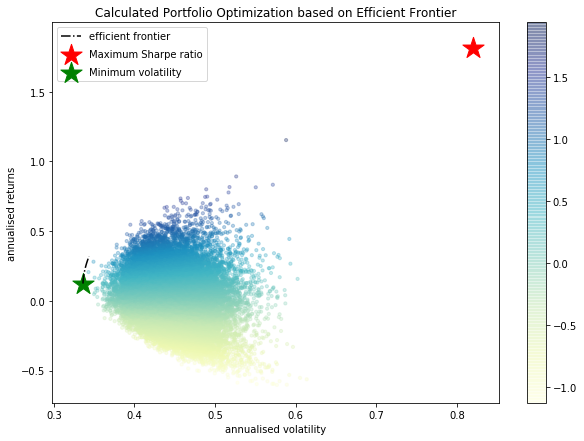

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AJG : annuaised return 0.31 , annualised volatility: 0.38
AMD : annuaised return 1.96 , annualised volatility: 0.88
BAC : annuaised return -0.14 , annualised volatility: 0.52
BIIB : annuaised return 0.39 , annualised volatility: 0.65
BKNG : annuaised return -0.3 , annualised volatility: 0.47
ESS : annuaised return 0.07 , annualised volatility: 0.4
HP : annuaised return -0.97 , annualised volatility: 0.81
MRO : annuaised return -1.12 , annualised volatility: 0.84
--------------------------------------------------------------------------------


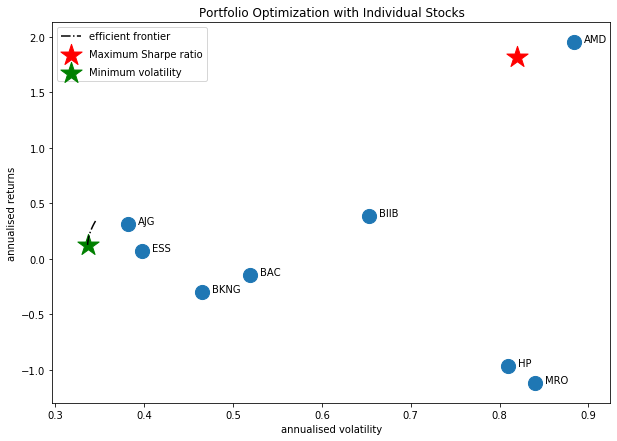

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['ESS', 'AJG', 'BIIB', 'AAPL', 'AMD', 'CAG', 'MRO', 'BAC']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



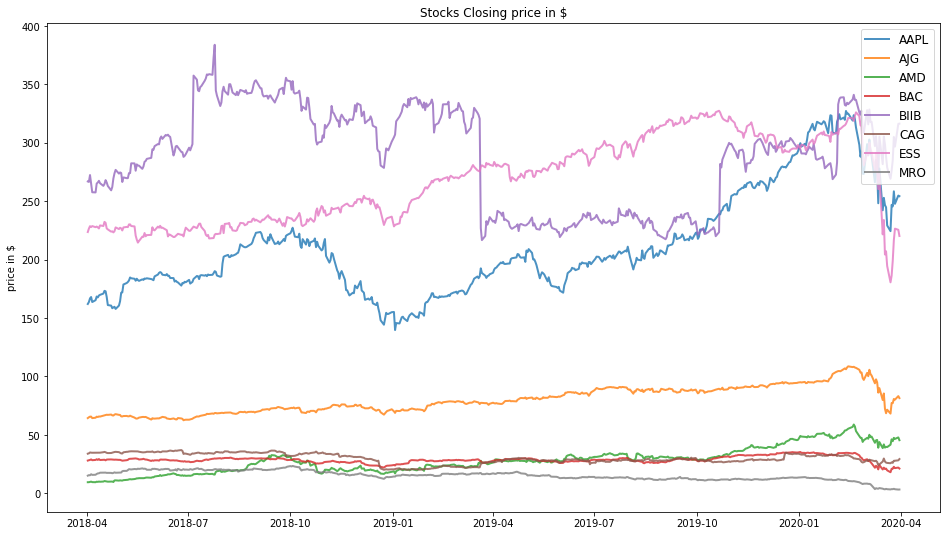

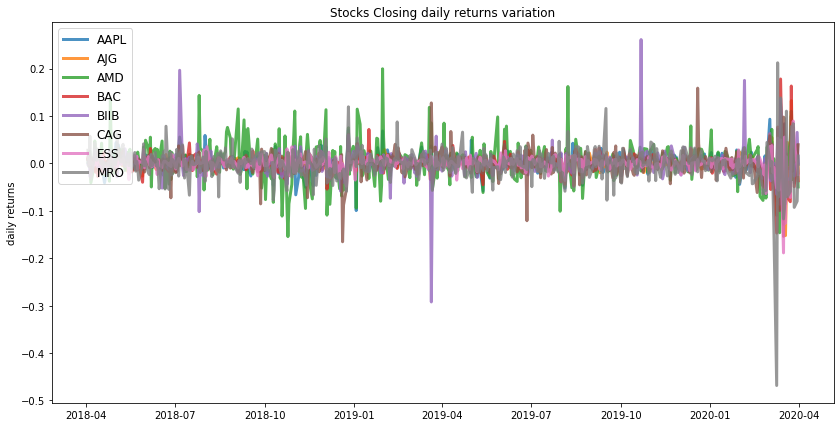

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.82
Annualised Volatility: 0.82


            AAPL  AJG    AMD  BAC  BIIB  CAG  ESS  MRO
allocation   0.0  0.0  91.18  0.0  8.82  0.0  0.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.19
Annualised Volatility: 0.32


            AAPL    AJG  AMD  BAC   BIIB    CAG    ESS   MRO
allocation  6.95  26.83  0.0  0.0  11.44  21.85  32.63  0.29


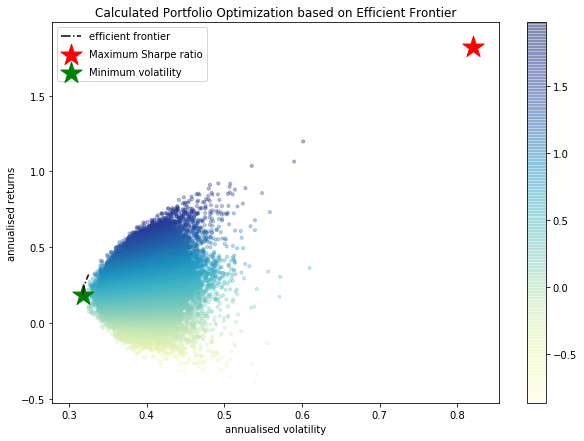

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AAPL : annuaised return 0.57 , annualised volatility: 0.49
AJG : annuaised return 0.31 , annualised volatility: 0.38
AMD : annuaised return 1.96 , annualised volatility: 0.88
BAC : annuaised return -0.14 , annualised volatility: 0.52
BIIB : annuaised return 0.39 , annualised volatility: 0.65
CAG : annuaised return -0.0 , annualised volatility: 0.53
ESS : annuaised return 0.07 , annualised volatility: 0.4
MRO : annuaised return -1.12 , annualised volatility: 0.84
--------------------------------------------------------------------------------


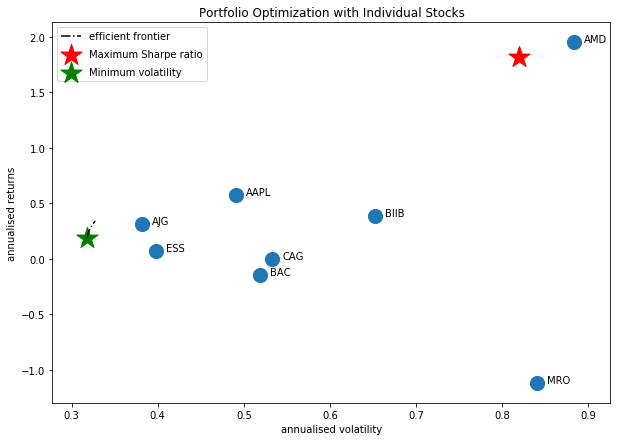

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['ESS', 'AJG', 'BIIB', 'AAPL', 'AMD', 'MRO', 'BAC', 'COTY']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



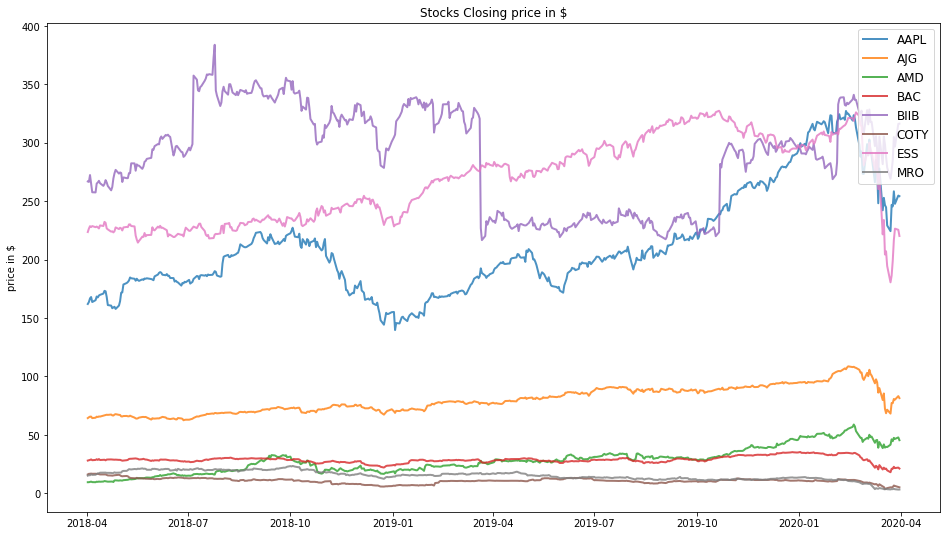

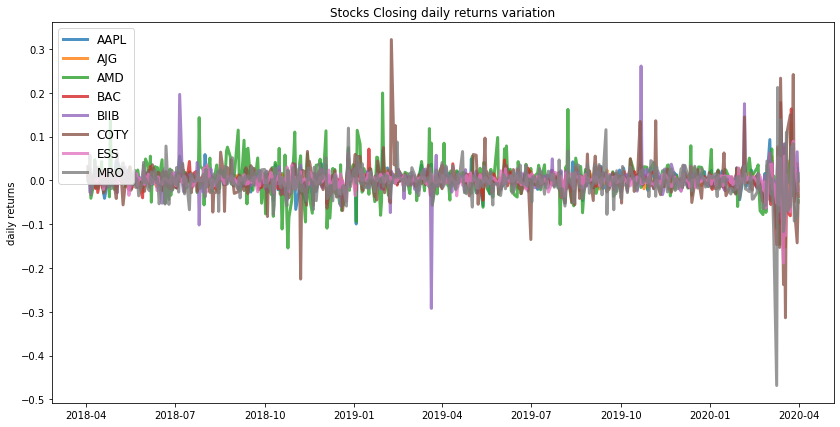

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.82
Annualised Volatility: 0.82


            AAPL  AJG    AMD  BAC  BIIB  COTY  ESS  MRO
allocation   0.0  0.0  91.18  0.0  8.82   0.0  0.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.25
Annualised Volatility: 0.34


             AAPL    AJG  AMD  BAC   BIIB  COTY    ESS  MRO
allocation  10.04  40.62  0.0  0.0  11.19   0.0  37.86  0.3


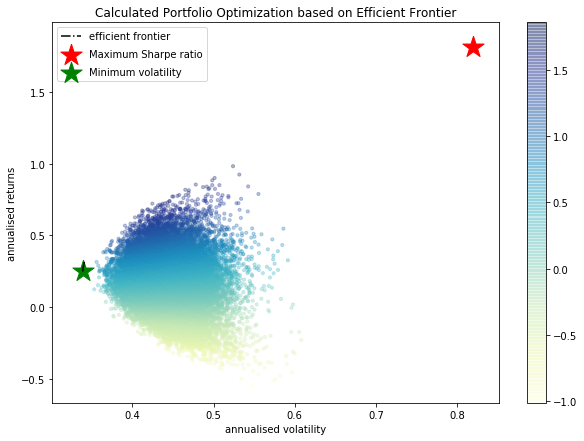

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AAPL : annuaised return 0.57 , annualised volatility: 0.49
AJG : annuaised return 0.31 , annualised volatility: 0.38
AMD : annuaised return 1.96 , annualised volatility: 0.88
BAC : annuaised return -0.14 , annualised volatility: 0.52
BIIB : annuaised return 0.39 , annualised volatility: 0.65
COTY : annuaised return -0.7 , annualised volatility: 0.94
ESS : annuaised return 0.07 , annualised volatility: 0.4
MRO : annuaised return -1.12 , annualised volatility: 0.84
--------------------------------------------------------------------------------


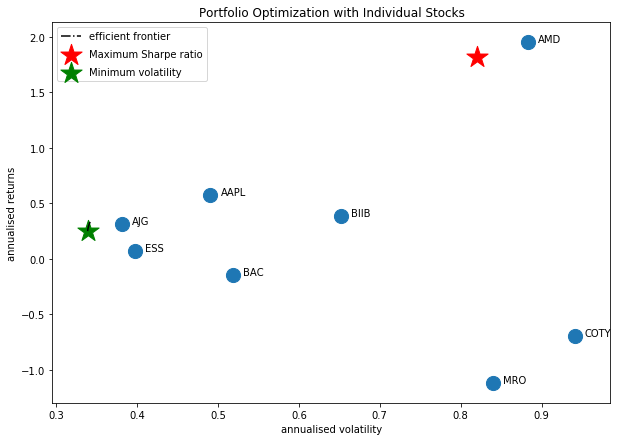

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['CBS', 'AMD']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



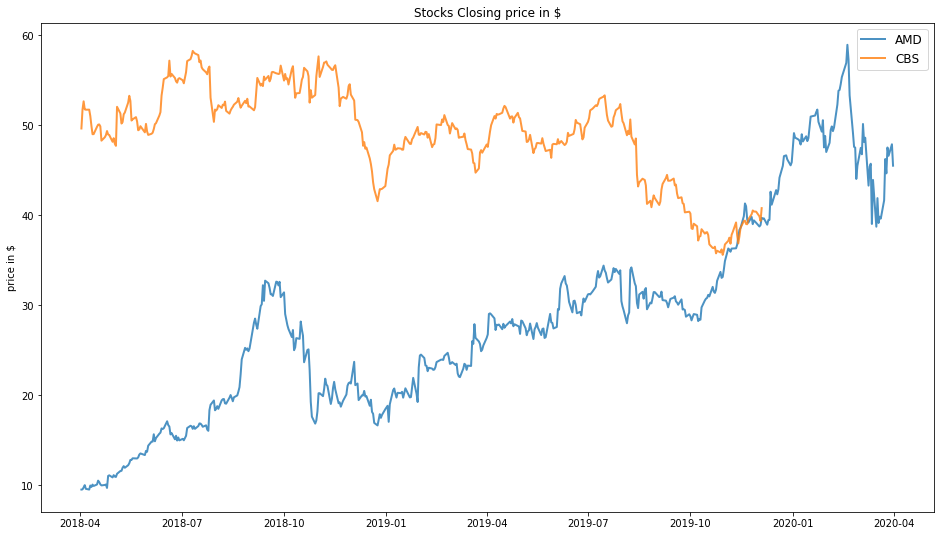

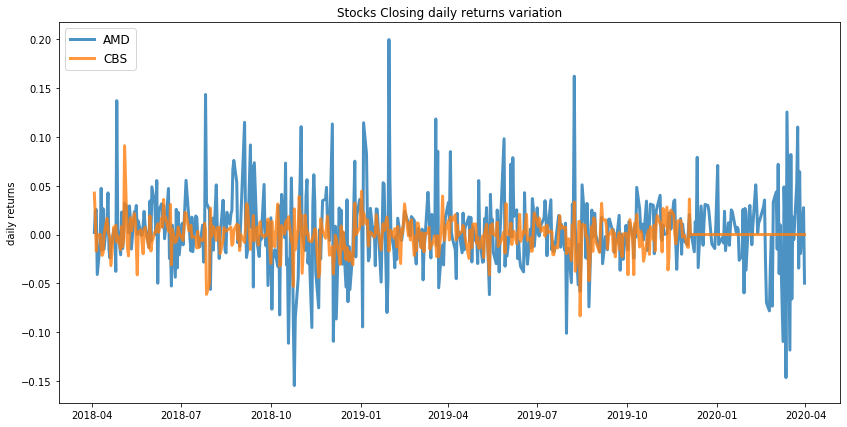

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.96
Annualised Volatility: 0.88


              AMD  CBS
allocation  100.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.04
Annualised Volatility: 0.34


             AMD    CBS
allocation  8.53  91.47


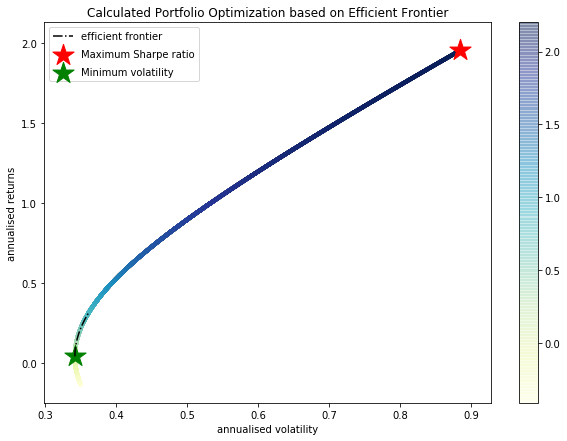

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMD : annuaised return 1.96 , annualised volatility: 0.88
CBS : annuaised return -0.14 , annualised volatility: 0.35
--------------------------------------------------------------------------------


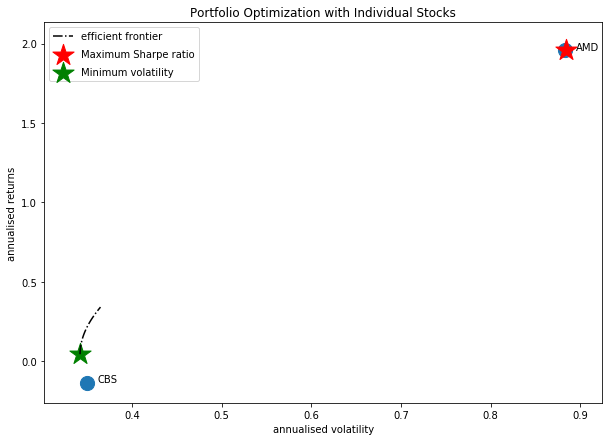

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BAC', 'CBS']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



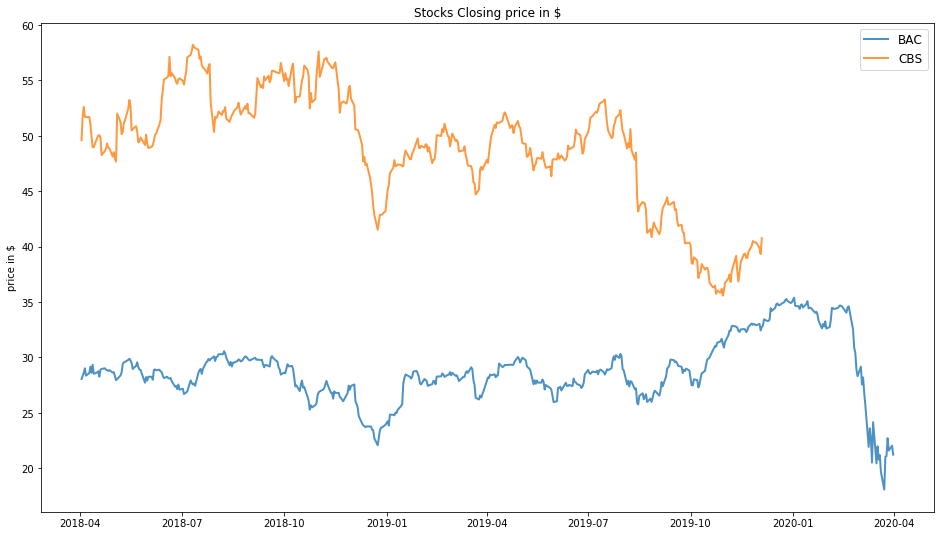

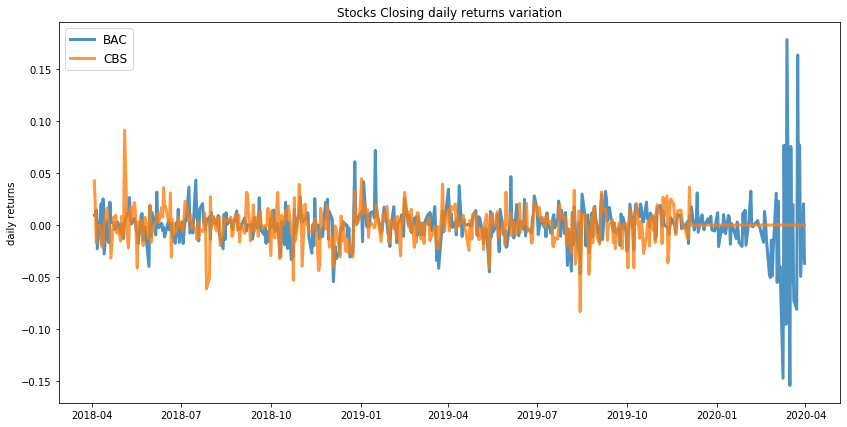

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: -0.14
Annualised Volatility: 0.52


              BAC  CBS
allocation  100.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: -0.14
Annualised Volatility: 0.32


              BAC    CBS
allocation  26.35  73.65


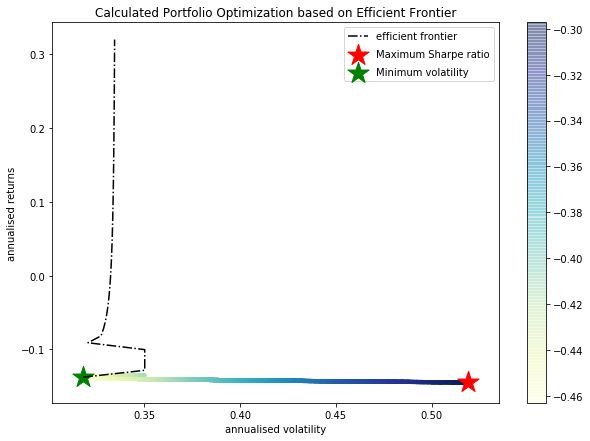

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

BAC : annuaised return -0.14 , annualised volatility: 0.52
CBS : annuaised return -0.14 , annualised volatility: 0.35
--------------------------------------------------------------------------------


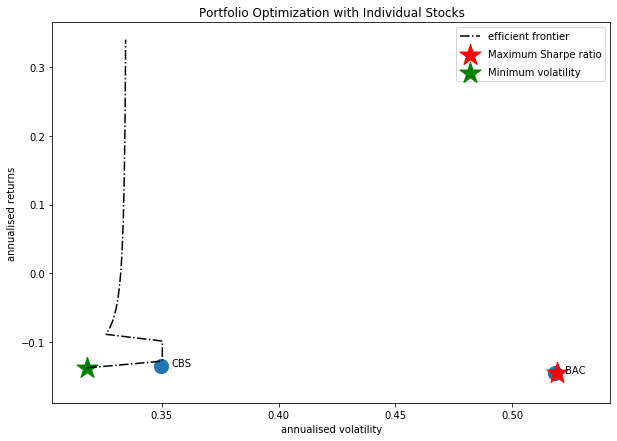

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['NEE', 'ESS', 'AJG', 'BIIB', 'AMD', 'CAG', 'MRO', 'BAC', 'CMCSA']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



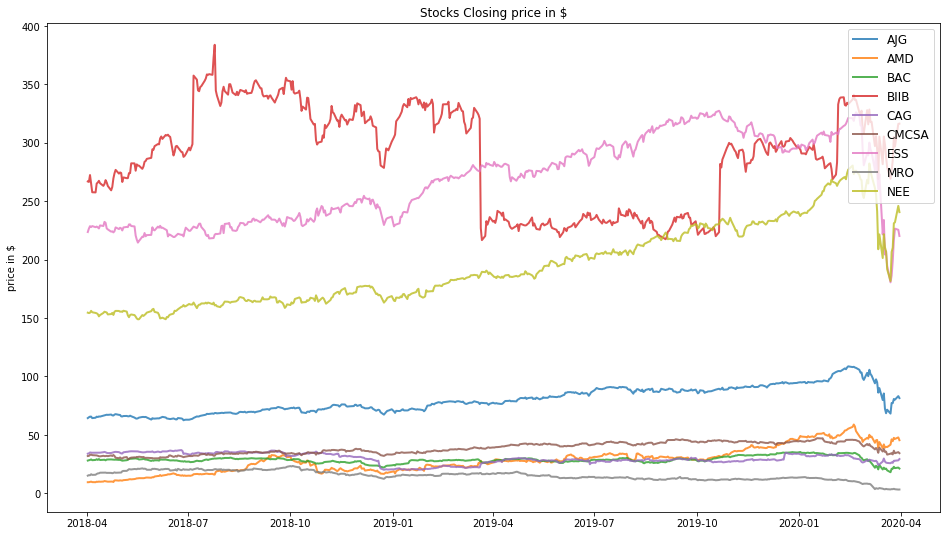

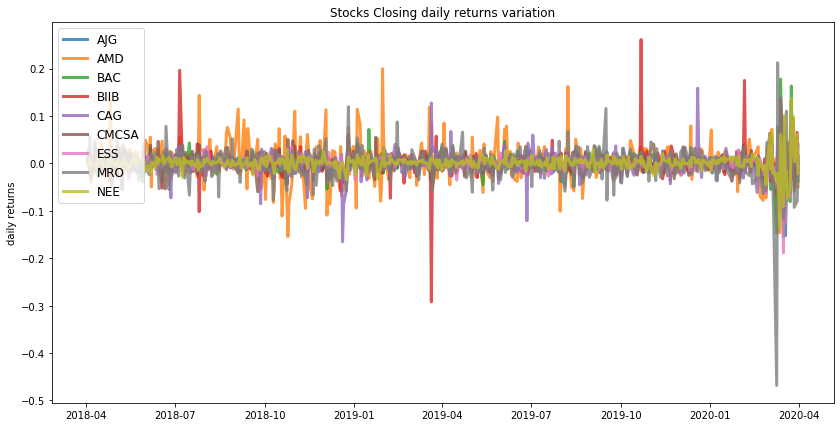

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.24
Annualised Volatility: 0.52


            AJG    AMD  BAC  BIIB  CAG  CMCSA  ESS  MRO    NEE
allocation  0.0  50.25  0.0   0.0  0.0    0.0  0.0  0.0  49.75
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.23
Annualised Volatility: 0.3


              AJG  AMD  BAC  BIIB   CAG  CMCSA    ESS   MRO    NEE
allocation  15.03  0.0  0.0  7.95  17.1  20.48  18.75  0.18  20.51


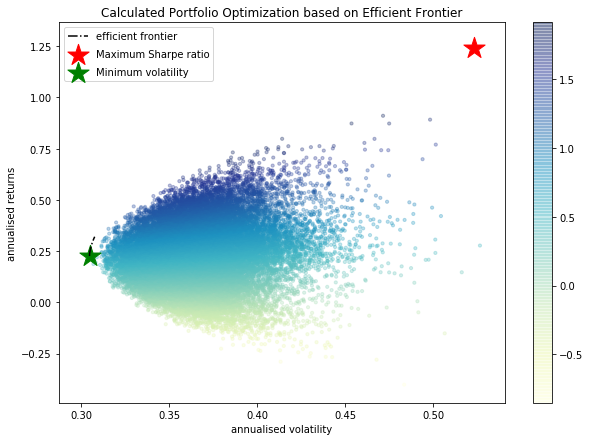

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AJG : annuaised return 0.31 , annualised volatility: 0.38
AMD : annuaised return 1.96 , annualised volatility: 0.88
BAC : annuaised return -0.14 , annualised volatility: 0.52
BIIB : annuaised return 0.39 , annualised volatility: 0.65
CAG : annuaised return -0.0 , annualised volatility: 0.53
CMCSA : annuaised return 0.16 , annualised volatility: 0.42
ESS : annuaised return 0.07 , annualised volatility: 0.4
MRO : annuaised return -1.12 , annualised volatility: 0.84
NEE : annuaised return 0.52 , annualised volatility: 0.38
--------------------------------------------------------------------------------


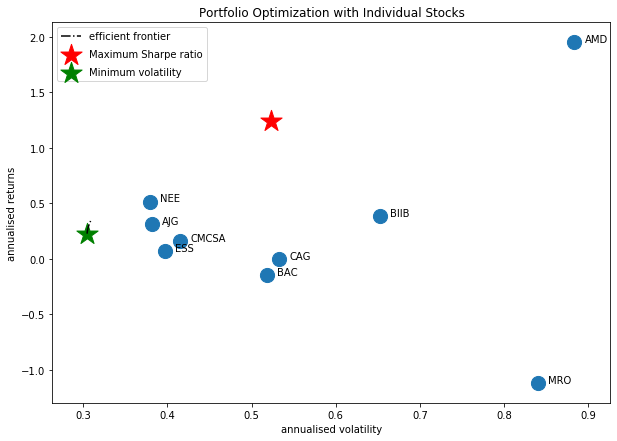

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['GOOG', 'NEE', 'ESS', 'AJG', 'BIIB', 'AMD', 'CAG', 'MRO', 'BAC']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



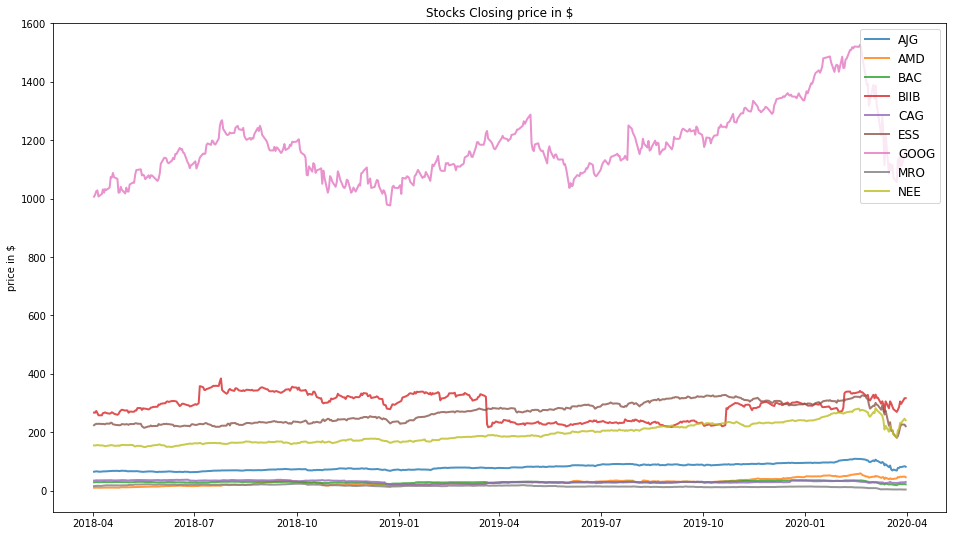

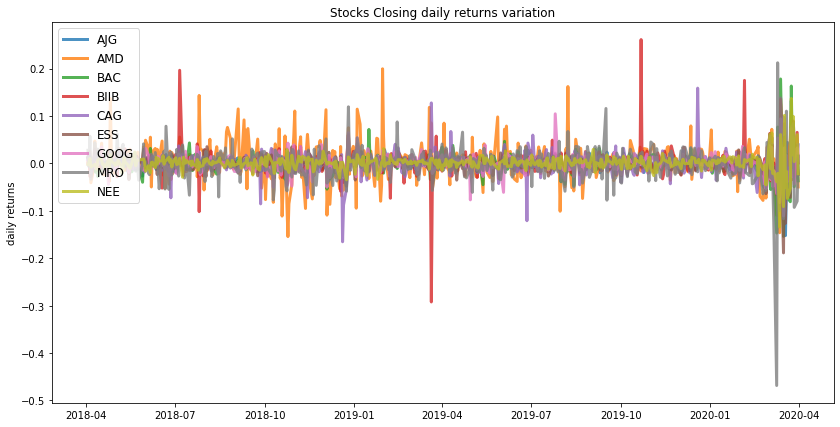

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.24
Annualised Volatility: 0.52


            AJG    AMD  BAC  BIIB  CAG  ESS  GOOG  MRO    NEE
allocation  0.0  50.22  0.0   0.0  0.0  0.0   0.0  0.0  49.78
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.24
Annualised Volatility: 0.3


              AJG  AMD  BAC  BIIB   CAG    ESS   GOOG  MRO    NEE
allocation  10.72  0.0  0.0  7.27  18.4  19.92  21.34  0.0  22.35


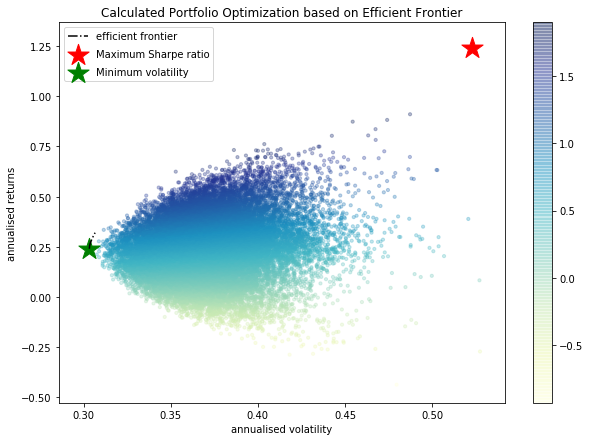

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AJG : annuaised return 0.31 , annualised volatility: 0.38
AMD : annuaised return 1.96 , annualised volatility: 0.88
BAC : annuaised return -0.14 , annualised volatility: 0.52
BIIB : annuaised return 0.39 , annualised volatility: 0.65
CAG : annuaised return -0.0 , annualised volatility: 0.53
ESS : annuaised return 0.07 , annualised volatility: 0.4
GOOG : annuaised return 0.24 , annualised volatility: 0.43
MRO : annuaised return -1.12 , annualised volatility: 0.84
NEE : annuaised return 0.52 , annualised volatility: 0.38
--------------------------------------------------------------------------------


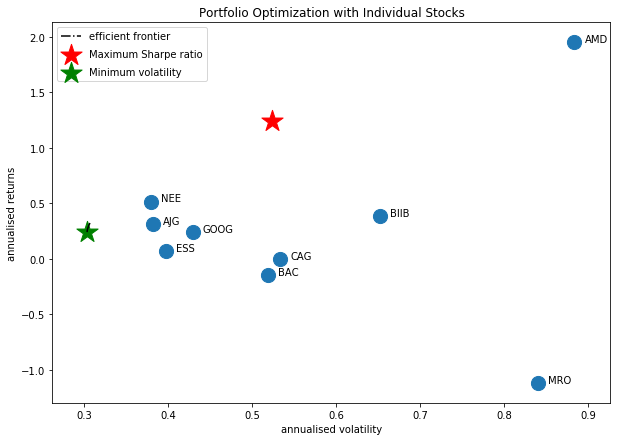

In [28]:
returns_sharpe_company_list = []
start_date = "2018-04-01"
end_date = "2020-04-01"
risk_free_rate = 0.0095
#generate the stocks pairs which are uncorrelated and having covariance less than mean covariance 
stocks_pair = get_portfolio_pairs(portfolio_list)
#print(stocks_pair)
for stock_list in stocks_pair:
    print("perform efficient_frontier_stock_portfolio Pairs of the companies we got {}".format(stock_list))
    pos_sharpe, Annualised_Return, Annualised_Volatility, allocation_weights = efficient_frontier_stock_portfolio(stock_list, len(stock_list), risk_free_rate, start_date, end_date)
    returns_sharpe_company_list.append([pos_sharpe, Annualised_Return, Annualised_Volatility, stock_list, allocation_weights])

In [29]:
returns_sharpe_company_list

[[2.264668478852697,
  1.43,
  0.63,
  ['EQIX', 'ESS', 'AMD', 'CAG', 'BAC'],
  array([[62.5,  0. ,  0. , 37.5,  0. ]])],
 [2.264754372314534,
  1.42,
  0.62,
  ['EQIX', 'ESS', 'AJG', 'BIIB', 'AMD', 'CAG', 'MRO', 'BAC'],
  array([[ 0.  , 62.12,  0.  ,  0.93,  0.  , 36.96,  0.  ,  0.  ]])],
 [2.2647545334833312,
  1.42,
  0.62,
  ['EQIX', 'ESS', 'BIIB', 'AMD', 'MRO', 'HP'],
  array([[62.14,  0.85, 37.01,  0.  ,  0.  ,  0.  ]])],
 [1.3607438115624821, 0.55, 0.4, ['EQIX', 'ADBE'], array([[27.2, 72.8]])],
 [2.2010533662213274,
  1.96,
  0.88,
  ['AMZN', 'ESS', 'AMD', 'CAG', 'BAC'],
  array([[100.,   0.,   0.,   0.,   0.]])],
 [2.206327968555518,
  1.82,
  0.82,
  ['AMZN', 'ESS', 'AJG', 'BIIB', 'AMD', 'CAG', 'MRO', 'BAC'],
  array([[ 0.  , 91.18,  0.  ,  0.  ,  8.82,  0.  ,  0.  ,  0.  ]])],
 [0.9801888420259175, 0.46, 0.46, ['AMZN', 'AOS'], array([[100.,   0.]])],
 [0.9801888420259175, 0.46, 0.46, ['BA', 'AMZN'], array([[100.,   0.]])],
 [2.206327969274539,
  1.82,
  0.82,
  ['GOOGL', 'BKNG

In [30]:
shortlisted_portfolio_df = pd.DataFrame(returns_sharpe_company_list)

In [31]:
shortlisted_portfolio_df.columns = ["Sharpe Ratio", "Portfolio Annualised Return", "Portfolio Annualised_Volatility", "Stock Portfolio", "Stocks Weight Allocation"]

In [32]:
shortlisted_portfolio_df

,Sharpe Ratio,Portfolio Annualised Return,Portfolio Annualised_Volatility,Stock Portfolio,Stocks Weight Allocation
0,2.264668,1.43,0.63,"[EQIX, ESS, AMD, CAG, BAC]","[[62.5, 0.0, 0.0, 37.5, 0.0]]"
1,2.264754,1.42,0.62,"[EQIX, ESS, AJG, BIIB, AMD, CAG, MRO, BAC]","[[0.0, 62.12, 0.0, 0.93, 0.0, 36.96, 0.0, 0.0]]"
2,2.264755,1.42,0.62,"[EQIX, ESS, BIIB, AMD, MRO, HP]","[[62.14, 0.85, 37.01, 0.0, 0.0, 0.0]]"
3,1.360744,0.55,0.40,"[EQIX, ADBE]","[[27.2, 72.8]]"
4,2.201053,1.96,0.88,"[AMZN, ESS, AMD, CAG, BAC]","[[100.0, 0.0, 0.0, 0.0, 0.0]]"
5,2.206328,1.82,0.82,"[AMZN, ESS, AJG, BIIB, AMD, CAG, MRO, BAC]","[[0.0, 91.18, 0.0, 0.0, 8.82, 0.0, 0.0, 0.0]]"
6,0.980189,0.46,0.46,"[AMZN, AOS]","[[100.0, 0.0]]"
7,0.980189,0.46,0.46,"[BA, AMZN]","[[100.0, 0.0]]"
8,2.206328,1.82,0.82,"[GOOGL, BKNG, AJG, BIIB, AMD, CAG, MRO, BAC]","[[0.0, 91.18, 0.0, 8.82, 0.0, 0.0, 0.0, 0.0]]"
9,2.349874,1.24,0.52,"[GOOGL, NEE, ESS, AJG, BIIB, AMD, CAG, MRO, BA...","[[0.0, 50.22, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0...."


In [33]:
# creating a blank series 
Portfolio_Tag = pd.Series([]) 

for row in range(len(shortlisted_portfolio_df)):
    if (shortlisted_portfolio_df["Sharpe Ratio"][row] >= 3):
        Portfolio_Tag[row] = "Excellent"
    elif (shortlisted_portfolio_df["Sharpe Ratio"][row] >= 2 and (shortlisted_portfolio_df["Sharpe Ratio"][row] < 3)):
        Portfolio_Tag[row] = "Very Good"
    elif ((shortlisted_portfolio_df["Sharpe Ratio"][row] >= 1)  and (shortlisted_portfolio_df["Sharpe Ratio"][row] < 2)):
        Portfolio_Tag[row] = "Good"
    else:
        Portfolio_Tag[row] = "Bad"
        
# inserting new column with values of list made above         
shortlisted_portfolio_df.insert(5, "Portfolio Tag", Portfolio_Tag) 

/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:2: DeprecationWarning:

The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.



In [34]:
shortlisted_portfolio_df

,Sharpe Ratio,Portfolio Annualised Return,Portfolio Annualised_Volatility,Stock Portfolio,Stocks Weight Allocation,Portfolio Tag
0,2.264668,1.43,0.63,"[EQIX, ESS, AMD, CAG, BAC]","[[62.5, 0.0, 0.0, 37.5, 0.0]]",Very Good
1,2.264754,1.42,0.62,"[EQIX, ESS, AJG, BIIB, AMD, CAG, MRO, BAC]","[[0.0, 62.12, 0.0, 0.93, 0.0, 36.96, 0.0, 0.0]]",Very Good
2,2.264755,1.42,0.62,"[EQIX, ESS, BIIB, AMD, MRO, HP]","[[62.14, 0.85, 37.01, 0.0, 0.0, 0.0]]",Very Good
3,1.360744,0.55,0.40,"[EQIX, ADBE]","[[27.2, 72.8]]",Good
4,2.201053,1.96,0.88,"[AMZN, ESS, AMD, CAG, BAC]","[[100.0, 0.0, 0.0, 0.0, 0.0]]",Very Good
5,2.206328,1.82,0.82,"[AMZN, ESS, AJG, BIIB, AMD, CAG, MRO, BAC]","[[0.0, 91.18, 0.0, 0.0, 8.82, 0.0, 0.0, 0.0]]",Very Good
6,0.980189,0.46,0.46,"[AMZN, AOS]","[[100.0, 0.0]]",Bad
7,0.980189,0.46,0.46,"[BA, AMZN]","[[100.0, 0.0]]",Bad
8,2.206328,1.82,0.82,"[GOOGL, BKNG, AJG, BIIB, AMD, CAG, MRO, BAC]","[[0.0, 91.18, 0.0, 8.82, 0.0, 0.0, 0.0, 0.0]]",Very Good
9,2.349874,1.24,0.52,"[GOOGL, NEE, ESS, AJG, BIIB, AMD, CAG, MRO, BA...","[[0.0, 50.22, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....",Very Good


In [35]:
shortlisted_portfolio = shortlisted_portfolio_df[(shortlisted_portfolio_df["Portfolio Tag"] == "Excellent") | (shortlisted_portfolio_df["Portfolio Tag"] == "Very Good") |
                                                    (shortlisted_portfolio_df["Portfolio Tag"] == "Good")]

In [36]:
shortlisted_portfolio = shortlisted_portfolio.sort_values(by="Sharpe Ratio", ascending=False)

In [37]:
shortlisted_portfolio

,Sharpe Ratio,Portfolio Annualised Return,Portfolio Annualised_Volatility,Stock Portfolio,Stocks Weight Allocation,Portfolio Tag
25,2.384659,1.09,0.45,"[NEE, ESS, AJG, BIIB, AMD, CAG, MRO, BAC, APC]","[[0.0, 41.42, 15.69, 0.0, 0.0, 0.0, 0.0, 0.0, ...",Very Good
44,2.349874,1.24,0.52,"[GOOG, NEE, ESS, AJG, BIIB, AMD, CAG, MRO, BAC]","[[0.0, 50.22, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 49...",Very Good
9,2.349874,1.24,0.52,"[GOOGL, NEE, ESS, AJG, BIIB, AMD, CAG, MRO, BA...","[[0.0, 50.22, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....",Very Good
26,2.349874,1.24,0.52,"[NEE, ESS, AJG, BIIB, AMD, CAG, MRO, BAC, CPB]","[[0.0, 50.21, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 49...",Very Good
24,2.349874,1.24,0.52,"[NEE, ESS, AJG, BIIB, AMD, CAG, MRO, BAC, EXC]","[[0.0, 50.21, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 49...",Very Good
10,2.349874,1.24,0.52,"[GOOGL, BKNG, NEE, ESS, AJG, BIIB, AMD, CAG, M...","[[0.0, 50.21, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....",Very Good
22,2.349874,1.24,0.52,"[NEE, ESS, AJG, BIIB, AMD, CAG, MRO, BAC]","[[0.0, 50.23, 0.0, 0.0, 0.0, 0.0, 0.0, 49.77]]",Very Good
43,2.349874,1.24,0.52,"[NEE, ESS, AJG, BIIB, AMD, CAG, MRO, BAC, CMCSA]","[[0.0, 50.25, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 49...",Very Good
33,2.349874,1.24,0.52,"[GOOGL, BKNG, NEE, ESS, AJG, BIIB, AMD, CAG, M...","[[0.0, 50.19, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....",Very Good
32,2.349874,1.24,0.52,"[BKNG, NEE, ESS, AJG, BIIB, AMD, CAG, MRO, BAC...","[[0.0, 50.19, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....",Very Good


## Top 5 portfolios generated for the shortlisted companies for overall 2 yr period

In [38]:
pd.set_option('display.max_colwidth', -1)
shortlisted_portfolio[:5]

/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: FutureWarning:

Passing a negative integer is deprecated in version 1.0 and will not be supported in future version. Instead, use None to not limit the column width.



,Sharpe Ratio,Portfolio Annualised Return,Portfolio Annualised_Volatility,Stock Portfolio,Stocks Weight Allocation,Portfolio Tag
25,2.384659,1.09,0.45,"[NEE, ESS, AJG, BIIB, AMD, CAG, MRO, BAC, APC]","[[0.0, 41.42, 15.69, 0.0, 0.0, 0.0, 0.0, 0.0, 42.89]]",Very Good
44,2.349874,1.24,0.52,"[GOOG, NEE, ESS, AJG, BIIB, AMD, CAG, MRO, BAC]","[[0.0, 50.22, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 49.78]]",Very Good
9,2.349874,1.24,0.52,"[GOOGL, NEE, ESS, AJG, BIIB, AMD, CAG, MRO, BAC, CMCSA]","[[0.0, 50.22, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 49.78]]",Very Good
26,2.349874,1.24,0.52,"[NEE, ESS, AJG, BIIB, AMD, CAG, MRO, BAC, CPB]","[[0.0, 50.21, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 49.79]]",Very Good
24,2.349874,1.24,0.52,"[NEE, ESS, AJG, BIIB, AMD, CAG, MRO, BAC, EXC]","[[0.0, 50.21, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 49.79]]",Very Good


## Min - Max reduction technique to identify the portfolio's Goodness

In [39]:
new_df = new_df.drop(["Unnamed: 0"], axis=1)
new_df_group = new_df.groupby("symbol").count().reset_index()

In [40]:
portfolio_list=new_df["symbol"]

portfolio_count = portfolio_list.value_counts()

min_occurences = min(portfolio_count)

max_occurences = max(portfolio_count)

middle = (min_occurences + max_occurences)/2

#print all the companies whose no of occurences have been higher than the (min+max)/2 no. of times.
stock_portfolio_df = new_df_group[new_df_group["start_date"] > middle]

#make the list of the companies in this portfolio.
stock_portfolio_list = list(stock_portfolio_df["symbol"])

print("Reduced portfolio list for the period of 2 years:")
print(stock_portfolio_list)

Reduced portfolio list for the period of 2 years:
['AMZN', 'BKNG']


perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AMZN', 'BKNG']


/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



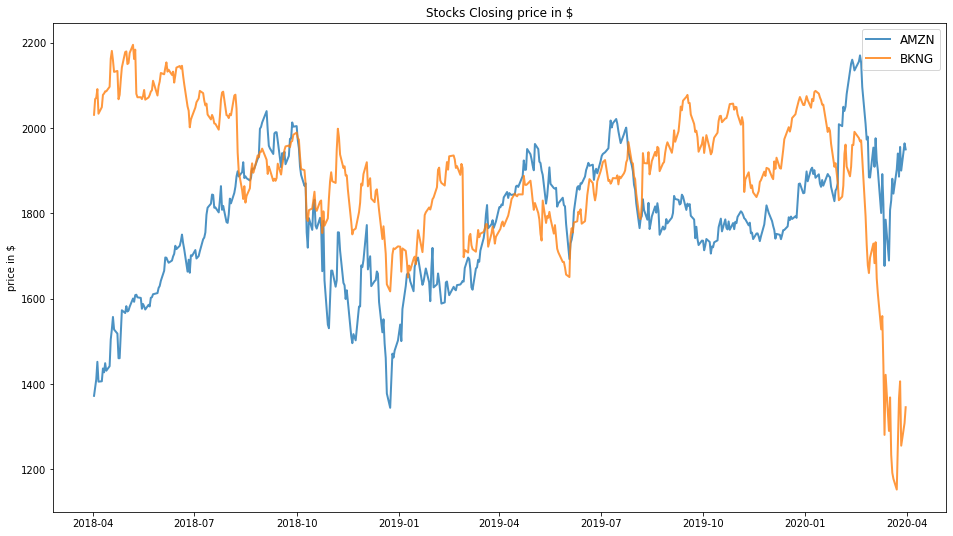

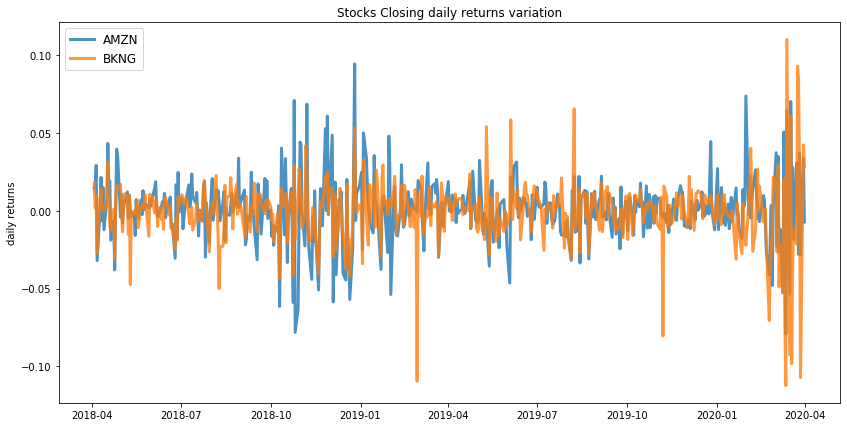

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.46
Annualised Volatility: 0.46


             AMZN  BKNG
allocation  100.0  0.0 
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.09
Annualised Volatility: 0.4


             AMZN   BKNG
allocation  52.43  47.57


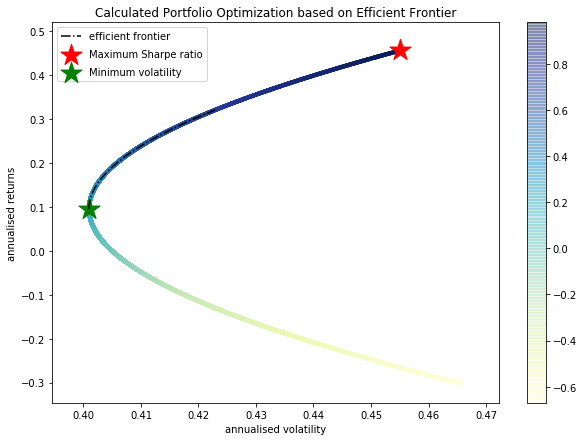

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMZN : annuaised return 0.46 , annualised volatility: 0.45
BKNG : annuaised return -0.3 , annualised volatility: 0.47
--------------------------------------------------------------------------------


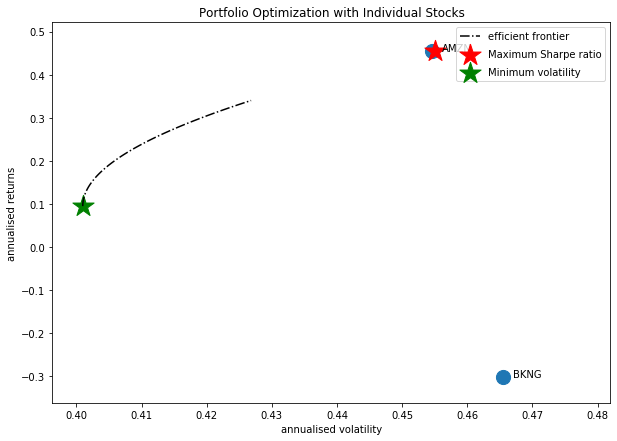

In [41]:
returns_sharpe_company_list = []
start_date = "2018-04-01"
end_date = "2020-04-01"
risk_free_rate = 0.0095
print("perform efficient_frontier_stock_portfolio Pairs of the companies we got {}".format(stock_portfolio_list))
pos_sharpe, Annualised_Return, Annualised_Volatility, allocation_weights = efficient_frontier_stock_portfolio(stock_portfolio_list, len(stock_portfolio_list), risk_free_rate, start_date, end_date)
returns_sharpe_company_list.append([pos_sharpe, Annualised_Return, Annualised_Volatility, stock_portfolio_list, allocation_weights])

In [42]:
shortlisted_portfolio_df = pd.DataFrame(returns_sharpe_company_list)

In [43]:
shortlisted_portfolio_df

,0,1,2,3,4
0,0.980189,0.46,0.46,"[AMZN, BKNG]","[[100.0, 0.0]]"


In [44]:
shortlisted_portfolio_df.columns = ["Sharpe Ratio", "Portfolio Annualised Return", "Portfolio Annualised_Volatility", "Stock Portfolio", "Stocks Weight Allocation"]

In [45]:
# creating a blank series 
Portfolio_Tag = pd.Series([]) 

for row in range(len(shortlisted_portfolio_df)):
    if (shortlisted_portfolio_df["Sharpe Ratio"][row] >= 3):
        Portfolio_Tag[row] = "Excellent"
    elif (shortlisted_portfolio_df["Sharpe Ratio"][row] >= 2 and (shortlisted_portfolio_df["Sharpe Ratio"][row] < 3)):
        Portfolio_Tag[row] = "Very Good"
    elif ((shortlisted_portfolio_df["Sharpe Ratio"][row] >= 1)  and (shortlisted_portfolio_df["Sharpe Ratio"][row] < 2)):
        Portfolio_Tag[row] = "Good"
    else:
        Portfolio_Tag[row] = "Bad"
        
# inserting new column with values of list made above         
shortlisted_portfolio_df.insert(5, "Portfolio Tag", Portfolio_Tag) 

/Users/amoghkallihal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:2: DeprecationWarning:

The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.



In [46]:
shortlisted_portfolio_df

,Sharpe Ratio,Portfolio Annualised Return,Portfolio Annualised_Volatility,Stock Portfolio,Stocks Weight Allocation,Portfolio Tag
0,0.980189,0.46,0.46,"[AMZN, BKNG]","[[100.0, 0.0]]",Bad
